<a href="https://colab.research.google.com/github/delg5279/SEIS_763_Final_Project/blob/main/DIA_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

SEIS 763: Machine Learning

Semester Project - DIA Classification


This project includes application of Logistic Regression and regularization to predict a given drug's susceptiblity to producing drug-induced autoimmune disorders in partients based on its molecular properties.

First, import necessary packages to execute a Logistic Regression and analyze the output.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.genmod.generalized_linear_model import GLM
from statsmodels.genmod import families
from sklearn import preprocessing
from sklearn.metrics import mean_squared_error, r2_score, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay, classification_report
from sklearn.metrics import roc_curve, roc_auc_score, auc
from sklearn.linear_model import LogisticRegressionCV, LogisticRegression
from sklearn.feature_selection import VarianceThreshold
from sklearn.svm import SVC, OneClassSVM
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import recall_score, f1_score
from sklearn.metrics import accuracy_score, precision_score, make_scorer
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import TunedThresholdClassifierCV
from sklearn.inspection import permutation_importance
from sklearn.metrics import precision_recall_curve
from sklearn.cluster import HDBSCAN
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import KBinsDiscretizer
from typing import Callable
import copy
import itertools
from typing import Type
import plotly.graph_objects as go
from scipy.stats import sem
from google.colab import drive

try:
  import rdkit
  from rdkit import Chem
  from rdkit.Chem import AllChem
  from rdkit.Chem import MACCSkeys
  from rdkit.DataStructs import ConvertToNumpyArray
  print(f"rdkit is installed.")
except ImportError:
  print(f"rdkit is not installed.")
  !pip install rdkit
  from rdkit import Chem
  from rdkit.Chem import AllChem
  from rdkit.Chem import MACCSkeys
  from rdkit.DataStructs import ConvertToNumpyArray

rdkit is not installed.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 710.8 kB/s eta 0:00:00


Mount Google Drive to access the data, which includes molecular properties of drugs to be analyzed for DIA susceptibility. Set helper flags to configure runtime options for the script. The following cell additionally includes helper functions used throughout the script.

In [10]:
drive.mount('/content/drive')

# Configure script options for runtime
kf = 3                      # Number of folds for initial regularization and
                            # cross-validation
sel_max_score = False       # Flag to indicate if maximum score alpha should be
                            # selected for the LogisticRegressionCV
num_predictors_to_sel = 250 # Number of predictors to keep for regularization if
                            # not using the maximum score alpha
use_smiles = True           # Flag to enable usage of SMILES strings to generate
                            # MACCS keys and utilize the bits as CAT vars for
                            # DIAD prediction
random_state = 0            # Random state for reproducibility
reeval_imp_features = True  # Switch to enable reevaluation of model performance
                            # after removal of unimportant, features hurtful to
                            # model performance as determined by permutation
                            # importance analysis with cross validation on the
                            # TRAINING data set (negative score features are
                            # removed)
use_only_maccs = False      # Optional switch to use ONLY MACCS fingerprint CAT
                            # variables to train the models
en_num_var_binning = True   # Optional switch to enable binning of numerical
                            # variables to train the models
n_bins = 3                  # Optional number of bins to use for binning of
                            # numerical variables

# Configure filepaths for training and testing datasets
train_file_path = '/content/drive/MyDrive/Colab Notebooks/SEIS 763/Semester Project/DIA_trainingset_RDKit_descriptors.csv'
test_file_path = '/content/drive/MyDrive/Colab Notebooks/SEIS 763/Semester Project/DIA_testset_RDKit_descriptors.csv'

################################################################################
# Helper Functions:

# lassoPlot(): Helper to mimic MATLAB lassoPlot() and plot Coefficients fit by
# LassoLarsCV, or cross-validated error of various levels of regularization
def lassoPlot (model_lasso: LogisticRegressionCV, PlotType: str, feature_labels: np.ndarray, predictors_to_sel: int=0) :
  if not isinstance(model_lasso, (LogisticRegressionCV)) or not isinstance(PlotType, (str)):
    raise TypeError("'model_lasso' be a LogisticRegressionCV object and 'PlotType' must be a string.")
  elif not isinstance(predictors_to_sel, (int)):
    raise TypeError("'predictors_to_sel' must be an integer.")
  elif not isinstance(feature_labels, (np.ndarray)):
    raise TypeError("'feature_labels' must be an np.ndarray.")

  # The 'Cs_' attribute contains the inverse alpha/lambda values used for
  # cross-validation
  alphas = 1/(model_lasso.Cs_)

  # The 'scores_' attribute contains the scores for each fold and inverse
  # alpha. The 'coefs_paths_' attribute contains the model theta (weights)
  # values along each alpha path for each fold
  scores = model_lasso.scores_[1]
  coefs_paths = model_lasso.coefs_paths_[1][:,:,:-1].mean(axis=0)

  # Calculate the mean Score across folds for each alpha in addition to
  # the standard error (for error bars - standard deviation divided by
  # the square root of the number of folds)
  mean_scores = np.mean(scores, axis=0)
  std_scores = np.std(scores, ddof=1, axis=0) / np.sqrt(model_lasso.coefs_paths_[1].shape[0])

  # Find the index of the maximum cross-validated alpha (where mean score is
  # maximized) and the index of minimum cross-validation error plus one
  # standard error.
  max_score_alpha_idx = np.argmax(mean_scores)
  threshold = mean_scores[max_score_alpha_idx] - std_scores[max_score_alpha_idx]
  alpha_1se_idx = np.where(mean_scores >= threshold)[0][np.argmax(alphas[np.where(mean_scores >= threshold)])]
  max_score_alpha = alphas[max_score_alpha_idx]
  alpha_1se = alphas[alpha_1se_idx]

  # Find index from lambda plot of smallest lambda (best Score) where only
  # 'predictors_to_sel' number of non-zero coefficents exist
  num_nonzero_values = np.count_nonzero(coefs_paths, axis=1)
  alpha_predictors_to_sel_idx = np.where(num_nonzero_values <= predictors_to_sel)[0][-1]
  alpha_predictors_to_sel = alphas[alpha_predictors_to_sel_idx]

  # Construct dict denoting the alphas for the maximum and 1 std. error scores
  # and where only 'predictors_to_sel' number of non-zero coefficients exist
  # to return from this function
  alpha_dict = {
    'max_score_alpha': max_score_alpha,
    'max_score_alpha_idx' : max_score_alpha_idx,
    'alpha_1se': alpha_1se,
    'alpha_1se_idx' : alpha_1se_idx,
    'alpha_predictors_to_sel' : alpha_predictors_to_sel,
    'alpha_predictors_to_sel_idx' : alpha_predictors_to_sel_idx
    }

  # Plot cross-validated mse of Lasso fit
  if (PlotType == 'CV') :
    # Plot the Cross-Validated MSE of Lasso Fit
    plt.figure()
    ax = plt.gca()
    plt.plot(alphas, mean_scores, marker='o', linestyle='-', label='Mean Score across folds')
    plt.errorbar(alphas, mean_scores, yerr=std_scores, fmt='none', ecolor='gray', capsize=3, label='CV-Score ± 1se')
    plt.fill_between(alphas, mean_scores - std_scores, mean_scores + std_scores, alpha=0.2)
    plt.axvline(x=max_score_alpha, color='r', linestyle='--', label=f'Maximum Score Alpha: {max_score_alpha:.4f}')
    plt.axvline(x=alpha_1se, color='b', linestyle='--', label=f'Max Alpha within Max Score - 1se: {alpha_1se:.4f}')
    plt.axhline(y=threshold, color='g', linestyle='--', label='Max Score - 1se')
    plt.xlabel('Lambda (Alpha - Regularization Parameter)')
    plt.ylabel('Score')
    plt.title(f'LogisticRegressionCV: {model_lasso.scoring} vs. Alpha (Lambda) with Cross-Validation')

    # Use log scale and flip the x-axis such that alpha/lambda decreases from
    # right to left like the MATLAB implementation
    plt.xscale('log')
    ax.set_xlim(ax.get_xlim()[::-1])
    plt.legend()
    plt.grid(True)
    plt.show()

  # Plot coefficient progression lasso lars (interactive and standard plots)
  elif (PlotType == 'Lambda') :
    plt.figure()
    ax = plt.gca()
    plt.plot(alphas, coefs_paths)
    plt.axvline(max_score_alpha, linestyle='--', color='g', label='LambdaMaxScore')
    plt.axvline(alpha_1se, linestyle='--', color='b', label='Lambda1SE')
    plt.ylabel('Regression Coefficients')
    plt.legend()
    plt.xlabel('lambda (alpha)')
    plt.title('Regression Coefficients Progression for Lasso')
    plt.xscale('log') # Alphas are often better viewed on a log scale
    ax.set_xlim(ax.get_xlim()[::-1])
    plt.grid(True)
    plt.show()
    print('\n')

    # plot interactive lasso lars, plotly library
    fig = go.Figure()
    for i in range((model_lasso.n_features_in_)):
      fig.add_trace(go.Scatter(x=alphas, y=coefs_paths[:, i],
        name=feature_labels[i], mode='lines'))
    fig.update_layout(xaxis_title="lambda (alpha)", yaxis_title="Regression Coefficients",
      title="Regression Coefficients Progression for Lasso")

    # Find index from lambda plot of smallest lambda (best Score) where only
    # 'predictors_to_sel' number of non-zero coefficents exist
    num_nonzero_values = np.count_nonzero(coefs_paths, axis=1)
    col = np.where(num_nonzero_values <= predictors_to_sel)[0][-1]
    fig.add_vline(x=alphas[col], line_width=2, line_dash="dash", showlegend=True,
      line_color="red",name='Lambda where only ' + str(predictors_to_sel)
      + ' coefficients are non-zero')
    fig.add_vline(x=max_score_alpha, line_width=2, line_dash="dash", showlegend=True,
      line_color="blue",name='LambdaMaxScore')

    # Use log scale and flip the x-axis such that alpha/lambda decreases from
    # right to left like the MATLAB implementation
    fig.update_xaxes(type='log')
    fig.update_xaxes(autorange='reversed')
    fig.show()
  else :
    print('Unrecognized Plot Type!')
  print('\n')
  return alpha_dict

# predict_threshold(): Helper to calculated predicted probability for a given
# set of data points using logistic regression coefficients and an intercept.
# A custom probability threshold can be passed in as an argument
def predict_threshold (
  X         : np.ndarray,
  model     : (
                LogisticRegression
                or LogisticRegressionCV
                or SVC
                or RandomForestClassifier
                ),
  threshold : float=0.5
  ) :
  if not isinstance(X, (np.ndarray)):
    raise TypeError("'X' must be an np.ndarray and 'PlotType' must be an np.array.")
  elif not isinstance(model, LogisticRegression) and not isinstance(model, (LogisticRegressionCV)) and not isinstance(model, (SVC)) and not isinstance(model, (RandomForestClassifier)) :
    raise TypeError("'model' must be a LogisticRegressionCV or SVC object.")
  elif not isinstance(threshold, (float)):
    raise TypeError("'intercept' must be a float and 'threshold' must be a float.")

  # Call the mode's predict_proba() method and make prediction based on the
  # desired probability threshold
  if model.classes_[1] == 1 :
    scores = model.predict_proba(X)[:,1]
  else :
    scores = model.predict_proba(X)[:,0]

  # Return binary predictions based on probability and the given threshold
  return np.where(scores >= threshold, 1, 0)

# score_logit_model(): Helper to calculate the score of a logistic regression model
# using actuals and predictions to compute the confusion matrix, and then plot
# the confusion matrix and derive an accuracy score from the False Positives,
# False Negatives, True Negatives, and True Positives
def score_logit_model (Y_actual : np.ndarray, Y_pred : np.ndarray) :
  if not isinstance(Y_actual, (np.ndarray)) or not isinstance(Y_pred, (np.ndarray)) :
    raise TypeError("'Y_actual' must be an np.ndarray and 'Y_pred' must be an np.array.")

  # Compute the confusion matrix and display the results
  conf_matrix = confusion_matrix(Y_actual, Y_pred)
  disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
  disp.plot()
  plt.show()

  # Compute an accuracy score
  true_positives = conf_matrix[0][0]
  false_positives = conf_matrix[0][1]
  true_negatives = conf_matrix[1][1]
  false_negatives = conf_matrix[1][0]
  accuracy_score = (true_positives + true_negatives) / (true_positives + true_negatives + false_positives + false_negatives)
  print('Model Accuracy Score:', accuracy_score)
  print('\n')

# plot_roc_pr_binary(): Helper to plot ROC for binary classes in a given binary
# classification model in addition to Precision-Recall Curves
def plot_roc_pr_binary (
  model        : (
                  LogisticRegression
                  or LogisticRegressionCV
                  or SVC
                  or RandomForestClassifier
                  or GradientBoostingClassifier
                  or BaggingClassifier
                  or TunedThresholdClassifierCV
                  or VotingClassifier
                  ),
  X            : np.ndarray,
  Y            : np.ndarray,
  en_plot      : bool=True,
  en_printouts : bool=True
  ) :
  if (
    not isinstance(model, LogisticRegression)
    and not isinstance(model, (LogisticRegressionCV))
    and not isinstance(model, (SVC))
    and not isinstance(model, (RandomForestClassifier))
    and not isinstance(model, (GradientBoostingClassifier))
    and not isinstance(model, (BaggingClassifier))
    and not isinstance(model, (TunedThresholdClassifierCV))
    and not isinstance(model, (VotingClassifier))
    ) :
    raise TypeError("Invalid model type.")
  elif not isinstance(X, (np.ndarray)) or not isinstance(Y, (np.ndarray)) :
    raise TypeError("'X' must be an np.ndarray and 'Y' must be an np.array.")
  elif not isinstance(en_plot, (bool)) :
    raise TypeError("'en_plot' must be a boolean.")

  # Predict probabilities - extract probability scores for the positive class
  if model.classes_[1] == 1 :
    scores = model.predict_proba(X)[:,1]
  else :
    scores = model.predict_proba(X)[:,0]

  # Extract true positive and false positive rates for BOTH classes
  fpr = dict()
  tpr = dict()
  th = dict()
  fpr[0], tpr[0], th[0] = roc_curve(Y, 1 - scores, pos_label = 0)
  fpr[1], tpr[1], th[1] = roc_curve(Y, scores, pos_label = 1)

  # Plot the results
  if (en_plot) :
    fig, axs = plt.subplots(nrows=1, ncols=2)
    for i in model.classes_:
      axs[0].plot(fpr[i], tpr[i], label = f"Class {i}")
    axs[0].plot(fpr[1],th[1],label='Probability Threshold')
    axs[0].plot([0, 1], [0, 1], 'k--', label='No Skill')
    axs[0].set_ylabel('True Positive Rate')
    axs[0].legend()
    axs[0].set_xlabel('False Positive Rate')
    axs[0].set_title('Validation Data (ROC)')
    axs[0].grid(True)
    #plt.show()

  # Extract precision, recall, and probability thresholds to achieve them
  precision, recall, thresholds = precision_recall_curve(Y, scores)

  # Plot the results
  if (en_plot) :
    no_skill = len(Y[Y==1]) / len(Y)
    axs[1].plot(recall, precision, label='Positive Class')
    axs[1].plot(recall[:-1], thresholds, label='Probability Threshold')
    axs[1].plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
    axs[1].set_ylabel('Precision')
    axs[1].legend()
    axs[1].set_xlabel('Recall')
    axs[1].set_title('Validation Data (Precision-Recall Curve)')
    axs[1].grid(True)
    fig.tight_layout()
    plt.show()

  # Display the AUC for EACH class - compute two different ways to verify
  # agreement visually in the printouts
  roc_auc = dict()
  roc_auc[0] = auc(fpr[0], tpr[0])
  roc_auc[1] = auc(fpr[1], tpr[1])
  if en_printouts :
    print('ROC AUC for Class 0 (computed with auc()):', roc_auc[0])
    print('ROC AUC for Class 1 (computed with auc()):', roc_auc[1])
  roc_auc[0] = roc_auc_score(Y, 1-model.predict_proba(X)[:,0])
  roc_auc[1] = roc_auc_score(Y, model.predict_proba(X)[:,1])
  if en_printouts :
    print('ROC AUC for Class 0 (computed with roc_auc_score()):', roc_auc[0])
    print('ROC AUC for Class 1 (computed with roc_auc_score()):', roc_auc[1])

  # Display the PR AUC
  prc_auc = dict()
  prc_auc = auc(recall, precision)
  if en_printouts :
    print('Precision-Recall AUC for Class 1 (computed with auc()):', prc_auc)
    print('\n')

  # Return ROC AUC scores
  return roc_auc, prc_auc

# tune_proba_thresh(): Helper to leverage sklearn TunedThresholdClassifierCV to
# search for a non-default probability threshold which maximizes a given string
# score type (f1, recall, etc.).
def tune_proba_thresh (
  model      : (
                LogisticRegression
                or LogisticRegressionCV
                or SVC
                or RandomForestClassifier
                or GradientBoostingClassifier
                or BaggingClassifier
                or VotingClassifier
                ),
  X_train     : np.ndarray,
  Y_train     : np.ndarray,
  folds       : int,
  scorer      : str
  ) :
  if (
      not isinstance(model, LogisticRegression)
      and not isinstance(model, (LogisticRegressionCV))
      and not isinstance(model, (SVC))
      and not isinstance(model, (RandomForestClassifier))
      and not isinstance(model, (GradientBoostingClassifier))
      and not isinstance(model, (BaggingClassifier))
      and not isinstance(model, (VotingClassifier))
      ) :
      raise TypeError("Invalid model type.")
  elif (
      not isinstance(X_train, (np.ndarray))
      or not isinstance(Y_train, (np.ndarray))
      ) :
      raise TypeError("'X' must be an np.ndarray and 'Y' must be an np.array.")
  elif (
      not isinstance(scorer, (str))
      ) :
      raise TypeError("'scorer' must be a string.")
  elif (
      not isinstance(folds, (int))
      ) :
      raise TypeError("'folds' must be an integer.")

  # Display the classification report BEFORE probability threshold tuning
  y_pred = model.predict(X_train)
  print("Classification report for data pre-tuning (model fit to entire training set):\n",
    classification_report(Y_train, y_pred))

  # Leverage the TunedThresholdClassifierCV object to find the best probability
  # threshold to maximize the given score against the provided TRAINING data
  print('Tuning probability threshold for the model...')
  tuned_model = TunedThresholdClassifierCV(
                  model,
                  scoring=scorer,
                  cv=folds,
                  refit=True,
                  store_cv_results=True,
                  random_state=random_state
                  )
  tuned_model.fit(X_train, Y_train)
  print('Best probability threshold (from cross-validation on training set):',
    tuned_model.best_threshold_)

  # Display the classification report AFTER probability threshold tuning
  y_pred = tuned_model.predict(X_train)
  print("Classification report for data post-tuning (model fit to entire training set):\n",
    classification_report(Y_train, y_pred))

  # Plot the scoring metric versus probability threshold to visualize the
  # performance of the model across different probability thresholds
  plt.figure()
  ax = plt.gca()
  plt.plot(
    tuned_model.cv_results_["thresholds"],
    tuned_model.cv_results_["scores"]
    )
  plt.plot(
    tuned_model.best_threshold_,
    tuned_model.best_score_,
    "o",
    markersize=10,
    label='Optimal cut-off point for ' + scorer + ' scoring metric'
    )
  plt.ylabel('Objective Score (' + scorer + ')')
  plt.legend()
  plt.xlabel('Decision Threshold (probability)')
  plt.title('Objective score (' + scorer + ') as a function of probability (Cross-Validated on Train Set)')
  plt.grid(True)
  ax.figure.tight_layout()
  plt.show()
  print('\n')

  return tuned_model

# pr_auc_score(): Helper to compute Precision-Revall auc and pass to sklearn
# make_scorer() to construct a custom scoring object
def pr_auc_score (y, y_pred) :
    precision, recall, thresholds = precision_recall_curve(y, y_pred)
    return auc(recall, precision)

# tp_score_bin(): Helper to compute the true positive count and pass to sklearn
# make_scorer() to construct a custom scoring object to later report back
# for performance of a parameter combination for a given fold from GridSearchCV.
# This function assumes binary classification
def tp_score_bin (y, y_pred) :
  return confusion_matrix(y, y_pred)[1][1]

# tn_score_bin(): Helper to compute the true negative count and pass to sklearn
# make_scorer() to construct a custom scoring object to later report back
# for performance of a parameter combination for a given fold from GridSearchCV.
# This function assumes binary classification
def tn_score_bin (y, y_pred) :
  return confusion_matrix(y, y_pred)[0][0]

# fp_score_bin(): Helper to compute the false positive count and pass to sklearn
# make_scorer() to construct a custom scoring object to later report back
# for performance of a parameter combination for a given fold from GridSearchCV.
# This function assumes binary classification
def fp_score_bin (y, y_pred) :
  return confusion_matrix(y, y_pred)[0][1]

# fn_score_bin(): Helper to compute the false positive count and pass to sklearn
# make_scorer() to construct a custom scoring object to later report back
# for performance of a parameter combination for a given fold from GridSearchCV.
# This function assumes binary classification
def fn_score_bin (y, y_pred) :
  return confusion_matrix(y, y_pred)[1][0]

# search_best_auc(): Helper to search through a parameter grid associated with
# a given classifier type and sweep through all possible combinations in the
# parameter grid. For each combination of parameters, a model is trained and fit
# to the provided TRAINING data using sklearn's GridSearchCV to perform a cross-
# validation. The model's AUC score for either ROC, OR the Precision-Recall
# Curve is evaluated to select a "best" set of parameters across folds in the
# cross-validation. Performance metrics for each fold are reported once the
# cross-validation process has completed This method will also leverage
# TunedThresholdClassifierCV to search for a non-default probability threshold
# for prediction which maximizes a given string score type (f1, recall, etc.).
# Finally, the method returns a model instance corresponding to the parameter
# grid combination associated with the best AUC score and which has been tuned
# with a non-default probability threshold.
def search_best_auc (
  clf_type   : (
                Type[LogisticRegression]
                or Type[LogisticRegressionCV]
                or Type[SVC]
                or Type[RandomForestClassifier]
                or Type[GradientBoostingClassifier]
                or Type[BaggingClassifier]
                ),
  X_train    : np.ndarray,
  Y_train    : np.ndarray,
  folds      : int,
  auc_scorer : str,
  scorer     : str,
  param_grid : dict,
  debug      : bool=False
  ) :
  if (
    not (clf_type is LogisticRegression)
    and not (clf_type is LogisticRegressionCV)
    and not (clf_type is SVC)
    and not (clf_type is RandomForestClassifier)
    and not (clf_type is GradientBoostingClassifier)
    and not (clf_type is BaggingClassifier)
    ) :
    raise ValueError("Invalid model type")
    print(type(clf_type))
  elif (
    not isinstance(X_train, (np.ndarray))
    or not isinstance(Y_train, (np.ndarray))
    ) :
    raise TypeError("'X' must be an np.ndarray and 'Y' must be an np.array.")
  elif (
    not isinstance(param_grid, dict)
    ) :
    raise TypeError("'param_grid' must be a dictionary.")
  elif (
    not isinstance(debug, (bool))
    ) :
    raise TypeError("'debug' must be a boolean.")
  elif (
    not isinstance(scorer, (str))
    ) :
    raise TypeError("'scorer' must be a string.")
  elif (
    not isinstance(auc_scorer, (str))
    and not (auc_scorer == 'roc_auc' or auc_scorer == 'prc_auc')
    ) :
    raise ValueError("'auc_scorer' must be a string of value 'roc_auc' or 'prc_auc'.")
  elif (
    not isinstance(folds, (int))
    ) :
    raise TypeError("'folds' must be an integer.")

  # Search for a model which will maximize AUC for the given/selected curve type
  # (ROC or Precision-Recall) using sklearn's GridSearchCV; then create and fit
  # a model of the desired type with the best parameters on the entire training
  # set.
  param_grid_values = param_grid.values()
  param_grid_keys = param_grid.keys()
  print('Executing search for best ' + auc_scorer + ' score for classifier of type: ',
    clf_type.__name__)
  print('Parameter Grid:', param_grid)

  # Create a custom scorer object to score Precision-Recall AUC in addition to
  # ROC AUC
  scorer_obj = dict()
  scorer_obj['prc_auc'] = make_scorer(pr_auc_score, response_method='predict_proba')
  scorer_obj['roc_auc'] = make_scorer(roc_auc_score)
  scorer_obj['recall_c0'] = make_scorer(recall_score, pos_label=0)
  scorer_obj['recall_c1'] = make_scorer(recall_score, pos_label=1)
  scorer_obj['precision_c0'] = make_scorer(precision_score, pos_label=0)
  scorer_obj['precision_c1'] = make_scorer(precision_score, pos_label=1)
  scorer_obj['fscore_c1'] = make_scorer(f1_score, pos_label=1)
  scorer_obj['fscore_c0'] = make_scorer(f1_score, pos_label=0)
  scorer_obj['accuracy'] = make_scorer(accuracy_score)
  scorer_obj['tp'] = make_scorer(tp_score_bin)
  scorer_obj['tn'] = make_scorer(tn_score_bin)
  scorer_obj['fp'] = make_scorer(fp_score_bin)
  scorer_obj['fn'] = make_scorer(fn_score_bin)
  clf = GridSearchCV(
              estimator=clf_type(),
              cv=folds,
              param_grid=param_grid,
              scoring=scorer_obj,
              refit=auc_scorer,
              n_jobs=4
              )
  clf.fit(X_train, Y_train)
  best_clf = clf_type()
  best_clf.set_params(**clf.best_params_)
  best_clf.fit(X_train, Y_train)
  print('Best ' + auc_scorer + ' score:', clf.best_score_)
  print('Best parameters:', clf.best_params_)

  # Report back the classification report, ROC AUC, and PR AUC for each fold in
  # the cross validation
  best_score_idx = clf.cv_results_['rank_test_' + auc_scorer].argmin()
  for i in range(folds) :
    TN = clf.cv_results_['split%s_test_tn' %i][best_score_idx]
    FN = clf.cv_results_['split%s_test_fn' %i][best_score_idx]
    TP = clf.cv_results_['split%s_test_tp' %i][best_score_idx]
    FP = clf.cv_results_['split%s_test_fp' %i][best_score_idx]
    recall_c0 = clf.cv_results_['split%s_test_recall_c0' %i][best_score_idx]
    recall_c1 = clf.cv_results_['split%s_test_recall_c1' %i][best_score_idx]
    precision_c0 = clf.cv_results_['split%s_test_precision_c0' %i][best_score_idx]
    precision_c1 = clf.cv_results_['split%s_test_precision_c1' %i][best_score_idx]
    fscore_c0 = clf.cv_results_['split%s_test_fscore_c0' %i][best_score_idx]
    fscore_c1 = clf.cv_results_['split%s_test_fscore_c1' %i][best_score_idx]
    accuracy = clf.cv_results_['split%s_test_accuracy' %i][best_score_idx]
    positive_support = TP + FN
    negative_support = TN + FP
    print(f'Performance Metrics Summary for fold {i}:' )
    print('Classification Report: ')
    fold_report = pd.DataFrame({
        'Precision' : [precision_c0, precision_c1],
        'Recall' : [recall_c0, recall_c1],
        'F1 Score' : [fscore_c0, fscore_c1],
        'Accuracy' : [accuracy, accuracy],
        'Support' : [negative_support, positive_support]
      }, index=['Class 0', 'Class 1'])
    print(fold_report, '\n')
    disp = ConfusionMatrixDisplay(confusion_matrix=np.array([[TN, FP],[FN, TP]]).astype(int))
    disp.plot()
    plt.title(f'Confusion Matrix for fold {i}')
    plt.show()
    key = 'split%s_test_roc_auc' %i
    print(f'ROC AUC for fold {i}: {clf.cv_results_[key][best_score_idx]}')
    key = 'split%s_test_prc_auc' %i
    print(f'Precision-Recall AUC for fold {i}: {clf.cv_results_[key][best_score_idx]}')
    print('\n')

  # Now leverage the TunedThresholdClassifierCV object to find the best
  # probability threshold to maximize the given score against the provided
  # data with a cross validation
  best_clf = tune_proba_thresh(
              model=best_clf,
              X_train=X_train,
              Y_train=Y_train,
              folds=folds,
              scorer=scorer
              )

  # Return the classifier instance
  return best_clf

# report_feature_importance_cv(): Helper function to report feature importance
# for a fitted model with sklearn's permutation_importance(); the method reports
# feature importance for a given training dataset with cross-validation. The
# method returns the mean permutation importance scores and standard deviations
# across folds from the cross validation. The intent of this method is for use
# in identifying features which are candidates for removal for training a model
# due to zero (or negative) permutation importance of features from a given
# training dataset from the training dataset with cross validation and holding
# out parts of the training dataset such that a test dataset does not influence
# the feature selection process.
def report_feature_importance_cv (
  model                : (
                          LogisticRegression
                          or SVC
                          or RandomForestClassifier
                          or GradientBoostingClassifier
                          or BaggingClassifier
                          or TunedThresholdClassifierCV
                          or VotingClassifier
                          ),
  X_train              : np.ndarray,
  Y_train              : np.ndarray,
  labels               : np.ndarray,
  scoring              : str='roc_auc'
  ):
  if (
      not isinstance(model, (LogisticRegression))
      and not isinstance(model, (SVC))
      and not isinstance(model, (RandomForestClassifier))
      and not isinstance(model, (GradientBoostingClassifier))
      and not isinstance(model, (BaggingClassifier))
      and not isinstance(model, (TunedThresholdClassifierCV))
      and not isinstance(model, (VotingClassifier))
      ) :
      raise TypeError("Invalid model type.")
  elif (
      not isinstance(X_train, (np.ndarray))
      or not isinstance(Y_train, (np.ndarray))
      or not isinstance(labels, (np.ndarray))
      ) :
      raise TypeError("'X' must be an np.ndarray and 'Y' must be an np.array.")
  elif (
      not isinstance(scoring, (str))
      and not isinstance(scoring, (Callable))
      ) :
      raise TypeError("'scoring' must be a string.")

  # Create a copy of the estimator object so we don't affect the object that has
  # been passed in as a parameter
  model = copy.deepcopy(model)

  # If this is a tuned classifier, extract the fitted classifier from the
  # wrapper class
  if isinstance(model, (TunedThresholdClassifierCV)):
    model = model.estimator_

  # Instantiate a splitter for the permutation importance CV process
  ksplit = StratifiedKFold(n_splits=kf, shuffle=True, random_state=random_state)

  # Initialize empty arrays for aggregating results for each fold
  all_importances_mean = []
  all_importances_std = []
  all_importances = []

  # Loop through each fold and gather the results
  for train_index, val_index in ksplit.split(X_train, Y_train):
      X_train_split, X_val = X_train[train_index], X_train[val_index]
      Y_train_split, Y_val = Y_train[train_index], Y_train[val_index]

      model.fit(X_train_split, Y_train_split)

      result = permutation_importance(
              model,
              X_val,
              Y_val,
              n_repeats=10,
              scoring=scoring,
              random_state=random_state,
              n_jobs=4
              )
      all_importances_mean.append(result.importances_mean)
      all_importances_std.append(result.importances_std)
      all_importances.append(result.importances)

  # Aggregate results
  mean_importances_mean_cv = np.mean(all_importances_mean, axis=0)
  mean_std_cv = np.mean(all_importances_std, axis=0)
  mean_importances_cv = np.mean(all_importances, axis=0)

  return mean_importances_mean_cv, mean_std_cv, mean_importances_cv

# report_feature_importance(): Helper function to report feature importance for
# a fitted model with sklearn's permutation_importance(); the method reports
# feature importance for both testing (held out) and training datasets. For
# models which support impurity-based importances, these feature importance
# values are evaluated and visualized additionally for comparison. For Logistic
# regression cross-validation models, features importance is based
# evaluated with permutation_importance() in addition to analyzing features
# and coefficient magnitudes which survive the regularization process.
def report_feature_importance (
  model                : (
                          LogisticRegression
                          or SVC
                          or RandomForestClassifier
                          or GradientBoostingClassifier
                          or BaggingClassifier
                          or TunedThresholdClassifierCV
                          or VotingClassifier
                          ),
  X_train              : np.ndarray,
  Y_train              : np.ndarray,
  X_test               : np.ndarray,
  Y_test               : np.ndarray,
  labels               : np.ndarray,
  scoring              : str='roc_auc',
  num_features_to_rank : int=10
  ):
  if (
      not isinstance(model, (LogisticRegression))
      and not isinstance(model, (SVC))
      and not isinstance(model, (RandomForestClassifier))
      and not isinstance(model, (GradientBoostingClassifier))
      and not isinstance(model, (BaggingClassifier))
      and not isinstance(model, (TunedThresholdClassifierCV))
      and not isinstance(model, (VotingClassifier))
      ) :
      raise TypeError("Invalid model type.")
  elif (
      not isinstance(X_test, (np.ndarray))
      or not isinstance(Y_test, (np.ndarray))
      or not isinstance(X_train, (np.ndarray))
      or not isinstance(Y_train, (np.ndarray))
      or not isinstance(labels, (np.ndarray))
      ) :
      raise TypeError("'X' must be an np.ndarray and 'Y' must be an np.array.")
  elif (
      not isinstance(num_features_to_rank, (int))
      ) :
      raise TypeError("'num_features_to_rank' must be an integer.")
  elif (
      not isinstance(scoring, (str))
      ) :
      raise TypeError("'scoring' must be a string.")

  # Make custom scoring object for pr auc if this is selected
  if scoring == 'prc_auc' :
    imp_scorer = make_scorer(pr_auc_score, response_method='predict_proba')
  else :
    imp_scorer = scoring

  # If this is a tuned classifier, extract the fitted classifier from the
  # wrapper class
  if isinstance(model, (TunedThresholdClassifierCV)):
    model = model.estimator_

  # Report feature importance; first, check if this is a RandomForestClassifier,
  # GradientBoostingClassifier, or LogisticRegressionCV
  if (
    isinstance(model, (RandomForestClassifier))
    or isinstance(model, (GradientBoostingClassifier))
    ) :
    # Analyze the fitted model to determine which features have been scored as
    # most important for DIA prediction
    top_features = model.feature_importances_.argsort()[-num_features_to_rank:][::-1]
    top_features = {
      'Feature Labels' : labels[top_features],
      'Feature Importance' : model.feature_importances_[top_features],
      'Feature Indices' : top_features
      }
    top_features = pd.DataFrame(top_features)
    print('Top important features from ' + type(model).__name__ + ' Model:')
    print(top_features, '\n')

    # Plot the top most important features for visualization
    fig, ax = plt.subplots()
    ax.barh(
      y=top_features['Feature Labels'],
      width=top_features['Feature Importance']
      )
    ax.set_title(type(model).__name__ + " Feature Importances (Impurity-Based)")
    ax.figure.tight_layout()
    plt.show()
    print('\n')
  elif (
    isinstance(model, (LogisticRegression))
    ) :
    # The 'Cs' attribute contains the inverse alpha/lambda values used for
    # cross-validation
    alpha = 1/(model.C)

    # Analyze the fitted model to determine which features have scored as most
    # important for DIA prediction; for the LogisticRegression model, this will
    # consist of the top model coefficients/features with largest magnitude. It
    # is assummed these coefficients have been derived following selection from
    # a cross validation and that predictors have been appropriately scaled so
    # as to not mask feature importance due to improper scaling.
    top_features = model.coef_[0].argsort()[-num_features_to_rank:][::-1]
    print('Model coefficients at Lambda (alpha)', alpha, 'in the',
      type(model).__name__, 'model:')
    print('Intercept: %.2f' %model.intercept_[0])
    print('Coefficients: ', model.coef_[0])
    print('\n')
    top_features = {
      'Feature Labels' : labels[top_features],
      'Feature Coefficients' : model.coef_[0][top_features],
      'Feature Indices' : top_features
      }
    top_features = pd.DataFrame(top_features)
    print('Top important features from Logistic Regression Model:')
    print(top_features, '\n')

    # Plot the top most important features for visualization
    fig, ax = plt.subplots()
    ax.barh(
      y=top_features['Feature Labels'],
      width=top_features['Feature Coefficients']
      )
    ax.set_title(type(model).__name__ + " Feature Importances (Coefficient Magnitude)")
    ax.figure.tight_layout()
    plt.show()
    print('\n')

  # Now, perform a permutation importance analysis on the TRAINING dataset with
  # cross validation to determine which features are most important by assessing
  # the training dataset alone
  train_importances_mean, train_std, train_importances = report_feature_importance_cv(
                                                          model=model,
                                                          X_train=X_train,
                                                          Y_train=Y_train,
                                                          labels=labels,
                                                          scoring=imp_scorer
                                                          )
  sorted_importances_idx = train_importances_mean.argsort()[-num_features_to_rank:][::-1]
  importances = pd.DataFrame(
      train_importances[sorted_importances_idx].T,
      columns=labels[sorted_importances_idx],
  )

  # Print out the top features
  top_features = train_importances_mean.argsort()[-num_features_to_rank:][::-1]
  top_features = {
    'Feature Labels' : labels[top_features],
    'Feature Importance' : train_importances_mean[top_features],
    'Feature Indices' : top_features
    }
  top_features = pd.DataFrame(top_features)
  print('Top important features from '
    + type(model).__name__
    +' Model in Training Set (permutation_importance):'
    )
  print(top_features, '\n')

  # Plot the results
  ax = importances.plot.box(vert=False, whis=20)
  ax.set_title(type(model).__name__ + " Permutation Importances (Training Set)")
  ax.axvline(x=0, color="k", linestyle="--")
  ax.set_xlabel("Decrease in \'" + scoring + "\' score")
  ax.figure.tight_layout()
  plt.show()
  print('\n')

  # Finally, create a permutation_importance() object to compute permutation
  # importance for the given model; first report for the TEST data
  result_test = permutation_importance(
            model,
            X_test,
            Y_test,
            n_repeats=10,
            scoring=imp_scorer,
            random_state=random_state,
            n_jobs=4
            )
  sorted_importances_idx = result_test.importances_mean.argsort()[-num_features_to_rank:][::-1]
  importances = pd.DataFrame(
      result_test.importances[sorted_importances_idx].T,
      columns=labels[sorted_importances_idx],
  )

  # Print out the top features
  top_features = result_test.importances_mean.argsort()[-num_features_to_rank:][::-1]
  top_features = {
    'Feature Labels' : labels[top_features],
    'Feature Importance' : result_test.importances_mean[top_features],
    'Feature Indices' : top_features
    }
  top_features = pd.DataFrame(top_features)
  print('Top important features from '
    + type(model).__name__
    + ' Model in Test Set (permutation_importance):'
    )
  print(top_features, '\n')

  # Plot the results
  ax = importances.plot.box(vert=False, whis=20)
  ax.set_title(type(model).__name__ + " Permutation Importances (Testing Set)")
  ax.axvline(x=0, color="k", linestyle="--")
  ax.set_xlabel("Decrease in \'" + scoring + "\' score")
  ax.figure.tight_layout()
  plt.show()
  print('\n')

  # Plot the results with a bar chart with Testing AND Training
  # for ease of visualizing the comparison of permutation importances for
  # testing and training.
  # First, define a number of features to plot for each plot generated
  window_size = num_features_to_rank
  sorted_importances_idx = result_test.importances_mean.argsort()[::-1]

  # Construct the importance score and standard deviation data frames
  importances = pd.DataFrame({
    'Training' : train_importances_mean[sorted_importances_idx],
    'Testing' : result_test.importances_mean[sorted_importances_idx]
  }, index=labels[sorted_importances_idx])
  errors = pd.DataFrame({
    'Training' : train_std[sorted_importances_idx],
    'Testing' : result_test.importances_std[sorted_importances_idx]
  }, index=labels[sorted_importances_idx])

  # Generate plot(s) in a loop - only plot 'window_size' number of features per
  # plot
  for i in range(0, len(importances['Training']), window_size):
    ax = importances.iloc[i:i + window_size].plot.barh(xerr=errors.iloc[i:i + window_size])
    ax.set_title(type(model).__name__ + " Permutation Importances (Testing & Training Sets)")
    ax.axvline(x=0, color="k", linestyle="--")
    ax.set_xlabel("Decrease in \'" + scoring + "\' score")
    ax.figure.tight_layout()
    plt.show()
    print('\n')

  return train_importances_mean, train_std, train_importances, result_test.importances_mean, result_test.importances_std, result_test.importances

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Feature preprocessing pipeline; take training and test data as input arguments and output the preprocessed data, exporting the data to a google spreadsheet which can be accessed later.

In [ ]:
# feature_preprocess(): Helper to implement feature preprocessing
# Input parameters:
#   X_train            : Training data features/predictors
#   X_test             : Test data features/predictors
#   Y_train            : Training target features
#   Y_test             : Test target features
#   labels             : String names of features/predictors
#   en_reg             : Flag to enable CV regularization with Logistic
#                        Regression to filter out 'useless' features. This will
#                        conduct a kf-fold cross-validation regularization and
#                        select a lambda value corresponding to the roc_auc
#                        score within 1 standard error of the maximum score
#   en_outlier_removal : Flag to enable outlier removal with OneClassSVM()
#   bin2cat            : Flag to enable conversion of binary variables to
#                        categorical vars
#   debug              : Flag to enable debug printouts
# Output parameters:
#   ZX_train           : Z-scored training features
#   ZX_test            : Z-scored test features
#   Y_train            : Preprocessed training target
#   Y_test             : Preprocessed testing target
#   labels             : String labels of Z-scored training/test features
def feature_preprocess (
  X_train            : np.ndarray,
  X_test             : np.ndarray,
  Y_train            : np.ndarray,
  Y_test             : np.ndarray,
  labels             : np.ndarray,
  en_reg             : bool=False,
  en_outlier_removal : bool=True,
  bin2cat            : bool=True,
  debug              : bool=False
  ) :
  if (
    not isinstance(X_train, (np.ndarray))
    or not isinstance(X_test, (np.ndarray))
    or not isinstance(Y_train, (np.ndarray))
    or not isinstance(Y_test, (np.ndarray))
    ) :
    raise TypeError("'X' must be an np.ndarray and 'Y' must be an np.array.")
  elif (
    not isinstance(en_reg, (bool))
    or not isinstance(en_outlier_removal, (bool))
    or not isinstance(bin2cat, (bool))
    or not isinstance(debug, (bool))
    ) :
    raise TypeError("'en_reg', 'bin2cat', and 'debug' must be a boolean.")

  # Report number of features before applying data preprocessing
  print('Preprocessing Data...')
  print('Number of features before data preprocessing: ', X_train.shape[1])

  # Step 1 - Clean the data and implement data preprocessing; convert the target
  # dependent variable (last column) to binary values of either 0s or 1s for
  # two-class classification.
  Y_train = np.where((Y_train.astype(float) == 0),0,1)
  Y_test  = np.where((Y_test.astype(float) == 0),0,1)

  # Separate binary data from continuous data - binary data will be treated as
  # CAT vars
  binary_vars_idx = []
  continous_vars_idx = []
  for col_index in range(X_train.shape[1]):
      # Select the column
      column_train = X_train[:, col_index]
      column_test  = X_test[:, col_index]

      # Check if all elements in the column are 0 or 1
      contains_only_zeros_and_ones = np.all(np.isin(column_train, [0, 1])) and np.all(np.isin(column_test, [0, 1]))
      contains_only_zeros = np.all(np.isin(column_train, 0)) and np.all(np.isin(column_test, 0))
      contains_only_ones = np.all(np.isin(column_train, 1)) and np.all(np.isin(column_test, 1))

      # Check if all elements are either 0 or 1
      if (contains_only_zeros_and_ones and not (contains_only_ones or contains_only_zeros)):
        binary_vars_idx.append(col_index)
      elif not (contains_only_ones or contains_only_zeros):
        continous_vars_idx.append(col_index)
  if debug :
    print('Binary Variable indices:', binary_vars_idx)
    print('Continuous Variable indices:', continous_vars_idx)

  # Step 1a - Separate numerical variables from the categorical variables for
  # standardization
  if bin2cat :
    num_vars_train = X_train.astype(float)[:,continous_vars_idx]
    cat_vars_train = X_train[:,binary_vars_idx]
    num_vars_test  = X_test.astype(float)[:,continous_vars_idx]
    cat_vars_test  = X_test[:,binary_vars_idx]
    num_var_labels = labels[continous_vars_idx]
    cat_var_labels = labels[binary_vars_idx]
  else :
    num_vars_train = X_train.astype(float)
    cat_vars_train = np.array([])
    num_vars_test  = X_test.astype(float)
    cat_vars_test  = np.array([])
    num_var_labels = labels
    cat_var_labels = np.array([])

  # Step 2a - standardize the numerical variables - remove features with zero
  # standard deviation (useless predictors/features)
  if (continous_vars_idx != []) :
    scaler = preprocessing.StandardScaler()
    num_vars_std_train = scaler.fit_transform(num_vars_train)
    num_vars_std_test  = scaler.transform(num_vars_test)
    if debug :
      print('Original Data Mean Values:')
      print(scaler.mean_,'\n')
      print('Original Data Std. Deviation Values:')
      print(np.sqrt(scaler.var_),'\n')

    # Remove zero-variance features
    sel = VarianceThreshold()
    num_vars_std_train = sel.fit_transform(num_vars_std_train)
    num_vars_std_test  = sel.transform(num_vars_std_test)
  else :
    num_vars_std_train = np.empty([Y_train.shape[0],0])
    num_vars_std_test  = np.empty([Y_test.shape[0],0])

  # Optionally implement continuous variable feature binning such that all vars
  # will be CAT
  if en_num_var_binning :
    # Initialize KBinsDiscretizer with one-hot encoding
    kbd = KBinsDiscretizer(n_bins=3, encode='onehot-dense', strategy='uniform')

    # Fit and transform the data
    num_vars_std_train = kbd.fit_transform(num_vars_std_train)
    num_vars_std_test = kbd.transform(num_vars_std_test)

    # Get the feature names
    num_var_labels = kbd.get_feature_names_out(input_features=num_var_labels)

    # Append the new transformed categorical variables to out CAT var list
    cat_vars_train = np.concatenate((num_vars_std_train, cat_vars_train), axis=1)
    cat_vars_test = np.concatenate((num_vars_std_test, cat_vars_test), axis=1)
    cat_var_labels = np.concatenate((num_var_labels, cat_var_labels), axis=0)
    continous_vars_idx = []
    num_vars_std_train = np.empty([Y_train.shape[0],0])
    num_vars_std_test  = np.empty([Y_test.shape[0],0])
    num_var_labels = np.array([])

  # Step 2b - create dummy variables (one-hot encoding of categorical variables)
  # and concatenate the new dummy vars with the numerical standarized vars
  enc = preprocessing.OneHotEncoder(drop='first', handle_unknown='ignore')
  if (cat_vars_train.size != 0) : # Check if there any are CAT vars
    enc.fit(cat_vars_train)
    cat_vars_enc_train = enc.transform(cat_vars_train).toarray()
  else :
    cat_vars_enc_train = np.array([])

  if (cat_vars_test.size != 0) : # Check if there any are CAT vars
    cat_vars_enc_test = enc.transform(cat_vars_test).toarray()
  else :
    cat_vars_enc_test = np.array([])

  # Concatenate training data array
  if (cat_vars_enc_train.size != 0) :
    ZX_train = np.concatenate((num_vars_std_train, cat_vars_enc_train), axis=1)
  else :
    ZX_train = num_vars_std_train

  # Concatenate test data array
  if (cat_vars_enc_test.size != 0) :
    ZX_test = np.concatenate((num_vars_std_test, cat_vars_enc_test), axis=1)
  else :
    ZX_test = num_vars_std_test

  # Concatenate feature label array
  if (cat_vars_enc_train.size != 0) :
    labels = np.concatenate((num_var_labels, cat_var_labels), axis=0)
  else :
    labels = num_var_labels

  # Implement optional regularization with kf-fold CV Logistic Regression to
  # filter out features or predictors whihc have little or no impact on roc_auc
  # performance of the Logistic Regression model
  if en_reg :
    lasso_model = LogisticRegressionCV(
                    Cs=200,
                    cv=kf,
                    penalty="l1",
                    max_iter=10000,
                    solver="saga",
                    scoring="roc_auc",
                    random_state=random_state,
                    n_jobs=4
                    )
    lasso_model.fit(ZX_train, Y_train)

    # Plot cross-validated weights of Lasso fit
    lassoPlot(lasso_model, PlotType='CV', feature_labels=labels, predictors_to_sel=0)

    # plot coefficient progression Lasso
    regularization_alphas = lassoPlot(lasso_model, PlotType='Lambda', feature_labels=labels, predictors_to_sel=num_predictors_to_sel)

    # Select 1 std. error lambda for regularization to filter out useless or
    # highly correlated features
    intercept_paths = lasso_model.coefs_paths_[1][:,:,-1].mean(axis=0)
    coefs_paths = lasso_model.coefs_paths_[1][:,:,:-1].mean(axis=0)
    alphas = 1/(lasso_model.Cs_)
    print('Lambda (alpha) where', num_predictors_to_sel, 'nonzero coefficients exist in the lasso fit:',
      alphas[regularization_alphas['alpha_predictors_to_sel_idx']])

    # Step 5 - Build the Logistic regression model (select the coefficients from the
    # Lasso Regression/Training - at this point the model has already been trained)
    print('Model coefficients at Lambda (alpha)', alphas[regularization_alphas['alpha_predictors_to_sel_idx']],
      '(max score):')
    print('Intercept: %.2f' %intercept_paths[regularization_alphas['alpha_predictors_to_sel_idx']])
    print('Coefficients: ', coefs_paths[regularization_alphas['alpha_predictors_to_sel_idx']])
    print('\n')

    # Remove features from the training data where the coefficients have been driven
    # to zero by the Logistic Regression for the highest scoring lambda value
    zero_coeff_idx = np.where(coefs_paths[regularization_alphas['alpha_predictors_to_sel_idx']] == 0)[0]
    zero_coeff_idx_num_vars = zero_coeff_idx[np.where(zero_coeff_idx < num_vars_std_train.shape[1])]
    zero_coeff_idx_cat_vars = zero_coeff_idx[np.where(zero_coeff_idx >= num_vars_std_train.shape[1])]-num_vars_std_train.shape[1]
    print('Removing useless features from regularization at column indices:', zero_coeff_idx)
    ZX_train = np.delete(ZX_train, zero_coeff_idx, axis=1)
    ZX_test = np.delete(ZX_test, zero_coeff_idx, axis=1)
    num_vars_train = np.delete(num_vars_train, zero_coeff_idx_num_vars, axis=1)
    num_vars_test = np.delete(num_vars_test, zero_coeff_idx_num_vars, axis=1)
    num_vars_std_train = np.delete(num_vars_std_train, zero_coeff_idx_num_vars, axis=1)
    num_vars_std_test = np.delete(num_vars_std_test, zero_coeff_idx_num_vars, axis=1)
    cat_vars_train = np.delete(cat_vars_train, zero_coeff_idx_cat_vars, axis=1)
    cat_vars_test = np.delete(cat_vars_test, zero_coeff_idx_cat_vars, axis=1)
    cat_vars_enc_train = np.delete(cat_vars_enc_train, zero_coeff_idx_cat_vars, axis=1)
    cat_vars_enc_test = np.delete(cat_vars_enc_test, zero_coeff_idx_cat_vars, axis=1)
    num_var_labels = np.delete(num_var_labels, zero_coeff_idx_num_vars, axis=0)
    cat_var_labels = np.delete(cat_var_labels, zero_coeff_idx_cat_vars, axis=0)

  # Step 3 (Optional) - Implement Optional Outlier Removal by training
  # OneClassSVM() classifiers for each class in the training data
  if en_outlier_removal :
    print('Outlier Removal Enabled...')
    # Create training and test feature and target test arrays for the One Class SVM
    # models; set the target values to 1 and -1 for each class to fit the convention
    # of values returned by sklearn's OneClassSVM() object
    ZX_train_c0 = ZX_train[Y_train == 0]
    num_vars_train_c0 = num_vars_train[Y_train == 0]
    cat_vars_enc_train_c0 = cat_vars_enc_train[Y_train == 0]
    c0_idx = np.where(Y_train == 0)[0]
    ZX_train_c1 = ZX_train[Y_train == 1]
    num_vars_train_c1 = num_vars_train[Y_train == 1]
    cat_vars_enc_train_c1 = cat_vars_enc_train[Y_train == 1]
    c1_idx = np.where(Y_train == 1)[0]
    Y_train_c0  = np.where(Y_train[Y_train == 0] == 0, 1, -1)
    Y_train_c1  = np.where(Y_train[Y_train == 1] == 1, 1, -1)

    # Create the classifier objects for each class and prepare a parameter Grid for
    # the GridSearchCV object to find the best parameters for recall for each class
    clf_c0 = OneClassSVM()
    clf_c1 = OneClassSVM()
    param_grid = {
      'kernel': ['rbf'],
      'gamma': ['auto', 'scale'] + list(np.logspace(-3, -1, 10)),
      'nu'    : np.logspace(-3, -2, 10)
      }

    # Create the GridSearchCV object
    scorer = make_scorer(recall_score, average='binary')
    grid_search_c0 = GridSearchCV(
                        estimator=clf_c0,
                        param_grid=param_grid,
                        cv=kf,
                        scoring=scorer,
                        n_jobs=4
                        )
    grid_search_c0.fit(ZX_train_c0, Y_train_c0)
    if debug :
      print(f"Best parameters for class 0: {grid_search_c0.best_params_}")
      print(f"Best cross-validation score for class 0: {grid_search_c0.best_score_:.4f}")

    # Step 5 - Build the SVM RBF One Class classifier
    # Use SciKit OneClassSVM() Object
    clf_c0 = OneClassSVM(
              kernel=grid_search_c0.best_params_['kernel'],
              gamma=grid_search_c0.best_params_['gamma'],
              nu=grid_search_c0.best_params_['nu']
              )
    clf_c0.fit(ZX_train_c0)
    print('Class 0 Confusion Matrix for OneClassSVM() outlier removal:')
    score_logit_model(Y_train_c0, clf_c0.predict(ZX_train_c0))
    c0_outlier_idx = np.where(clf_c0.predict(ZX_train_c0) == -1)
    print('Outlier indices for class 0 from OneClassSVM():', c0_outlier_idx)

    # Create the GridSearchCV object
    scorer = make_scorer(recall_score, average='binary')
    grid_search_c1 = GridSearchCV(
                        estimator=clf_c1,
                        param_grid=param_grid,
                        cv=kf,
                        scoring=scorer,
                        n_jobs=4
                        )
    grid_search_c1.fit(ZX_train_c1, Y_train_c1)
    if debug :
      print(f"Best parameters for class 1: {grid_search_c1.best_params_}")
      print(f"Best cross-validation score for class 1: {grid_search_c1.best_score_:.4f}")

    # Step 5 - Build the SVM RBF One Class classifier
    # Use SciKit OneClassSVM() Object
    clf_c1 = OneClassSVM(
              kernel=grid_search_c1.best_params_['kernel'],
              gamma=grid_search_c1.best_params_['gamma'],
              nu=grid_search_c1.best_params_['nu']
              )
    clf_c1.fit(ZX_train_c1)
    print('Class 1 Confusion Matrix for OneClassSVM() outlier removal:')
    score_logit_model(Y_train_c1, clf_c1.predict(ZX_train_c1))
    c1_outlier_idx = np.where(clf_c1.predict(ZX_train_c1) == -1)
    print('Outlier indices for class 1 from OneClassSVM():', c1_outlier_idx)

    # Remove the outier records from each respective class
    print('Removing outlier records...')
    num_vars_train_c0 = np.delete(num_vars_train_c0, c0_outlier_idx, axis=0)
    num_vars_train_c1 = np.delete(num_vars_train_c1, c1_outlier_idx, axis=0)
    if (cat_vars_enc_train.size != 0) :
      cat_vars_enc_train_c0 = np.delete(cat_vars_enc_train_c0, c0_outlier_idx, axis=0)
      cat_vars_enc_train_c1 = np.delete(cat_vars_enc_train_c1, c1_outlier_idx, axis=0)
    Y_train_c0 = np.delete(Y_train_c0, c0_outlier_idx, axis=0)
    Y_train_c1 = np.delete(Y_train_c1, c1_outlier_idx, axis=0)
    print('Removed Class 0 outlier record numbers: ', c0_idx[c0_outlier_idx])
    print('Removed Class 1 outlier record numbers: ', c1_idx[c1_outlier_idx])

    # Concatenate the numeric and categorical variables back together and the
    # training target array
    num_vars_train = np.concatenate((num_vars_train_c0, num_vars_train_c1), axis=0)
    if (cat_vars_enc_train.size != 0) :
      cat_vars_enc_train = np.concatenate((cat_vars_enc_train_c0, cat_vars_enc_train_c1), axis=0)
    Y_train = np.concatenate((np.where(Y_train_c0 == 1, 0, 1), np.where(Y_train_c1 == 1, 1, 0)), axis=0)

    # Step 4 - Re-standardize the numeric data
    if (num_vars_std_train.size != 0) :
      num_vars_std_train = scaler.fit_transform(num_vars_train)
      num_vars_std_test  = scaler.transform(num_vars_test)
      if debug :
        print('Outliers Removed Data Mean Values:')
        print(scaler.mean_,'\n')
        print('Outliers Removed Data Std. Deviation Values:')
        print(np.sqrt(scaler.var_),'\n')
    else :
      num_vars_std_train = np.empty([Y_train.shape[0],0])
      num_vars_std_test  = np.empty([Y_test.shape[0],0])

  # Concatenate training data array
  if (cat_vars_enc_train.size != 0) :
    ZX_train = np.concatenate((num_vars_std_train, cat_vars_enc_train), axis=1)
  else :
    ZX_train = num_vars_std_train

  # Concatenate test data array
  if (cat_vars_enc_test.size != 0) :
    ZX_test = np.concatenate((num_vars_std_test, cat_vars_enc_test), axis=1)
  else :
    ZX_test = num_vars_std_test

  # Concatenate feature label array
  if (cat_vars_enc_train.size != 0) :
    labels = np.concatenate((num_var_labels, cat_var_labels), axis=0)
  else :
    labels = num_var_labels

  # Report number of features after data preprocessing
  print('Number of features after data preprocessing: ', ZX_train.shape[1])
  return ZX_train, ZX_test, Y_train, Y_test, labels

Extract the training and test data and preprocess it.

Number of DIA positive records in training data:  118
Number of records in training data:  477
Number of DIA positive records in test data:  30
Number of records in test data:  120
Preprocessing Data...
Number of features before data preprocessing:  363
Outlier Removal Enabled...


/usr/local/lib/python3.12/dist-packages/sklearn/preprocessing/_encoders.py:246: UserWarning:

Found unknown categories in columns [448] during transform. These unknown categories will be encoded as all zeros



Class 0 Confusion Matrix for OneClassSVM() outlier removal:


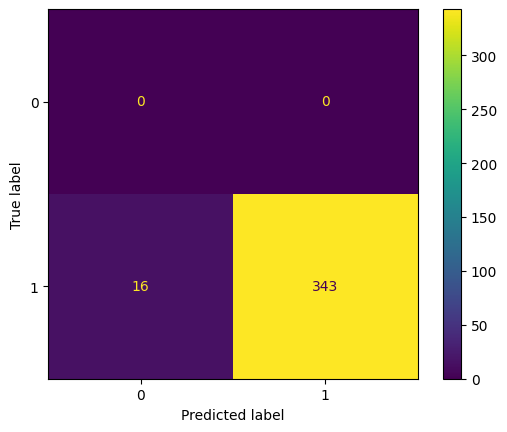

Model Accuracy Score: 0.9554317548746518


Outlier indices for class 0 from OneClassSVM(): (array([  3,  22,  85,  86, 107, 123, 155, 165, 181, 196, 256, 277, 282,
       301, 307, 352]),)
Class 1 Confusion Matrix for OneClassSVM() outlier removal:


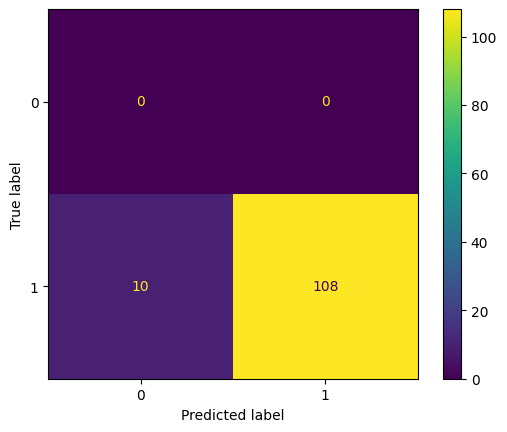

Model Accuracy Score: 0.9152542372881356


Outlier indices for class 1 from OneClassSVM(): (array([  4,   7,  13,  28,  42,  53,  67,  82,  90, 102]),)
Removing outlier records...
Removed Class 0 outlier record numbers:  [  5  27 113 115 143 160 200 212 234 255 340 369 375 399 407 465]
Removed Class 1 outlier record numbers:  [ 15  31  60 114 185 236 270 336 363 418]
Number of features after data preprocessing:  637
Number of DIA positive records in training data post processing:  108
Number of records in training data post processing:  451
Number of DIA positive records in test data:  30
Number of records in test data:  120


In [11]:
# Load the data
cell_data_training = pd.read_csv(train_file_path, header=None)
cell_data_test = pd.read_csv(test_file_path, header=None)

cell_data_training = cell_data_training.to_numpy()
print('Number of DIA positive records in training data: ', np.count_nonzero(cell_data_training[1:,0].astype(float)))
print('Number of records in training data: ', len(cell_data_training[1:,0].astype(float)))

cell_data_test = cell_data_test.to_numpy()
print('Number of DIA positive records in test data: ', np.count_nonzero(cell_data_test[1:,0].astype(float)))
print('Number of records in test data: ', len(cell_data_test[1:,0].astype(float)))

# Optionally extract the SMILES ID of each drug; if using it, we can attempt to
# convert the SMILES to a MACCS key and treat each bit as a categorical var
if use_smiles :
  # Generate MACCS fingerprints for training set
  smiles_list_train = cell_data_training[1:,1]
  fingerprints_train = []
  for index, smiles in enumerate(smiles_list_train):
    mol = Chem.MolFromSmiles(smiles)
    if mol:
        # Get the 167-bit MACCS key as a BitVector
        maccs_fp = MACCSkeys.GenMACCSKeys(mol)
        # Convert BitVector to a numpy array of integers (0s and 1s)
        fp_array = np.array(list(maccs_fp.ToBitString())).astype(int)
        fingerprints_train.append(fp_array)
    else:
        # Handle cases where RDKit cannot parse the SMILES
        print(f"Error processing SMILES: {smiles}")
        fingerprints_train.append(None)

  # Remove any None entries
  valid_fingerprints = np.array([fp for fp in fingerprints_train if fp is not None])

  # Generate MACCS fingerprints for test set
  smiles_list_test = cell_data_test[1:,1]
  fingerprints_test = []
  for index, smiles in enumerate(smiles_list_test):
    mol = Chem.MolFromSmiles(smiles)
    if mol:
        # Get the 167-bit MACCS key as a BitVector
        maccs_fp = MACCSkeys.GenMACCSKeys(mol)
        # Convert BitVector to a numpy array of integers (0s and 1s)
        fp_array = np.array(list(maccs_fp.ToBitString())).astype(int)
        fingerprints_test.append(fp_array)
    else:
        # Handle cases where RDKit cannot parse the SMILES
        print(f"Error processing SMILES: {smiles}")
        fingerprints_test.append(None)

  # Remove any None entries
  valid_fingerprints = np.array([fp for fp in fingerprints_test if fp is not None])

  # Generate labels for readability of coefficients
  maccs_bit_labels = []
  for i in range(len(fingerprints_train[0])) :
    maccs_bit_labels.append('MACCS_' + str(i))

# Form the training data arrays
X_train = cell_data_training[1:,2:].astype(float)
Y_train = cell_data_training[1:,0]
X_test = cell_data_test[1:,2:].astype(float)
Y_test = cell_data_test[1:,0]
labels = cell_data_training[0,2:]

# Preprocess the data - can choose to use only MACCS fingerprints
# generated from SMILES as an optional switch
if use_only_maccs :
  X_train = np.array(fingerprints_train)
  X_test = np.array(fingerprints_test)
  labels = np.array(maccs_bit_labels)
else :
  # Append SMILES/MACCS keys if enabled
  if use_smiles :
    X_train = np.concatenate((X_train, np.array(fingerprints_train)), axis=1)
    X_test = np.concatenate((X_test, np.array(fingerprints_test)), axis=1)
    labels = np.concatenate((labels, np.array(maccs_bit_labels)), axis=0)

# Preprocess the data
ZX_train, ZX_test, Y_train, Y_test, labels = feature_preprocess(
                                              X_train,
                                              X_test,
                                              Y_train,
                                              Y_test,
                                              labels,
                                              en_reg=False,
                                              en_outlier_removal=True,
                                              bin2cat=True,
                                              debug=False
                                              )

print('Number of DIA positive records in training data post processing: ', np.count_nonzero(Y_train.astype(float)))
print('Number of records in training data post processing: ', len(Y_train.astype(float)))

print('Number of DIA positive records in test data: ', np.count_nonzero(Y_test.astype(float)))
print('Number of records in test data: ', len(Y_test.astype(float)))

# Define empty dict for storing missclassification records for each classifier
# evaluated in the script for comparison after all models are trained and
# evaluated against the TRAINING set
misclassified_records = pd.DataFrame({
  'Class 0 Misclassification Count': [[], [], [], [], [], []],
  'Class 0 Misclassification Indices': [[], [], [], [], [], []],
  'Class 1 Misclassification Count' : [[], [], [], [], [], []],
  'Class 1 Misclassification Indices': [[], [], [], [], [], []]
}, index=['Logistic Regression', 'SVC (RBF)', 'RandomForest', 'GBM', 'Bagged Tree', 'Ensemble'])

# Define empty dicts to track the number of times each predictor appears in a
# given model's top 15 permutation importance features to report later
top_predictor_count_train = pd.DataFrame({
    'Top 15 Count': np.zeros(len(labels))
}, index=np.array(labels))

top_predictor_count_test = pd.DataFrame({
    'Top 15 Count': np.zeros(len(labels))
}, index=np.array(labels))

We begin by training a a Logistic Regression model using the LogisticRegressionCV object with 3 folds in the regression to find and select the desired regularization parameter, C, and then train a LogisticRegression() model using the entire training dataset. The following cell trains and evaluates this model against the training AND test datasets. The sklearn TunedClassifierCV() is used to tune the prediction probability threshold to obtain a best given arbitrary (F-score, precision, accuracy, etc.) score for the minority DIA-positive class records in the data.

Cross-Validation Lasso Plot for Training Data Set:


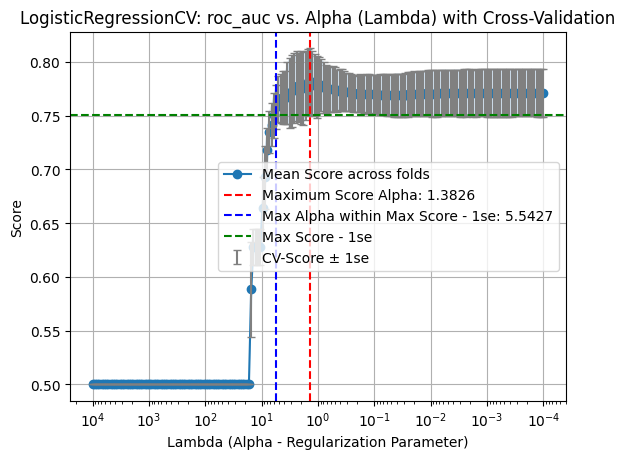



Coefficient Progression Lasso Plot(s) for Training Data Set:


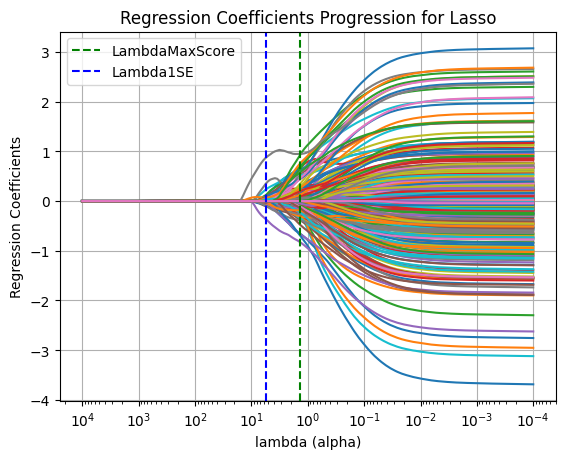



Lambda (alpha) within 1 standard error of max score in the lasso fit: 5.5426645206631076
Model coefficients at Lambda (alpha) 5.5426645206631076 
in the Lasso Regression):
Intercept: -2.04
Coefficients:  [ 0.09970268  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.         -0.04998923  0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.00687052  

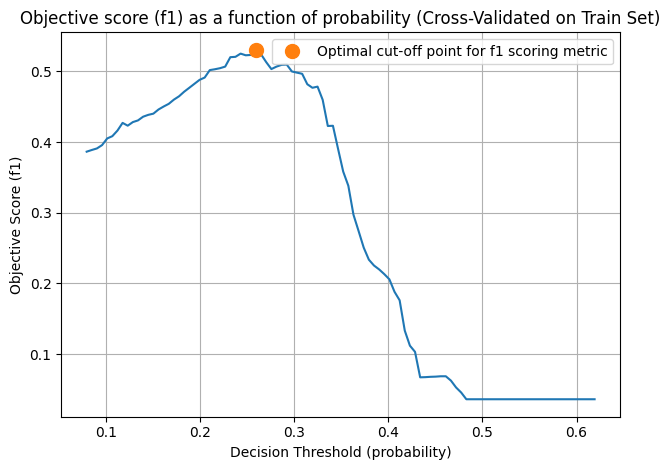



Evaluating model performance after fitting to entire training dataset:


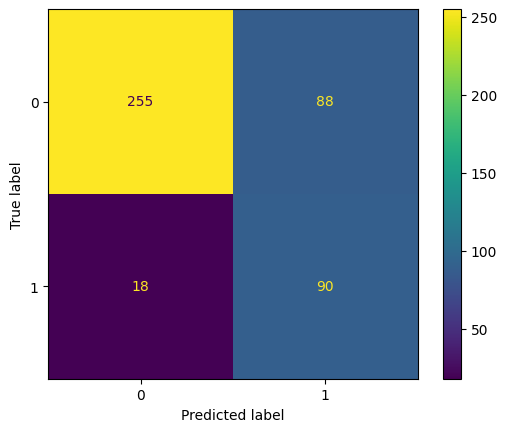

Model Accuracy Score: 0.7649667405764967


Classification report for training data:
               precision    recall  f1-score   support

           0       0.93      0.74      0.83       343
           1       0.51      0.83      0.63       108

    accuracy                           0.76       451
   macro avg       0.72      0.79      0.73       451
weighted avg       0.83      0.76      0.78       451

Precision-Recall and ROC Curves for the Training Set:


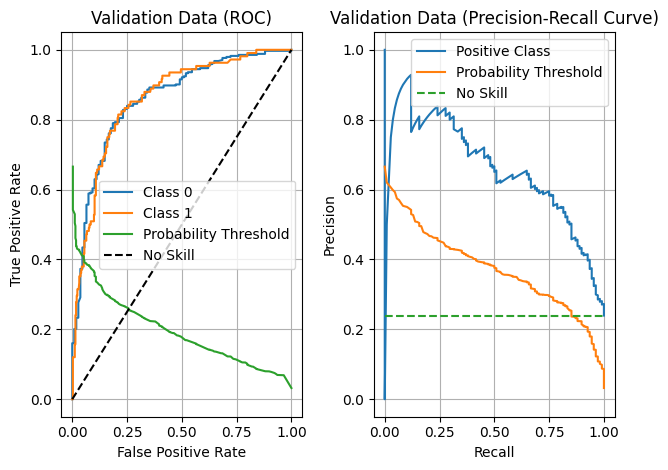

ROC AUC for Class 0 (computed with auc()): 0.8597613648634056
ROC AUC for Class 1 (computed with auc()): 0.8597613648634057
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8597613648634057
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8597613648634057
Precision-Recall AUC for Class 1 (computed with auc()): 0.6525904861790679


Evaluating model performance against the Testing Set:


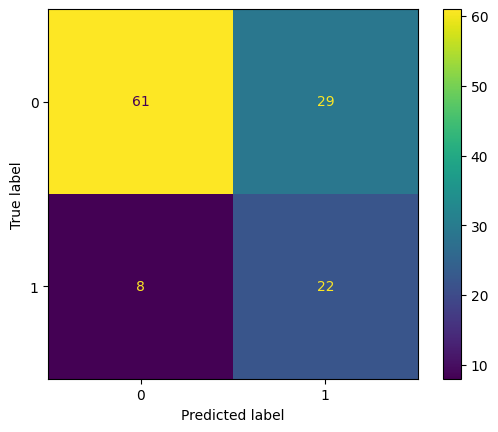

Model Accuracy Score: 0.6916666666666667


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.88      0.68      0.77        90
           1       0.43      0.73      0.54        30

    accuracy                           0.69       120
   macro avg       0.66      0.71      0.66       120
weighted avg       0.77      0.69      0.71       120

Precision-Recall and ROC Curves for the Testing Set:


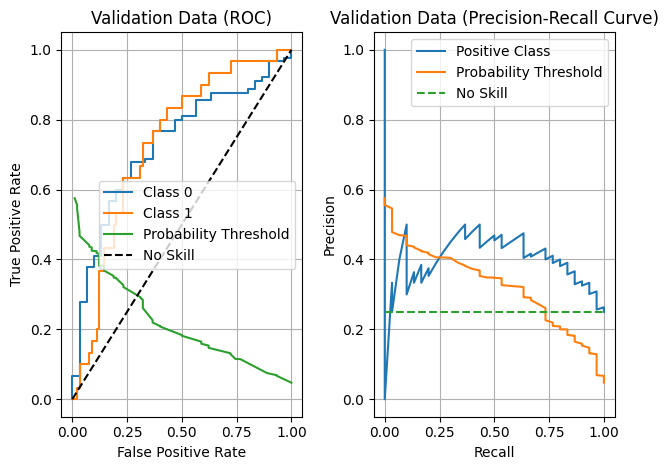

ROC AUC for Class 0 (computed with auc()): 0.7311111111111112
ROC AUC for Class 1 (computed with auc()): 0.7311111111111112
ROC AUC for Class 0 (computed with roc_auc_score()): 0.7311111111111112
ROC AUC for Class 1 (computed with roc_auc_score()): 0.7311111111111112
Precision-Recall AUC for Class 1 (computed with auc()): 0.3953269273390103


Evaluating predictor importance for testing and training data...
Model coefficients at Lambda (alpha) 5.5426645206631076 in the LogisticRegression model:
Intercept: -2.75
Coefficients:  [ 0.21764797  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          

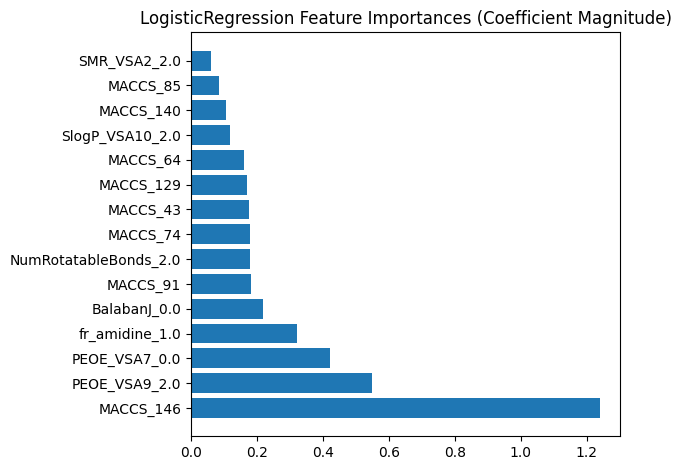



Top important features from LogisticRegression Model in Training Set (permutation_importance):
    Feature Labels  Feature Importance  Feature Indices
0        MACCS_146            0.060802              627
1        MACCS_143            0.045500              624
2    PEOE_VSA7_0.0            0.021576              219
3        MACCS_129            0.012223              610
4         MACCS_86            0.010282              567
5    PEOE_VSA9_2.0            0.008632              227
6        MACCS_148            0.007201              629
7         MACCS_83            0.006745              564
8   fr_amidine_1.0            0.005853              382
9    RingCount_0.0            0.005828              228
10    SMR_VSA3_0.0            0.004788              240
11        MACCS_85            0.002874              566
12    BalabanJ_0.0            0.002412                0
13        MACCS_64            0.002160              545
14   PEOE_VSA5_2.0            0.001893              215 



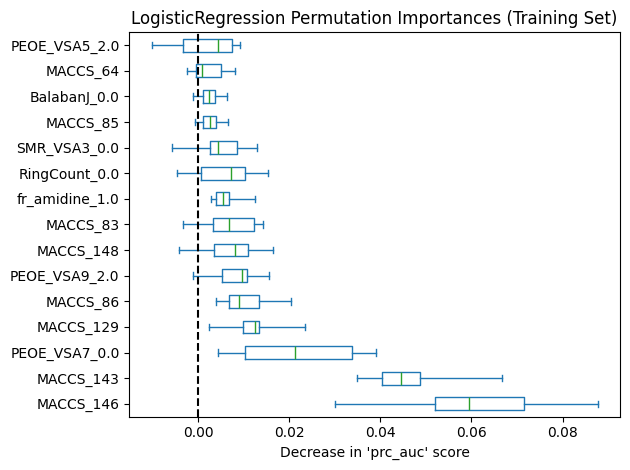



Top important features from LogisticRegression Model in Test Set (permutation_importance):
                  Feature Labels  Feature Importance  Feature Indices
0                      MACCS_143            0.057194              624
1                       MACCS_91            0.010849              572
2                       MACCS_74            0.010397              555
3                       MACCS_85            0.009593              566
4                      MACCS_109            0.007763              590
5                       MACCS_86            0.006351              567
6                   SMR_VSA3_0.0            0.005181              240
7                       MACCS_43            0.004174              525
8                      MACCS_146            0.003838              627
9                       MACCS_82            0.002464              563
10               SlogP_VSA10_2.0            0.002181              263
11                     MACCS_129            0.001737              6

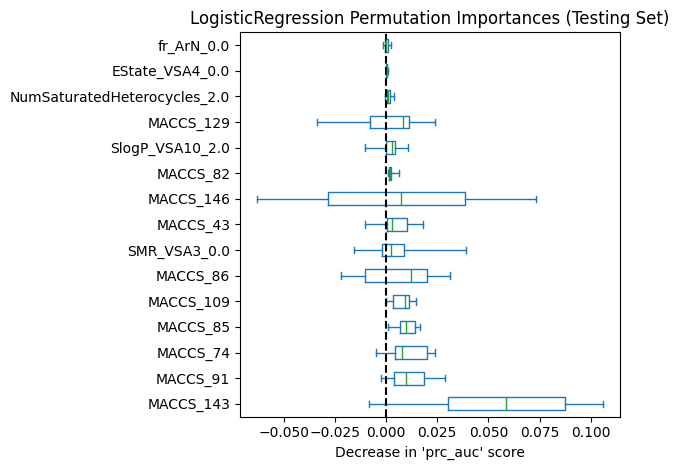

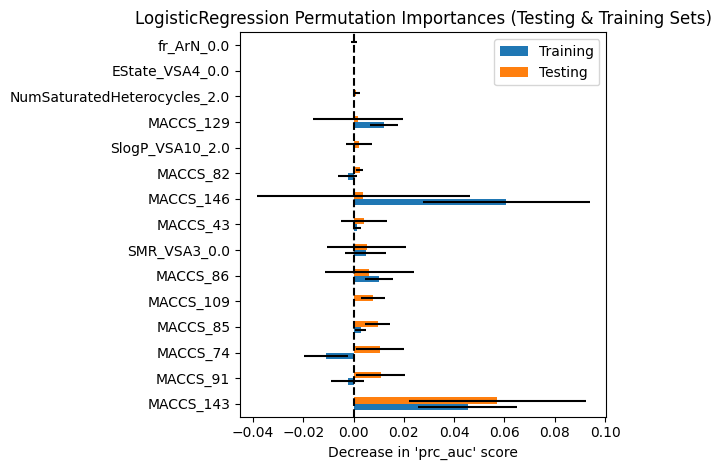

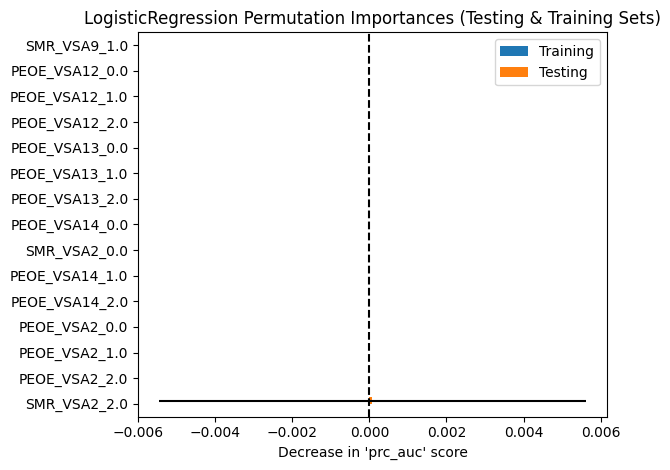

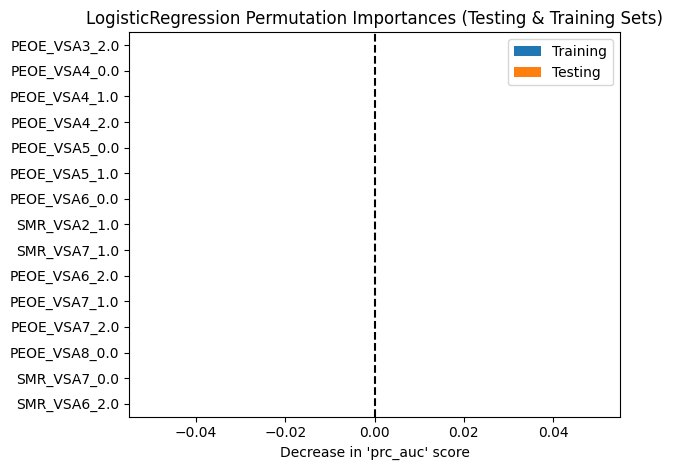

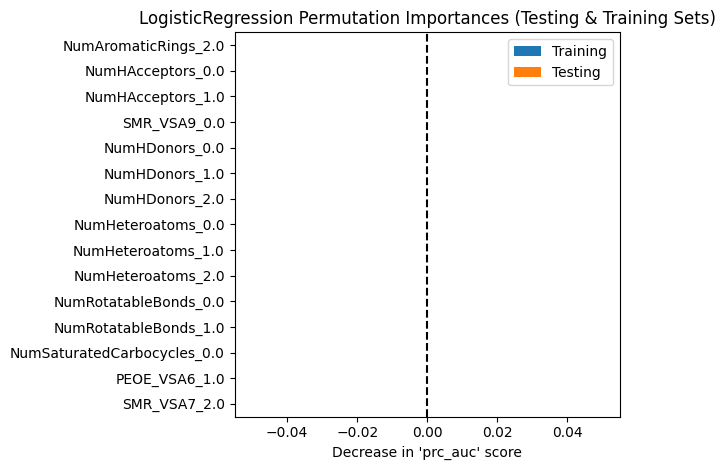

...

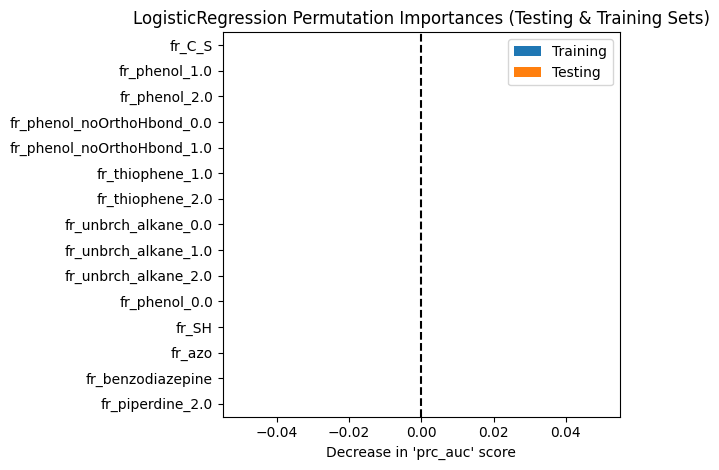

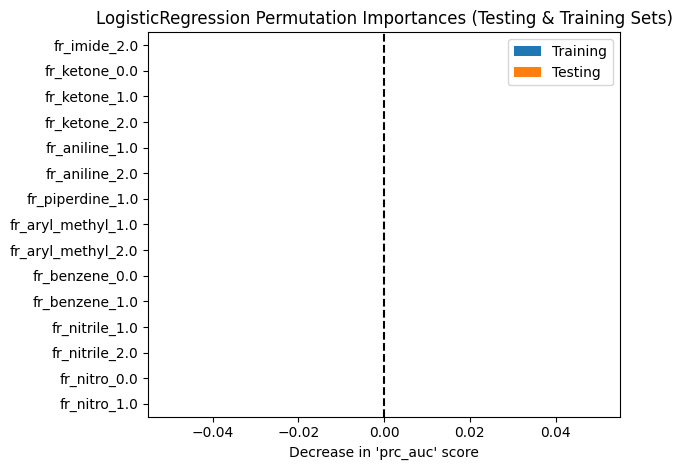

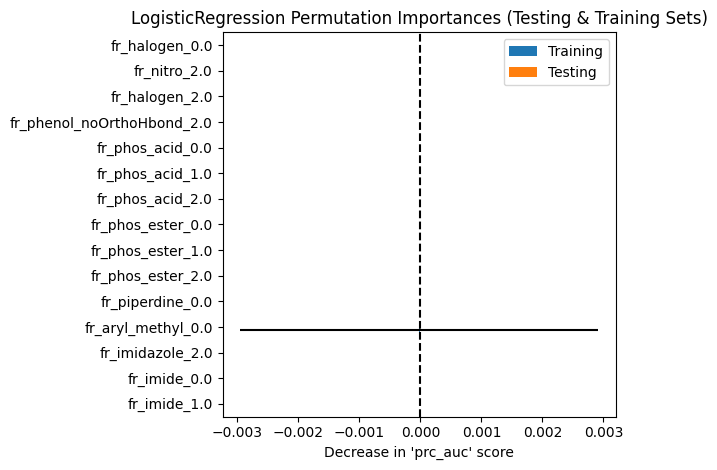

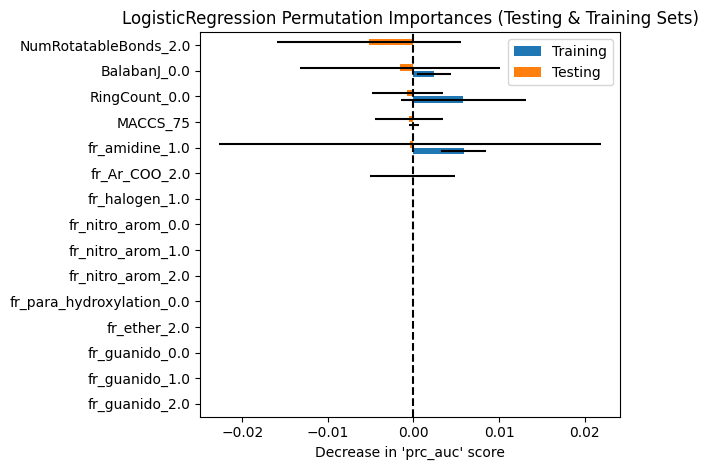

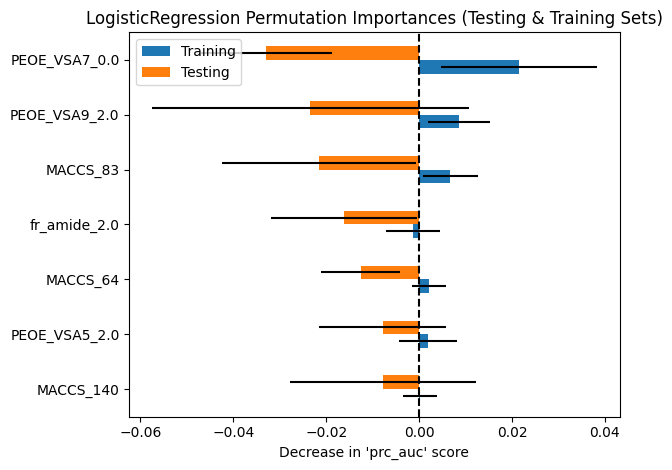



Removing unimportant features from permutation importance analysis and reevaluating model performance...
Number of important features: 38
Executing probability threshold tuning on the important TRAINING predictors:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.79      0.99      0.88       343
           1       0.77      0.16      0.26       108

    accuracy                           0.79       451
   macro avg       0.78      0.57      0.57       451
weighted avg       0.78      0.79      0.73       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.24330583862266825
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.94      0.70      0.80       343
           1       0.47      0.85      0.61       108


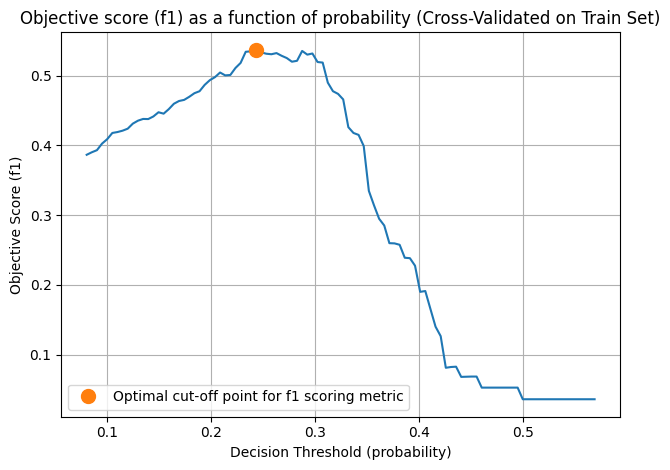



Evaluating model performance against the Testing Set:


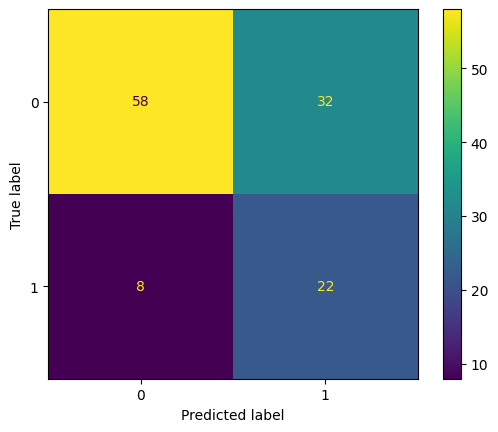

Model Accuracy Score: 0.6666666666666666


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.88      0.64      0.74        90
           1       0.41      0.73      0.52        30

    accuracy                           0.67       120
   macro avg       0.64      0.69      0.63       120
weighted avg       0.76      0.67      0.69       120

Precision-Recall and ROC Curves for the Testing Set:


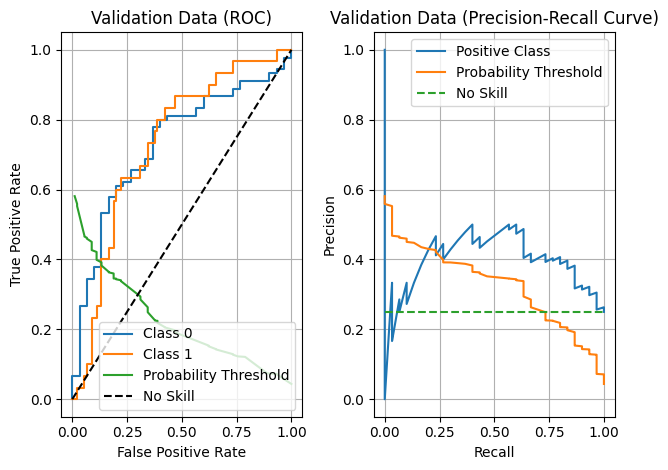

ROC AUC for Class 0 (computed with auc()): 0.7303703703703704
ROC AUC for Class 1 (computed with auc()): 0.7303703703703703
ROC AUC for Class 0 (computed with roc_auc_score()): 0.7303703703703703
ROC AUC for Class 1 (computed with roc_auc_score()): 0.7303703703703703
Precision-Recall AUC for Class 1 (computed with auc()): 0.390852803869796




In [ ]:
# Step 5 - Build the Logistic regression model
# Use SciKit LogisticRegressionCV to perform kf-fold cross-validation
# regression model
lasso_model = LogisticRegressionCV(
                Cs=200,
                cv=kf,
                penalty="l1",
                max_iter=10000,
                solver="saga",
                scoring='roc_auc',
                random_state=random_state,
                n_jobs=4
                )
lasso_model.fit(ZX_train, Y_train)

# Plot cross-validated weights of Lasso fit
print('Cross-Validation Lasso Plot for Training Data Set:')
lassoPlot(lasso_model, PlotType='CV', feature_labels=labels, predictors_to_sel=0)

# plot coefficient progression Lasso
print('Coefficient Progression Lasso Plot(s) for Training Data Set:')
regularization_alphas = lassoPlot(lasso_model, PlotType='Lambda', feature_labels=labels, predictors_to_sel=num_predictors_to_sel)

# Select 1 std. error lambda for regularization to filter out useless or
# highly correlated features
intercept_paths = lasso_model.coefs_paths_[1][:,:,-1].mean(axis=0)
coefs_paths = lasso_model.coefs_paths_[1][:,:,:-1].mean(axis=0)
alphas = 1/(lasso_model.Cs_)
print('Lambda (alpha) within 1 standard error of max score in the lasso fit:',
  alphas[regularization_alphas['alpha_1se_idx']])

# Step 5 - Build the Logistic regression model (select the coefficients from the
# Lasso Regression/Training - at this point the model has already been trained)
if sel_max_score :
  print('Model coefficients at Lambda (alpha)', 1/(lasso_model.C_[0]),
    '(max score):')
  print('Intercept: %.2f' %lasso_model.intercept_[0])
  print('Coefficients: ', lasso_model.coef_[0])
  print('\n')
else :
  print('Model coefficients at Lambda (alpha)', 1/(lasso_model.Cs_[regularization_alphas['alpha_1se_idx']]),
    '\nin the Lasso Regression):')
  print('Intercept: %.2f' %intercept_paths[regularization_alphas['alpha_1se_idx']])
  print('Coefficients: ', coefs_paths[regularization_alphas['alpha_1se_idx']])
  print('\n')

# Step 5 - Build the Logistic regression model (train the model) using the
# lambda (C) value derived from cross-validation - this time it is being
# re-trainied using the entire training datxaset rather than the coefficients
# being derived from averages across folds from a Lasso Regression for a lamba
# which maximized accuracy score. Use the tune_proba_thresh() helper method to
# tune the probability threshold to a score for the minority DIA-positive TEST
# records. Print the model coefficients.
if sel_max_score :
  regr = LogisticRegression(
          C=lasso_model.C_[0],
          penalty='l1',
          max_iter=10000,
          solver="saga",
          random_state=random_state
          )
  regr.fit(ZX_train, Y_train)
  print('Model coefficients at Lambda (alpha)', 1/(lasso_model.C_[0]),
  '(max score):')
  print('Intercept: %.2f' %regr.intercept_[0])
  print('Coefficients: ', regr.coef_[0])
  print('\n')
else :
  regr = LogisticRegression(
          C=lasso_model.Cs_[regularization_alphas['alpha_1se_idx']],
          penalty='l1',
          max_iter=10000,
          solver="saga",
          random_state=random_state
          )
  regr.fit(ZX_train, Y_train)
  print('Model coefficients at Lambda (alpha)', 1/(lasso_model.Cs_[regularization_alphas['alpha_1se_idx']]),
    '\nderived from refitting the model with the entire training dataset:')
  print('Intercept: %.2f' %regr.intercept_[0])
  print('Coefficients: ', regr.coef_[0])
  print('\n')

print('Executing probability threshold tuning on the TRAINING dataset:')
regr = tune_proba_thresh(
            model=regr,
            X_train=ZX_train,
            Y_train=Y_train,
            folds=kf,
            scorer='f1'
            )

print('Evaluating model performance after fitting to entire training dataset:')
# Step 6 - Predict training data (using default probability threshold of P>=0.5)
y_pred = regr.predict(ZX_train)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the training data.
score_logit_model(Y_train, y_pred)
print("Classification report for training data:\n", classification_report(Y_train, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the training data
print('Precision-Recall and ROC Curves for the Training Set:')
plot_roc_pr_binary(model=regr, X=ZX_train, Y=Y_train)

print('Evaluating model performance against the Testing Set:')
# Step 6 - Predict test data
y_pred = regr.predict(ZX_test)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the test data.
score_logit_model(Y_test, y_pred)
print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the test data.
print('Precision-Recall and ROC Curves for the Testing Set:')
plot_roc_pr_binary(model=regr, X=ZX_test, Y=Y_test)

# Analyze which records the model misclassified for each class
misclassified_records.at['Logistic Regression', 'Class 0 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 0)
misclassified_records.at['Logistic Regression', 'Class 0 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 0))[0])
misclassified_records.at['Logistic Regression', 'Class 1 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 1)
misclassified_records.at['Logistic Regression', 'Class 1 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 1))[0])

# Evaluate predictor importance with the report_feature_importance() helper
# method
print('Evaluating predictor importance for testing and training data...')
importance_mean, importance_std, _, importance_mean_test, _, _ = report_feature_importance(
                          model=regr,
                          X_train=ZX_train,
                          Y_train=Y_train,
                          X_test=ZX_test,
                          Y_test=Y_test,
                          labels=labels,
                          scoring='prc_auc',
                          num_features_to_rank=15
                          )

# Extract indices of top 15 importance train/test features and update the count for
# corresponding entries in our dict to track number of times each features has
# appeared in an estimators top 15 importance predictors
top_pred_train_idx = importance_mean.argsort()[-15:]
for idx in top_pred_train_idx :
  top_predictor_count_train.at[labels[idx], 'Top 15 Count'] += 1
top_pred_test_idx = importance_mean_test.argsort()[-15:]
for idx in top_pred_test_idx :
  top_predictor_count_test.at[labels[idx], 'Top 15 Count'] += 1

# Optionally remove features which are deemed hurtful to the model via
# permutation score analysis (negative scores) and reevaluate model performance
if reeval_imp_features :
  print('Removing unimportant features from permutation importance analysis',
    'and reevaluating model performance...')
  important_idx = np.where((importance_mean > 0) | (importance_std > 0))[0]
  print(f"Number of important features: {len(important_idx)}")

  ZX_train_important = ZX_train[:,important_idx]
  ZX_test_important = ZX_test[:,important_idx]
  regr_important = copy.deepcopy(regr.estimator_)
  regr_important.fit(ZX_train_important, Y_train)
  print('Executing probability threshold tuning on the important TRAINING predictors:')
  regr_important = tune_proba_thresh(
                    model=regr_important,
                    X_train=ZX_train_important,
                    Y_train=Y_train,
                    folds=kf,
                    scorer='f1'
                    )

  print('Evaluating model performance against the Testing Set:')
  # Step 6 - Predict test data
  y_pred = regr_important.predict(ZX_test_important)

  # Step 7 - Evaluate the model performance; report model accuracy score.
  # Visualize the model performance with a confusion matrix. Print the
  # Classification report for the test data.
  score_logit_model(Y_test, y_pred)
  print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

  # Plot the ROC for the model using the helper function plot_roc_pr_binary()
  # This helper function will also compute and print AUC for the test data.
  print('Precision-Recall and ROC Curves for the Testing Set:')
  plot_roc_pr_binary(model=regr_important, X=ZX_test_important, Y=Y_test)

Next, we train a SVC() model to predict DIA positive drugs from the testing/training data. The following cell trains and evaluates this model against the training **AND** test datasets. The sklearn TunedClassifierCV() is used to tune the prediction probability threshold to obtain a best given arbitrary (F-score, precision, accuracy, etc.) score for the minority DIA-positive class records in the data.

Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:
Executing search for best prc_auc score for classifier of type:  SVC
Parameter Grid: {'C': array([1.00000000e-03, 1.62377674e-03, 2.63665090e-03, 4.28133240e-03,
       6.95192796e-03, 1.12883789e-02, 1.83298071e-02, 2.97635144e-02,
       4.83293024e-02, 7.84759970e-02, 1.27427499e-01, 2.06913808e-01,
       3.35981829e-01, 5.45559478e-01, 8.85866790e-01, 1.43844989e+00,
       2.33572147e+00, 3.79269019e+00, 6.15848211e+00, 1.00000000e+01]), 'kernel': ['rbf'], 'gamma': ['scale', 'auto', np.float64(0.0001), np.float64(0.0002782559402207126), np.float64(0.000774263682681127), np.float64(0.002154434690031882), np.float64(0.005994842503189409), np.float64(0.016681005372000592), np.float64(0.046415888336127774), np.float64(0.12915496650148828), np.float64(0.3593813663804626), np.float64(1.0)], 'probability': [True], 'random_state': [0]}
Best prc_auc score: 0.7597882119022371
Best paramet

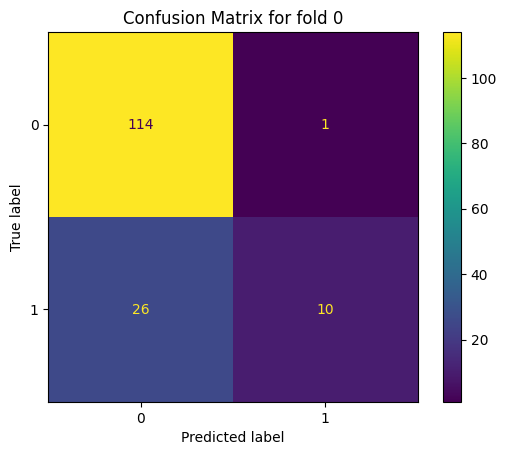

ROC AUC for fold 0: 0.6345410628019323
Precision-Recall AUC for fold 0: 0.7625052991228419


Performance Metrics Summary for fold 1:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.837037  0.991228  0.907631  0.846667    114.0
Class 1   0.933333  0.388889  0.549020  0.846667     36.0 



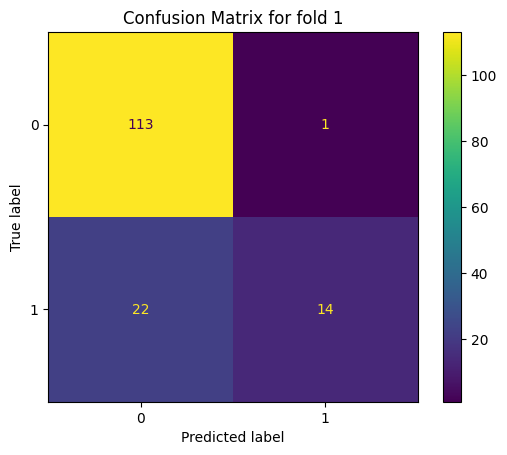

ROC AUC for fold 1: 0.6900584795321637
Precision-Recall AUC for fold 1: 0.700405631017988


Performance Metrics Summary for fold 2:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.814286  1.000000  0.897638  0.826667    114.0
Class 1   1.000000  0.277778  0.434783  0.826667     36.0 



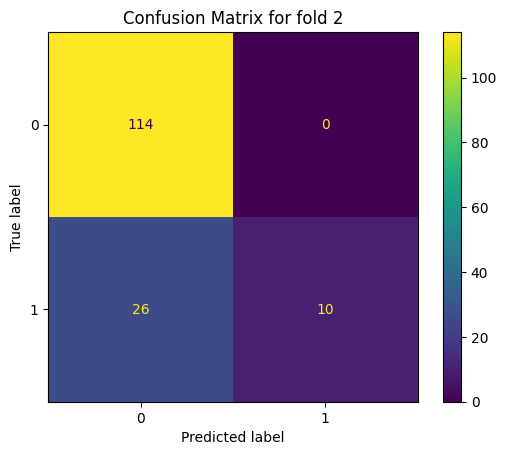

ROC AUC for fold 2: 0.6388888888888888
Precision-Recall AUC for fold 2: 0.8164537055658815


Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg       1.00      1.00      1.00       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.2365885341487548
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg    

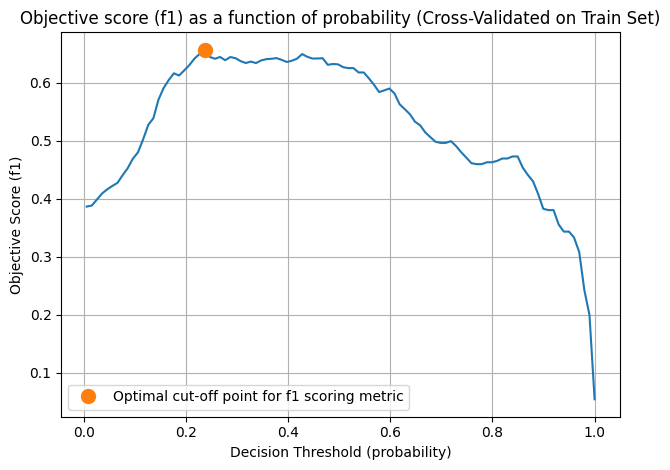



Evaluating model performance after fitting to entire training dataset:


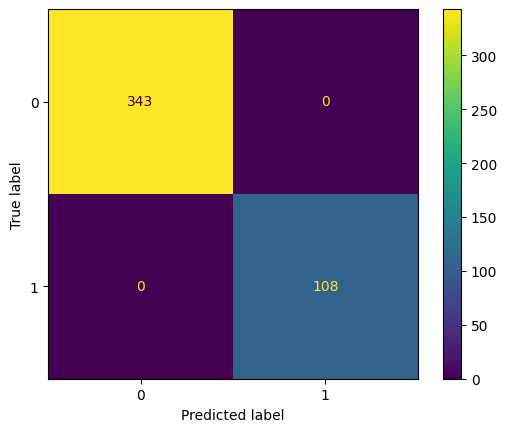

Model Accuracy Score: 1.0


Classification report for training data:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg       1.00      1.00      1.00       451

Precision-Recall and ROC Curves for the Training Set:


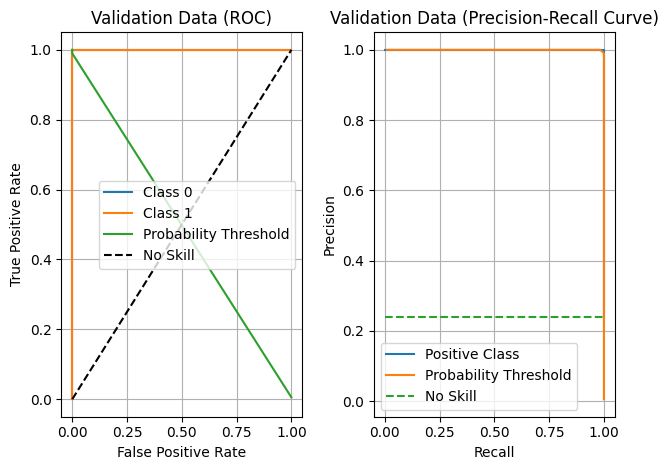

ROC AUC for Class 0 (computed with auc()): 1.0
ROC AUC for Class 1 (computed with auc()): 1.0
ROC AUC for Class 0 (computed with roc_auc_score()): 1.0
ROC AUC for Class 1 (computed with roc_auc_score()): 1.0
Precision-Recall AUC for Class 1 (computed with auc()): 1.0000000000000002


Evaluating model performance against the Testing Set:


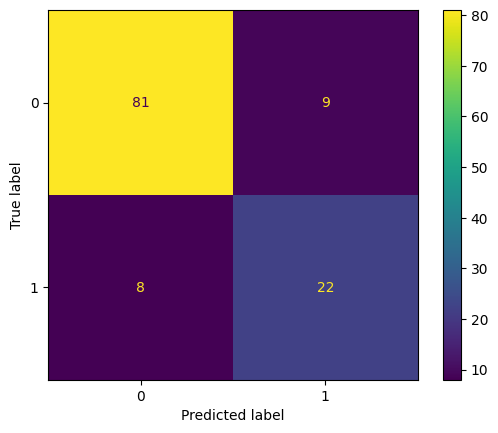

Model Accuracy Score: 0.8583333333333333


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.91      0.90      0.91        90
           1       0.71      0.73      0.72        30

    accuracy                           0.86       120
   macro avg       0.81      0.82      0.81       120
weighted avg       0.86      0.86      0.86       120

Precision-Recall and ROC Curves for the Testing Set:


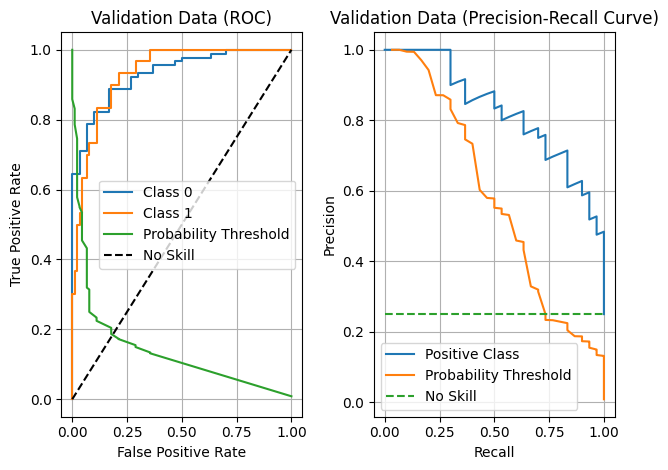

ROC AUC for Class 0 (computed with auc()): 0.9322222222222222
ROC AUC for Class 1 (computed with auc()): 0.9322222222222222
ROC AUC for Class 0 (computed with roc_auc_score()): 0.9322222222222222
ROC AUC for Class 1 (computed with roc_auc_score()): 0.9322222222222222
Precision-Recall AUC for Class 1 (computed with auc()): 0.8262213869697738


Evaluating predictor importance for testing and training data...
Top important features from SVC Model in Training Set (permutation_importance):
               Feature Labels  Feature Importance  Feature Indices
0                   MACCS_140            0.008755              621
1                   MACCS_146            0.007343              627
2                   MACCS_143            0.007147              624
3   fr_para_hydroxylation_0.0            0.005871              432
4   fr_para_hydroxylation_1.0            0.005862              433
5                   MACCS_116            0.005708              597
6                    MACCS_83            

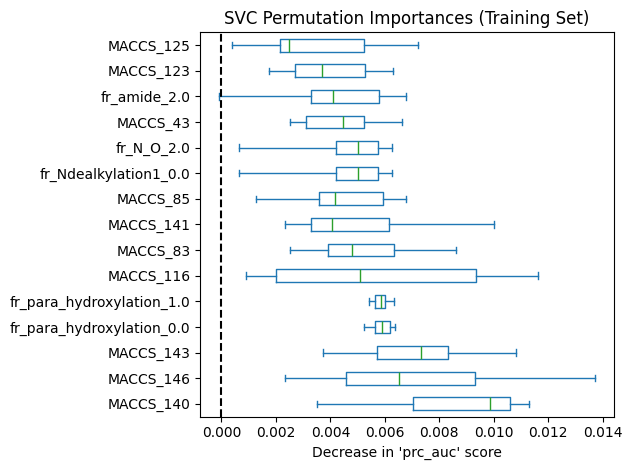



Top important features from SVC Model in Test Set (permutation_importance):
      Feature Labels  Feature Importance  Feature Indices
0           MACCS_80            0.020460              561
1          MACCS_140            0.014016              621
2   FractionCSP3_1.0            0.011356               79
3           MACCS_87            0.011232              568
4           MACCS_90            0.010945              571
5          MACCS_109            0.010817              590
6          MACCS_143            0.010177              624
7           MACCS_62            0.010168              543
8           MACCS_83            0.010154              564
9          MACCS_133            0.010141              614
10         MACCS_117            0.010141              598
11         MACCS_121            0.009582              602
12         MACCS_129            0.009573              610
13          MACCS_68            0.009479              549
14         MACCS_123            0.009042            

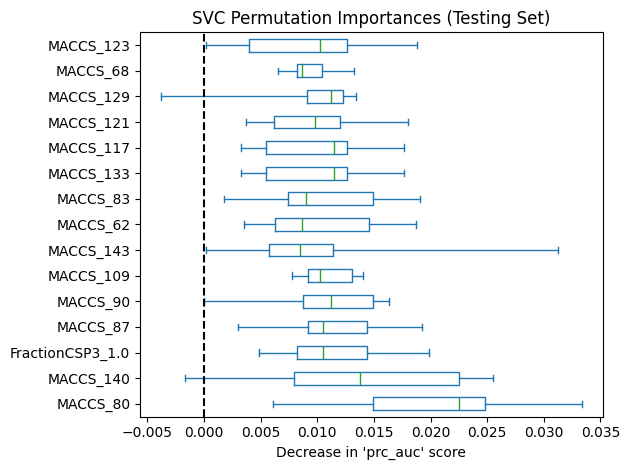

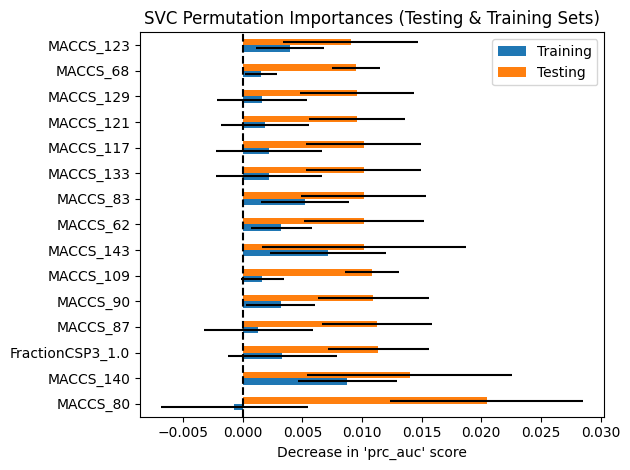

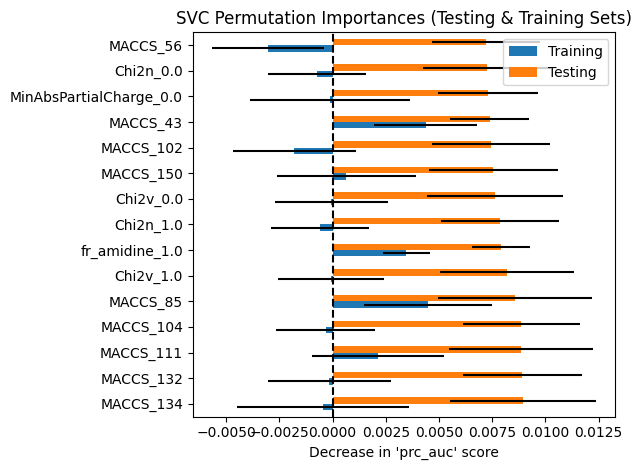

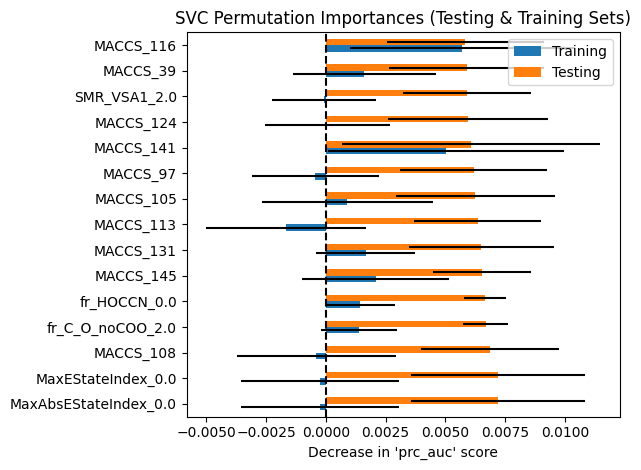

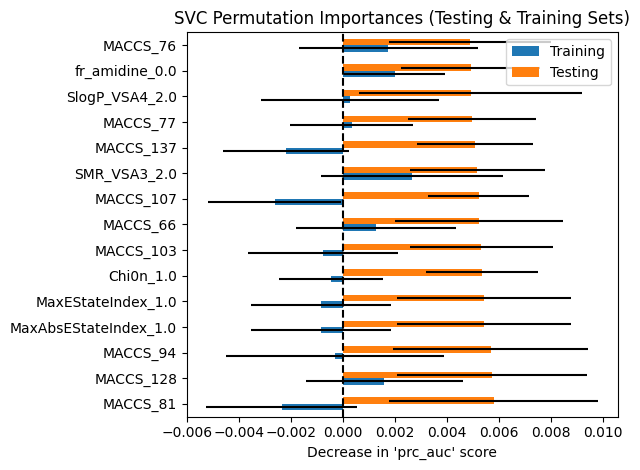

...

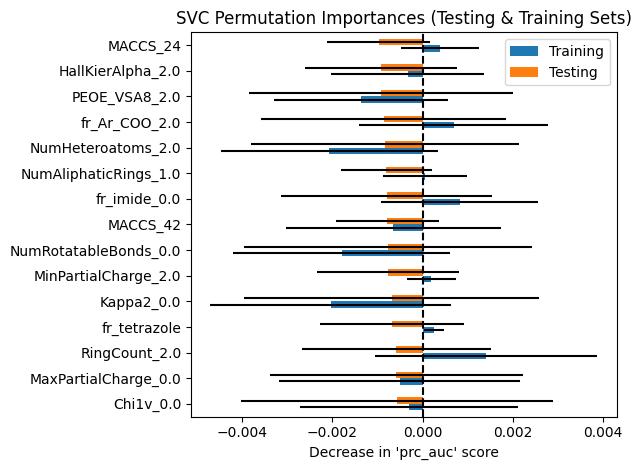

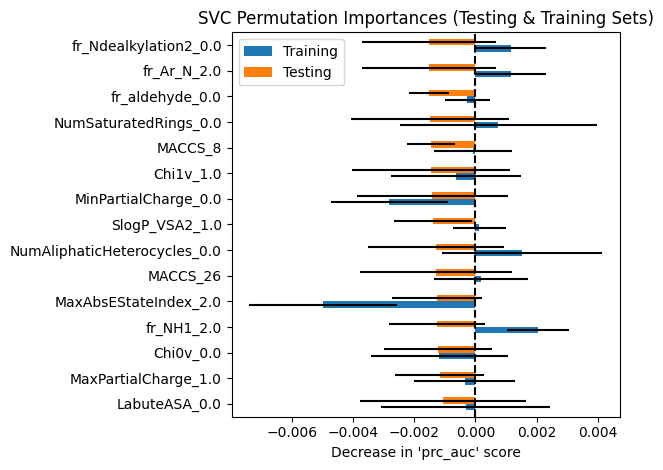

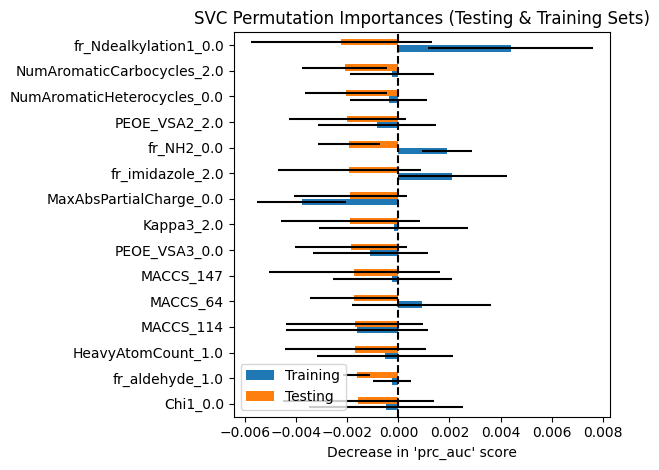

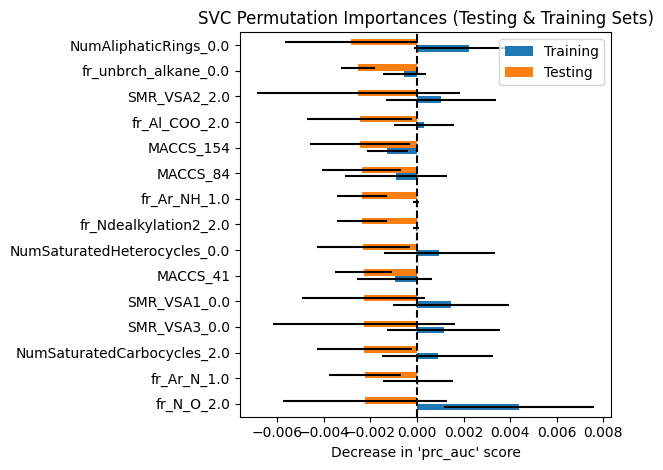

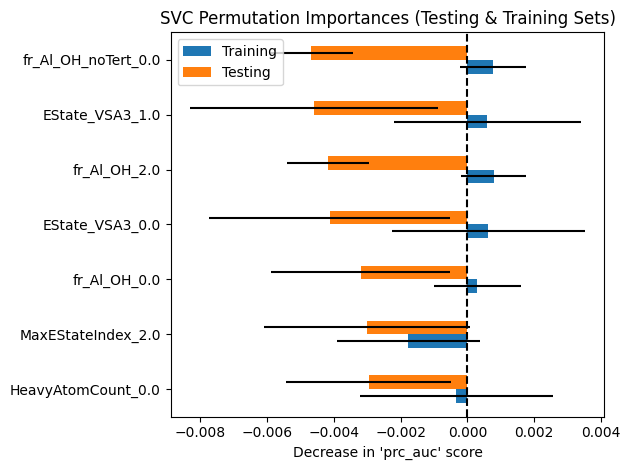



Removing unimportant features from permutation importance analysis and reevaluating model performance...
Number of important features: 613
Executing probability threshold tuning on the important TRAINING predictors:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg       1.00      1.00      1.00       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.23659146992853863
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

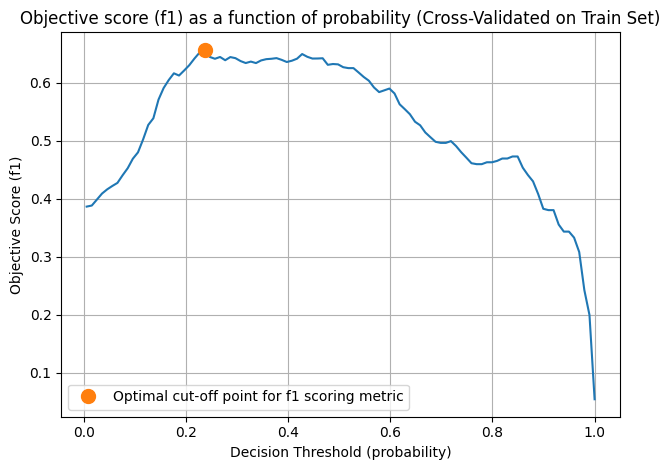



Evaluating model performance against the Testing Set:


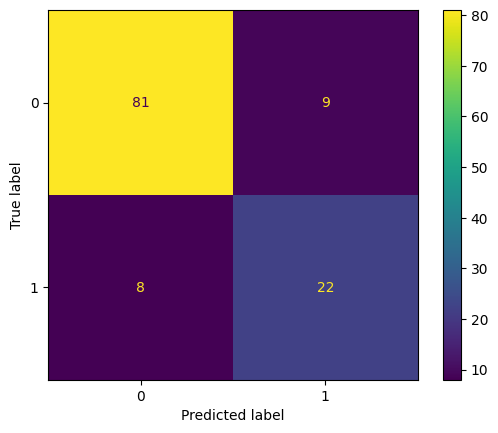

Model Accuracy Score: 0.8583333333333333


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.91      0.90      0.91        90
           1       0.71      0.73      0.72        30

    accuracy                           0.86       120
   macro avg       0.81      0.82      0.81       120
weighted avg       0.86      0.86      0.86       120

Precision-Recall and ROC Curves for the Testing Set:


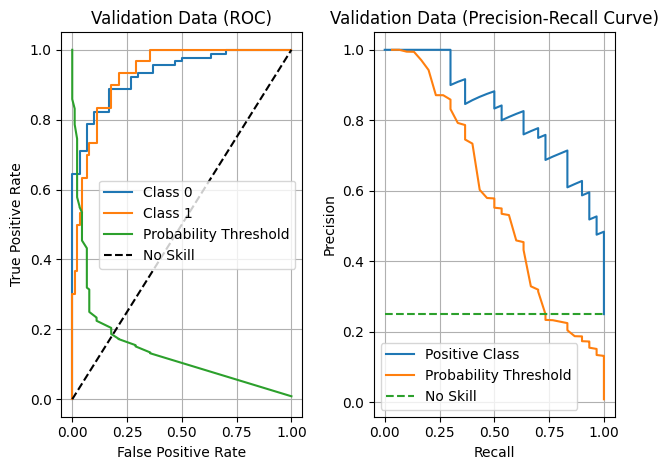

ROC AUC for Class 0 (computed with auc()): 0.9322222222222222
ROC AUC for Class 1 (computed with auc()): 0.9322222222222222
ROC AUC for Class 0 (computed with roc_auc_score()): 0.9322222222222222
ROC AUC for Class 1 (computed with roc_auc_score()): 0.9322222222222222
Precision-Recall AUC for Class 1 (computed with auc()): 0.8262213869697738




In [ ]:
# Specify a parameter grid for selecting tuning parameters
param_grid = {
  'C': np.logspace(-3, 1, 20),
  'kernel': ['rbf'],
  'gamma': ['scale', 'auto'] + list(np.logspace(-4, 0, 10)),
  'probability': [True],
  'random_state': [random_state]
   }

# Step 5 - Build the Support Vector Machine model. Use SciKit SVC() Object and
# use the search_best_auc() helper method to find a model which will score best
# for ROC/PR AUC against the TEST data and also tune the probability threshold
# to a score for the minority DIA-positive TEST records.
print('Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:')
clf_svc = search_best_auc(
            clf_type=SVC,
            X_train=ZX_train,
            Y_train=Y_train,
            param_grid=param_grid,
            folds=kf,
            auc_scorer='prc_auc',
            scorer='f1'
            )

print('Evaluating model performance after fitting to entire training dataset:')
# Step 6 - Predict training data (using default probability threshold of P>=0.5)
y_pred = clf_svc.predict(ZX_train)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the training data.
score_logit_model(Y_train, y_pred)
print("Classification report for training data:\n", classification_report(Y_train, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the training data
print('Precision-Recall and ROC Curves for the Training Set:')
plot_roc_pr_binary(model=clf_svc, X=ZX_train, Y=Y_train)

print('Evaluating model performance against the Testing Set:')
# Step 6 - Predict test data
y_pred = clf_svc.predict(ZX_test)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the test data.
score_logit_model(Y_test, y_pred)
print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the test data.
print('Precision-Recall and ROC Curves for the Testing Set:')
plot_roc_pr_binary(model=clf_svc, X=ZX_test, Y=Y_test)

# Analyze which records the model misclassified for each class
misclassified_records.at['SVC (RBF)', 'Class 0 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 0)
misclassified_records.at['SVC (RBF)', 'Class 0 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 0))[0])
misclassified_records.at['SVC (RBF)', 'Class 1 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 1)
misclassified_records.at['SVC (RBF)', 'Class 1 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 1))[0])

# Evaluate predictor importance with the report_feature_importance() helper
# method
print('Evaluating predictor importance for testing and training data...')
importance_mean, importance_std, _, importance_mean_test, _, _  = report_feature_importance(
                          model=clf_svc,
                          X_train=ZX_train,
                          Y_train=Y_train,
                          X_test=ZX_test,
                          Y_test=Y_test,
                          labels=labels,
                          scoring='prc_auc',
                          num_features_to_rank=15
                          )

# Extract indices of top 15 importance train features and update the count for
# corresponding entries in our dict to track number of times each features has
# appeared in an estimators top 15 importance predictors
top_pred_train_idx = importance_mean.argsort()[-15:]
for idx in top_pred_train_idx :
  top_predictor_count_train.at[labels[idx], 'Top 15 Count'] += 1
top_pred_test_idx = importance_mean_test.argsort()[-15:]
for idx in top_pred_test_idx :
  top_predictor_count_test.at[labels[idx], 'Top 15 Count'] += 1

# Optionally remove features which are deemed hurtful to the model via
# permutation score analysis (negative scores) and reevaluate model performance
if reeval_imp_features :
  print('Removing unimportant features from permutation importance analysis',
    'and reevaluating model performance...')
  important_idx = np.where((importance_mean > 0) | (importance_std > 0))[0]
  print(f"Number of important features: {len(important_idx)}")

  ZX_train_important = ZX_train[:,important_idx]
  ZX_test_important = ZX_test[:,important_idx]
  clf_svc_important = copy.deepcopy(clf_svc.estimator_)
  clf_svc_important.fit(ZX_train_important, Y_train)
  print('Executing probability threshold tuning on the important TRAINING predictors:')
  clf_svc_important = tune_proba_thresh(
                        model=clf_svc_important,
                        X_train=ZX_train_important,
                        Y_train=Y_train,
                        folds=kf,
                        scorer='f1'
                        )

  print('Evaluating model performance against the Testing Set:')
  # Step 6 - Predict test data
  y_pred = clf_svc_important.predict(ZX_test_important)

  # Step 7 - Evaluate the model performance; report model accuracy score.
  # Visualize the model performance with a confusion matrix. Print the
  # Classification report for the test data.
  score_logit_model(Y_test, y_pred)
  print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

  # Plot the ROC for the model using the helper function plot_roc_pr_binary()
  # This helper function will also compute and print AUC for the test data.
  print('Precision-Recall and ROC Curves for the Testing Set:')
  plot_roc_pr_binary(model=clf_svc_important, X=ZX_test_important, Y=Y_test)

Now, we train a RandomForestClassifier() model to predict DIA positive drugs from the testing/training data. The following cell trains and evaluates this model against the training **AND** test datasets. The sklearn TunedClassifierCV() is used to tune the prediction probability threshold to obtain a best given arbitrary (F-score, precision, accuracy, etc.) score for the minority DIA-positive class records in the data.

Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:
Executing search for best prc_auc score for classifier of type:  RandomForestClassifier
Parameter Grid: {'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'], 'max_depth': [3, 5, 10], 'max_leaf_nodes': [10, 25, 50], 'min_samples_leaf': [2, 5, 10], 'max_samples': [0.5, 0.7, 1.0], 'max_features': [10, 'sqrt', 'log2'], 'random_state': [0]}
Best prc_auc score: 0.6834348846256303
Best parameters: {'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'max_leaf_nodes': 50, 'max_samples': 1.0, 'min_samples_leaf': 2, 'n_estimators': 100, 'random_state': 0}
Performance Metrics Summary for fold 0:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.801418  0.982609  0.882812  0.801325    115.0
Class 1   0.800000  0.222222  0.347826  0.801325     36.0 



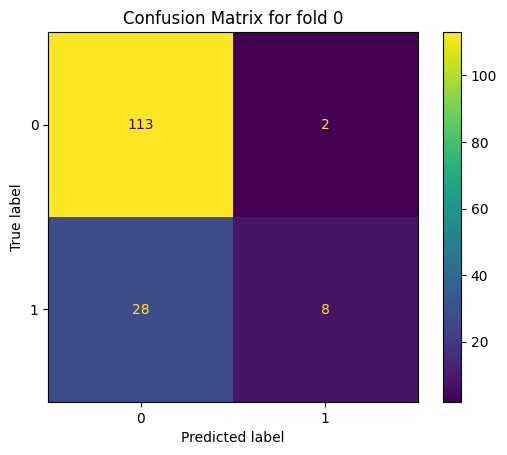

ROC AUC for fold 0: 0.6024154589371981
Precision-Recall AUC for fold 0: 0.6418170380326556


Performance Metrics Summary for fold 1:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.838235  1.000000     0.912  0.853333    114.0
Class 1   1.000000  0.388889     0.560  0.853333     36.0 



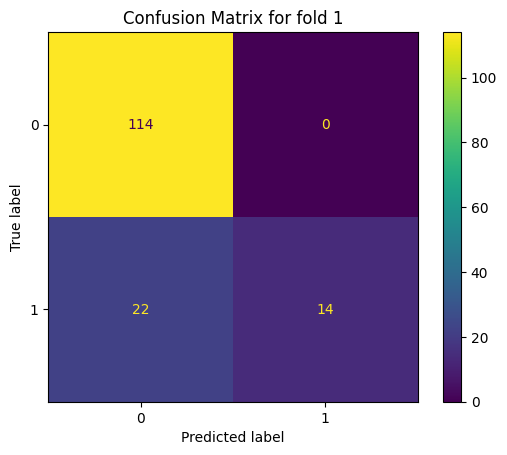

ROC AUC for fold 1: 0.6944444444444444
Precision-Recall AUC for fold 1: 0.7506958888771664


Performance Metrics Summary for fold 2:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.808824  0.964912      0.88       0.8    114.0
Class 1   0.714286  0.277778      0.40       0.8     36.0 



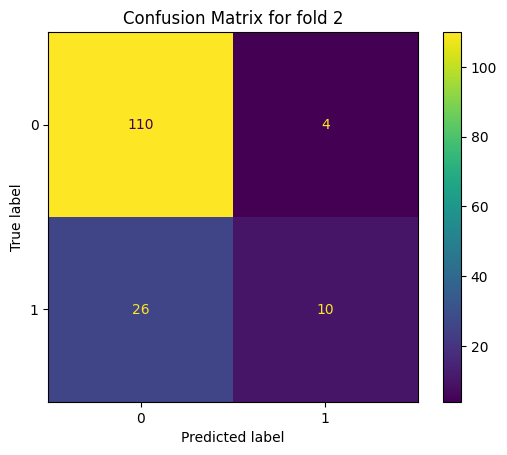

ROC AUC for fold 2: 0.6213450292397661
Precision-Recall AUC for fold 2: 0.6577917269670688


Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.94      1.00      0.97       343
           1       1.00      0.79      0.88       108

    accuracy                           0.95       451
   macro avg       0.97      0.89      0.92       451
weighted avg       0.95      0.95      0.95       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.3560987004973962
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.99      0.99      0.99       343
           1       0.98      0.96      0.97       108

    accuracy                           0.99       451
   macro avg       0.98      0.98      0.98       451
weighted avg    

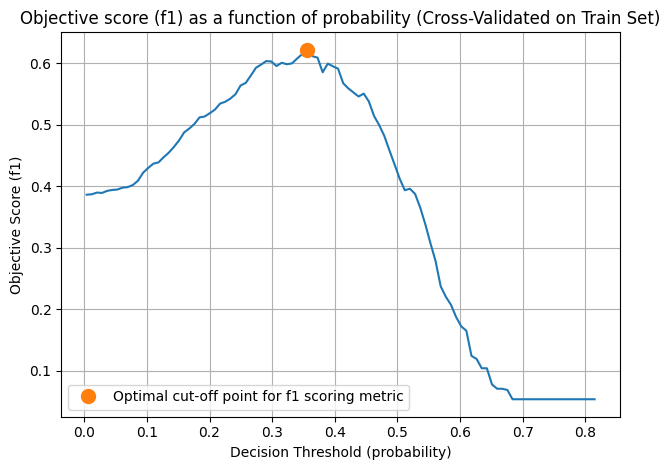



Evaluating model performance after fitting to entire training dataset:


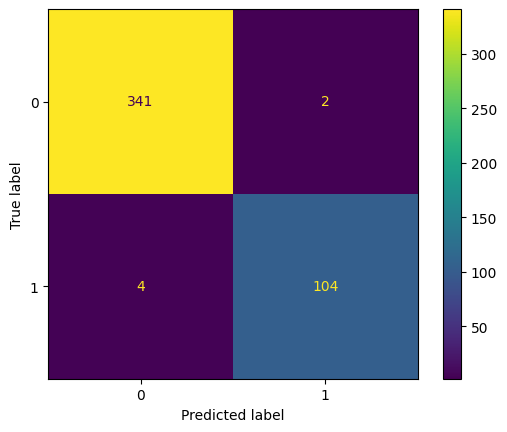

Model Accuracy Score: 0.9866962305986696


Classification report for training data:
               precision    recall  f1-score   support

           0       0.99      0.99      0.99       343
           1       0.98      0.96      0.97       108

    accuracy                           0.99       451
   macro avg       0.98      0.98      0.98       451
weighted avg       0.99      0.99      0.99       451

Precision-Recall and ROC Curves for the Training Set:


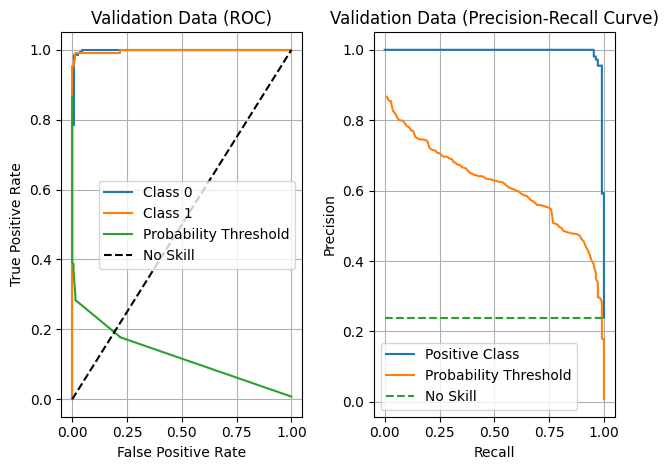

ROC AUC for Class 0 (computed with auc()): 0.9975974516790844
ROC AUC for Class 1 (computed with auc()): 0.9975974516790844
ROC AUC for Class 0 (computed with roc_auc_score()): 0.9975974516790844
ROC AUC for Class 1 (computed with roc_auc_score()): 0.9975974516790844
Precision-Recall AUC for Class 1 (computed with auc()): 0.9949567065610294


Evaluating model performance against the Testing Set:


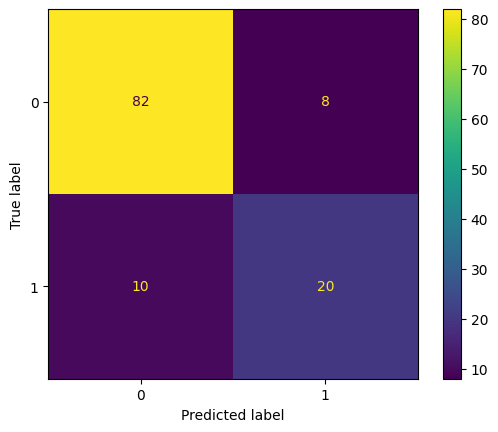

Model Accuracy Score: 0.85


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.89      0.91      0.90        90
           1       0.71      0.67      0.69        30

    accuracy                           0.85       120
   macro avg       0.80      0.79      0.80       120
weighted avg       0.85      0.85      0.85       120

Precision-Recall and ROC Curves for the Testing Set:


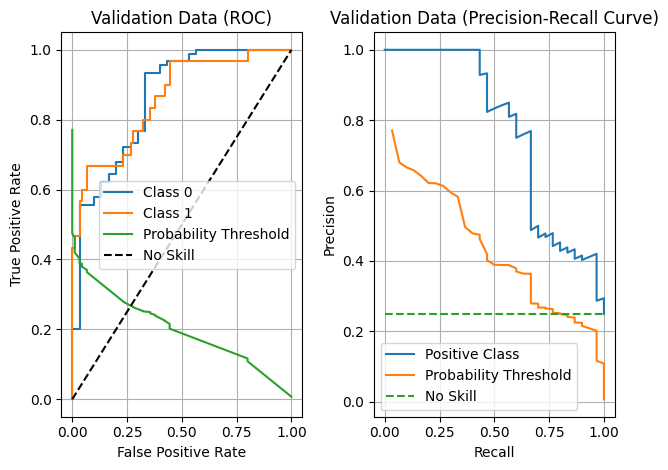

ROC AUC for Class 0 (computed with auc()): 0.8588888888888889
ROC AUC for Class 1 (computed with auc()): 0.8588888888888889
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8588888888888889
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8588888888888889
Precision-Recall AUC for Class 1 (computed with auc()): 0.7683671788885184


Evaluating predictor importance for testing and training data...
Top important features from RandomForestClassifier Model:
      Feature Labels  Feature Importance  Feature Indices
0          MACCS_146            0.013774              627
1     fr_amidine_1.0            0.011163              382
2           MACCS_85            0.010008              566
3           MACCS_43            0.009319              525
4          MACCS_143            0.008819              624
5   EState_VSA10_0.0            0.008377               45
6       fr_amide_2.0            0.008211              380
7    SlogP_VSA10_0.0            0.008007              261
8         

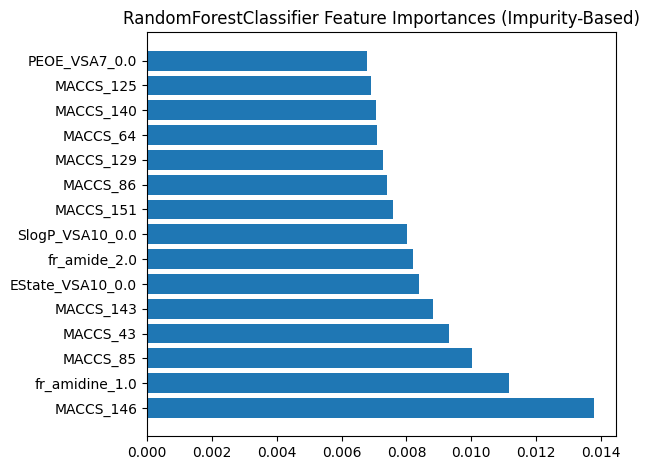



Top important features from RandomForestClassifier Model in Training Set (permutation_importance):
      Feature Labels  Feature Importance  Feature Indices
0          MACCS_143            0.015410              624
1   EState_VSA10_1.0            0.009991               46
2     fr_amidine_1.0            0.007621              382
3   EState_VSA10_0.0            0.007263               45
4           MACCS_85            0.007156              566
5           MACCS_64            0.006551              545
6          MACCS_146            0.006463              627
7           MACCS_86            0.006311              567
8           MACCS_43            0.005793              525
9          MACCS_110            0.005365              591
10          MACCS_99            0.005295              580
11  FractionCSP3_0.0            0.005281               78
12         MACCS_151            0.005244              632
13      fr_nitro_0.0            0.005061              426
14          MACCS_69         

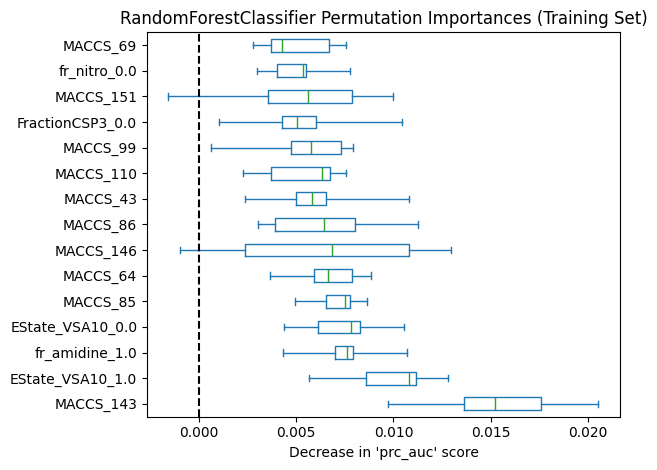



Top important features from RandomForestClassifier Model in Test Set (permutation_importance):
         Feature Labels  Feature Importance  Feature Indices
0              MACCS_80            0.013424              561
1             MACCS_143            0.011574              624
2            fr_ArN_0.0            0.011572              312
3   fr_Al_OH_noTert_2.0            0.011440              311
4       SlogP_VSA10_0.0            0.010493              261
5        fr_amidine_1.0            0.009184              382
6              MACCS_90            0.009033              571
7         PEOE_VSA5_2.0            0.008888              215
8         RingCount_0.0            0.008514              228
9        SlogP_VSA1_2.0            0.008386              260
10             MACCS_43            0.007866              525
11            MACCS_109            0.007503              590
12             MACCS_85            0.007226              566
13         SMR_VSA6_2.0            0.006673      

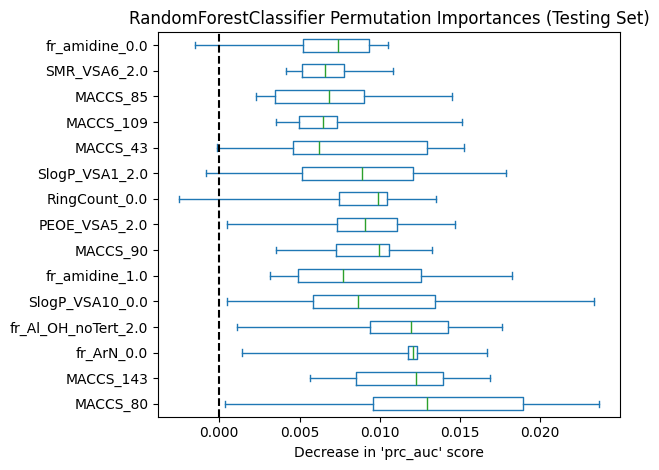

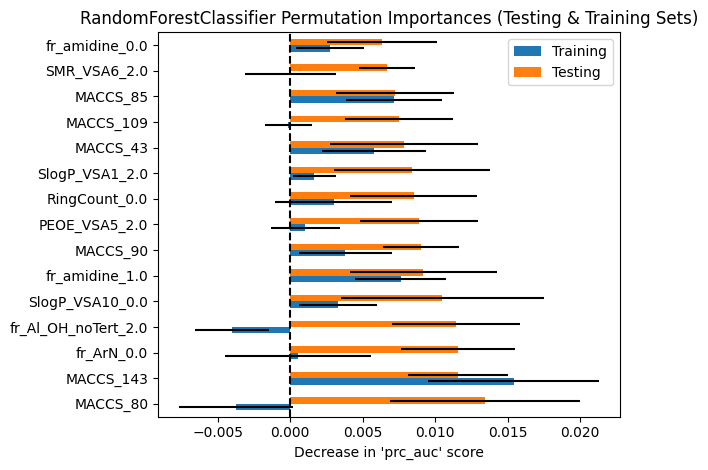

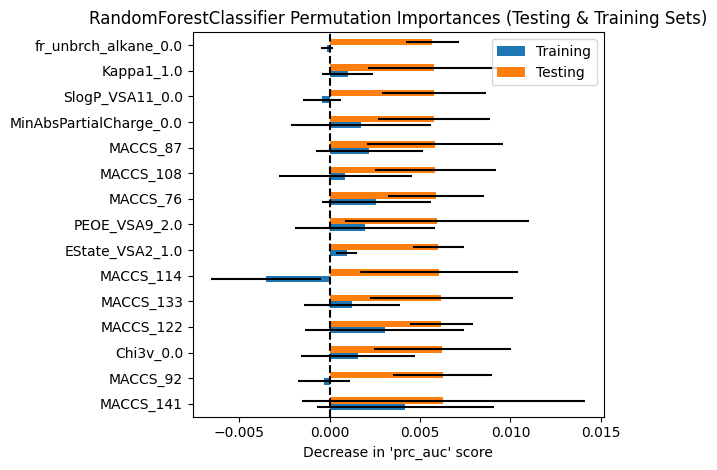

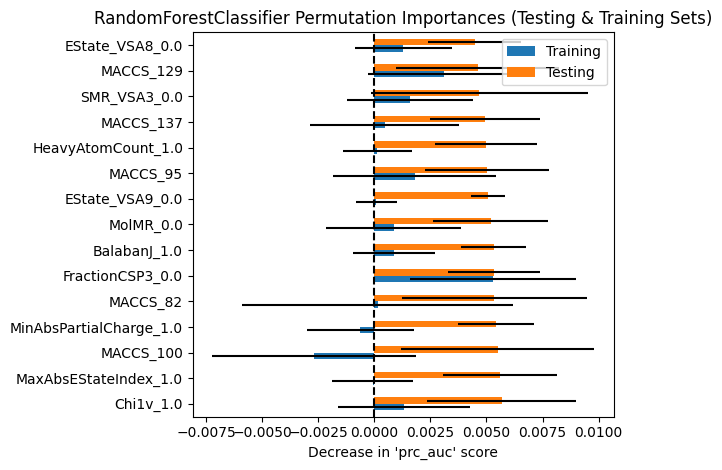

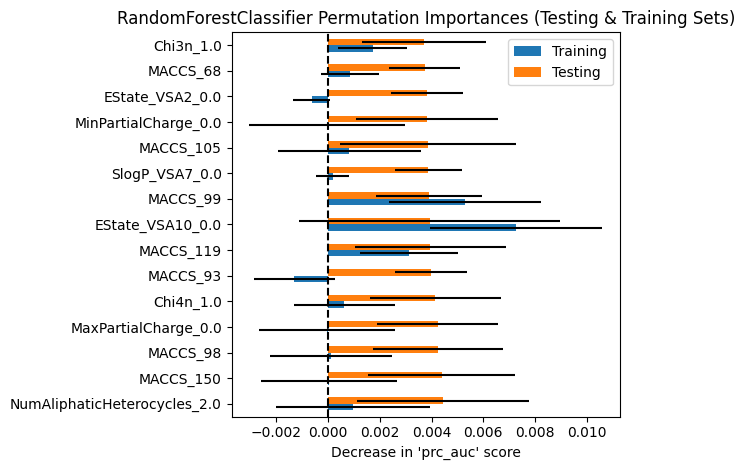

...

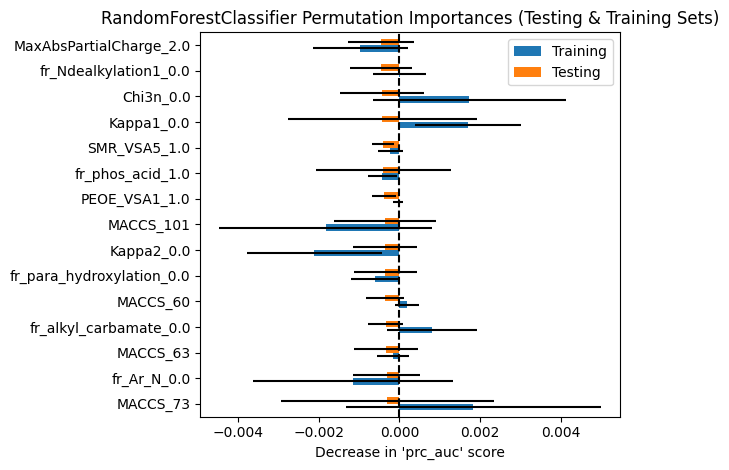

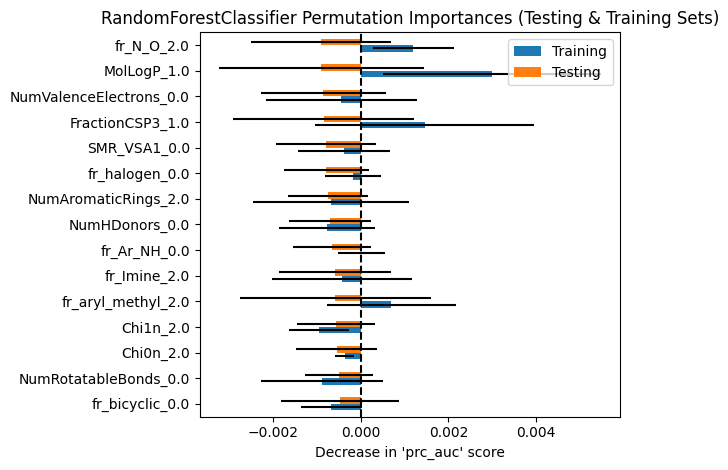

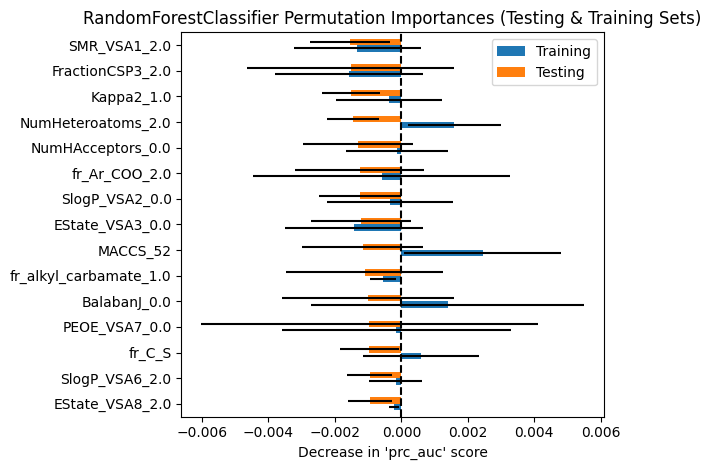

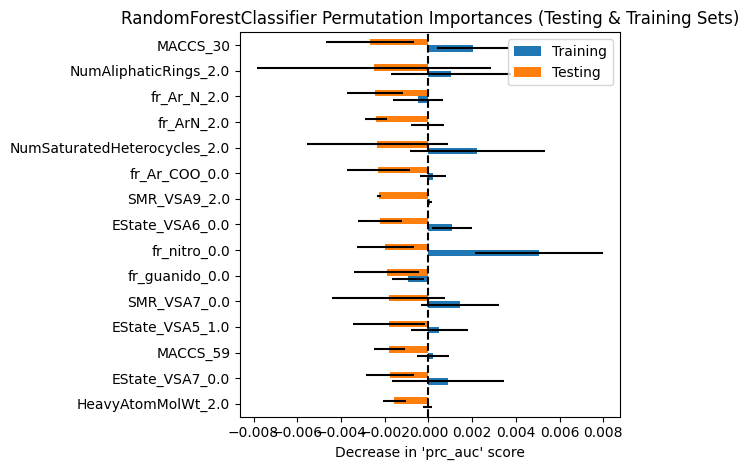

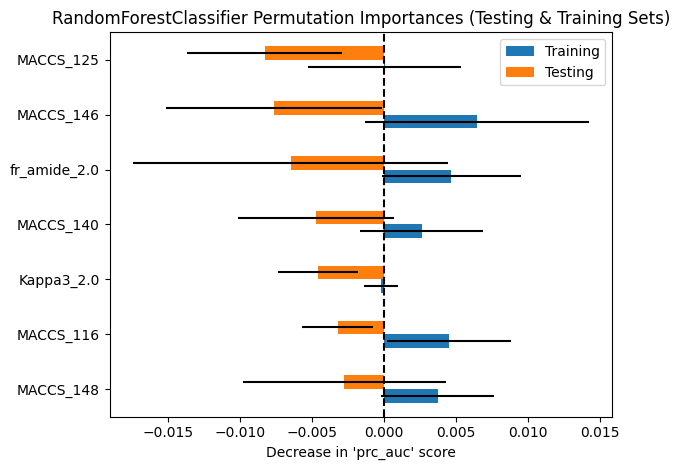



Removing unimportant features from permutation importance analysis and reevaluating model performance...
Number of important features: 490
Executing probability threshold tuning on the important TRAINING predictors:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.93      1.00      0.96       343
           1       1.00      0.75      0.86       108

    accuracy                           0.94       451
   macro avg       0.96      0.88      0.91       451
weighted avg       0.94      0.94      0.94       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.30450215890043214
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.99      0.99      0.99       343
           1       0.95      0.98      0.97       108

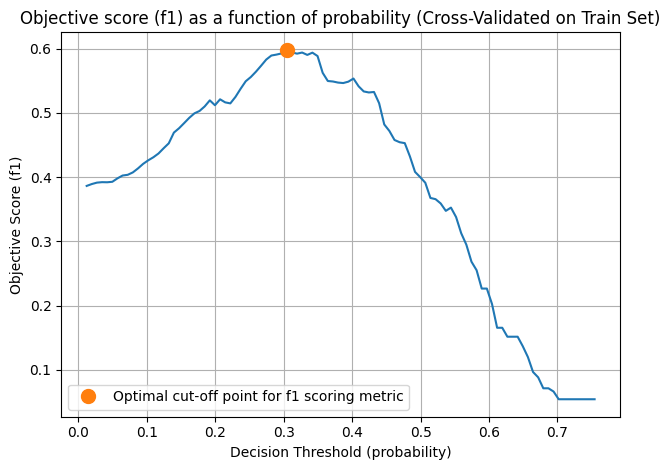



Evaluating model performance against the Testing Set:


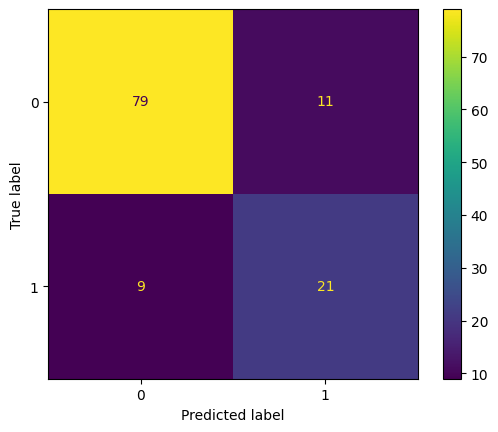

Model Accuracy Score: 0.8333333333333334


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.90      0.88      0.89        90
           1       0.66      0.70      0.68        30

    accuracy                           0.83       120
   macro avg       0.78      0.79      0.78       120
weighted avg       0.84      0.83      0.84       120

Precision-Recall and ROC Curves for the Testing Set:


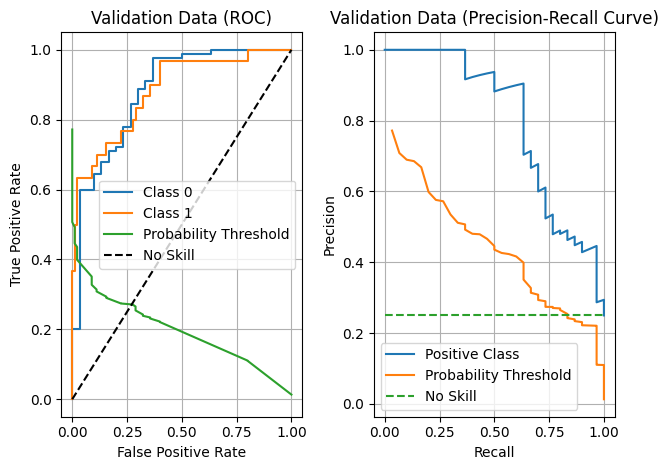

ROC AUC for Class 0 (computed with auc()): 0.8814814814814815
ROC AUC for Class 1 (computed with auc()): 0.8814814814814815
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8814814814814815
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8814814814814815
Precision-Recall AUC for Class 1 (computed with auc()): 0.7953637488191948




In [ ]:
# Specify a parameter grid for selecting tuning parameters
param_grid = {
  'n_estimators': [10, 50, 100],
  'criterion': ['gini', 'entropy'],
  'max_depth': [3, 5, 10],
  'max_leaf_nodes': [10, 25, 50],
  'min_samples_leaf' : [2, 5, 10],
  'max_samples' : [0.5, 0.7, 1.0],
  'max_features': [10, 'sqrt', 'log2'],
  'random_state': [random_state]
   }

# Step 5 - Build the Random Forest Classifier model. Use SciKit
# RandomForestClassifier() Object and use the search_best_auc() helper
# method to find a model which will score best for ROC/PR AUC against the TEST
# data and also tune the probability threshold to a score for the minority
# DIA-positive TEST records.
print('Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:')
clf_rf = search_best_auc(
            clf_type=RandomForestClassifier,
            X_train=ZX_train,
            Y_train=Y_train,
            param_grid=param_grid,
            folds=kf,
            auc_scorer='prc_auc',
            scorer='f1'
            )

print('Evaluating model performance after fitting to entire training dataset:')
# Step 6 - Predict training data (using default probability threshold of P>=0.5)
y_pred = clf_rf.predict(ZX_train)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the training data.
score_logit_model(Y_train, y_pred)
print("Classification report for training data:\n", classification_report(Y_train, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the training data
print('Precision-Recall and ROC Curves for the Training Set:')
plot_roc_pr_binary(model=clf_rf, X=ZX_train, Y=Y_train)

print('Evaluating model performance against the Testing Set:')
# Step 6 - Predict test data
y_pred = clf_rf.predict(ZX_test)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the test data.
score_logit_model(Y_test, y_pred)
print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the test data.
print('Precision-Recall and ROC Curves for the Testing Set:')
plot_roc_pr_binary(model=clf_rf, X=ZX_test, Y=Y_test)

# Analyze which records the model misclassified for each class
misclassified_records.at['RandomForest', 'Class 0 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 0)
misclassified_records.at['RandomForest', 'Class 0 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 0))[0])
misclassified_records.at['RandomForest', 'Class 1 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 1)
misclassified_records.at['RandomForest', 'Class 1 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 1))[0])

# Evaluate predictor importance with the report_feature_importance() helper
# method
print('Evaluating predictor importance for testing and training data...')
importance_mean, importance_std, _, importance_mean_test, _, _ = report_feature_importance(
                          model=clf_rf,
                          X_train=ZX_train,
                          Y_train=Y_train,
                          X_test=ZX_test,
                          Y_test=Y_test,
                          labels=labels,
                          scoring='prc_auc',
                          num_features_to_rank=15
                          )

# Extract indices of top 15 importance train features and update the count for
# corresponding entries in our dict to track number of times each features has
# appeared in an estimators top 15 importance predictors
top_pred_train_idx = importance_mean.argsort()[-15:]
for idx in top_pred_train_idx :
  top_predictor_count_train.at[labels[idx], 'Top 15 Count'] += 1
top_pred_test_idx = importance_mean_test.argsort()[-15:]
for idx in top_pred_test_idx :
  top_predictor_count_test.at[labels[idx], 'Top 15 Count'] += 1

# Optionally remove features which are deemed hurtful to the model via
# permutation score analysis (negative scores) and reevaluate model performance
if reeval_imp_features :
  print('Removing unimportant features from permutation importance analysis',
    'and reevaluating model performance...')
  important_idx = np.where((importance_mean > 0) | (importance_std > 0))[0]
  print(f"Number of important features: {len(important_idx)}")

  ZX_train_important = ZX_train[:,important_idx]
  ZX_test_important = ZX_test[:,important_idx]
  clf_rf_important = copy.deepcopy(clf_rf.estimator_)
  clf_rf_important.fit(ZX_train_important, Y_train)
  print('Executing probability threshold tuning on the important TRAINING predictors:')
  clf_rf_important = tune_proba_thresh(
                        model=clf_rf_important,
                        X_train=ZX_train_important,
                        Y_train=Y_train,
                        folds=kf,
                        scorer='f1'
                        )

  print('Evaluating model performance against the Testing Set:')
  # Step 6 - Predict test data
  y_pred = clf_rf_important.predict(ZX_test_important)

  # Step 7 - Evaluate the model performance; report model accuracy score.
  # Visualize the model performance with a confusion matrix. Print the
  # Classification report for the test data.
  score_logit_model(Y_test, y_pred)
  print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

  # Plot the ROC for the model using the helper function plot_roc_pr_binary()
  # This helper function will also compute and print AUC for the test data.
  print('Precision-Recall and ROC Curves for the Testing Set:')
  plot_roc_pr_binary(model=clf_rf_important, X=ZX_test_important, Y=Y_test)

We also test a GradientBoostingClassifier() model to predict DIA positive drugs from the testing/training data. The following cell trains and evaluates this model against the training **AND** test datasets. The sklearn TunedClassifierCV() is used to tune the prediction probability threshold to obtain a best given arbitrary (F-score, precision, accuracy, etc.) score for the minority DIA-positive class records in the data.

Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:
Executing search for best prc_auc score for classifier of type:  GradientBoostingClassifier
Parameter Grid: {'learning_rate': [0.01, 0.1, 1], 'n_estimators': [10, 50, 100], 'max_depth': [3, 5, 10], 'min_impurity_decrease': [0.05, 0.1], 'max_leaf_nodes': [10, 25, 50], 'max_features': [10, 'sqrt', 'log2'], 'random_state': [0]}
Best prc_auc score: 0.7092759137823942
Best parameters: {'learning_rate': 0.01, 'max_depth': 10, 'max_features': 'sqrt', 'max_leaf_nodes': 50, 'min_impurity_decrease': 0.05, 'n_estimators': 100, 'random_state': 0}
Performance Metrics Summary for fold 0:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.798611  1.000000  0.888031  0.807947    115.0
Class 1   1.000000  0.194444  0.325581  0.807947     36.0 



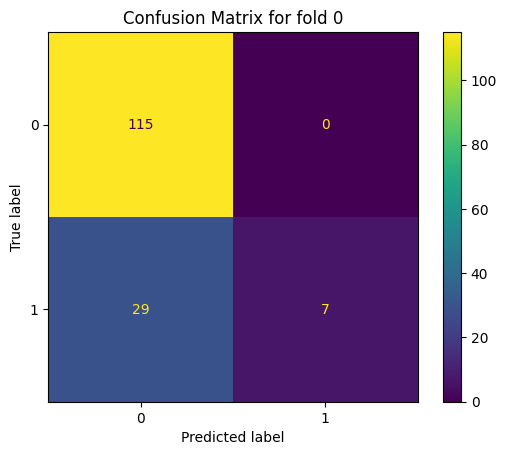

ROC AUC for fold 0: 0.5972222222222222
Precision-Recall AUC for fold 0: 0.6965713373432906


Performance Metrics Summary for fold 1:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.820144  1.000000  0.901186  0.833333    114.0
Class 1   1.000000  0.305556  0.468085  0.833333     36.0 



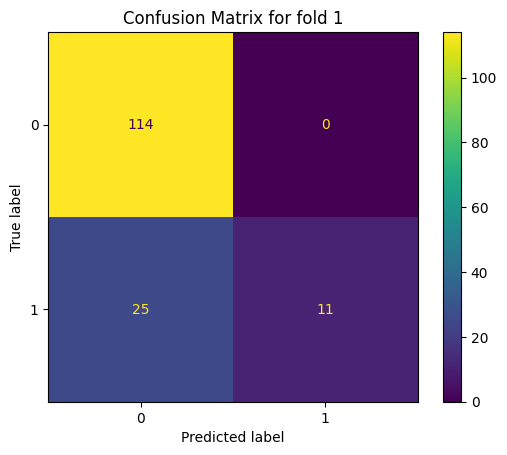

ROC AUC for fold 1: 0.6527777777777778
Precision-Recall AUC for fold 1: 0.7231030640381667


Performance Metrics Summary for fold 2:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.790210  0.991228  0.879377  0.793333    114.0
Class 1   0.857143  0.166667  0.279070  0.793333     36.0 



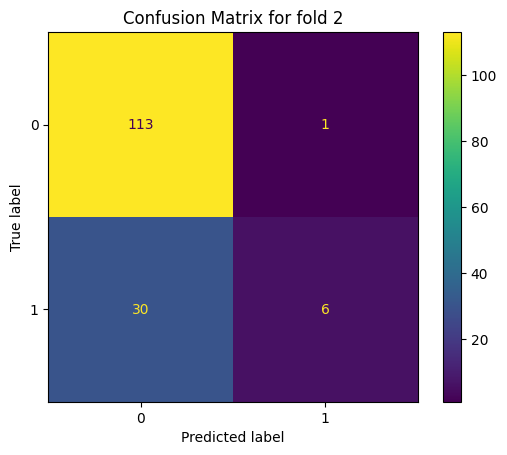

ROC AUC for fold 2: 0.5789473684210527
Precision-Recall AUC for fold 2: 0.7081533399657252


Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.94      1.00      0.97       343
           1       1.00      0.81      0.90       108

    accuracy                           0.96       451
   macro avg       0.97      0.91      0.93       451
weighted avg       0.96      0.96      0.95       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.2840284928808861
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.99      1.00      1.00       343
           1       1.00      0.98      0.99       108

    accuracy                           1.00       451
   macro avg       1.00      0.99      0.99       451
weighted avg    

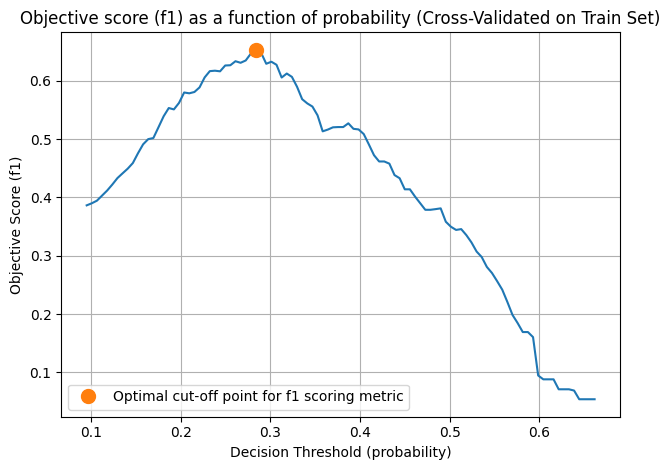



Evaluating model performance after fitting to entire training dataset:


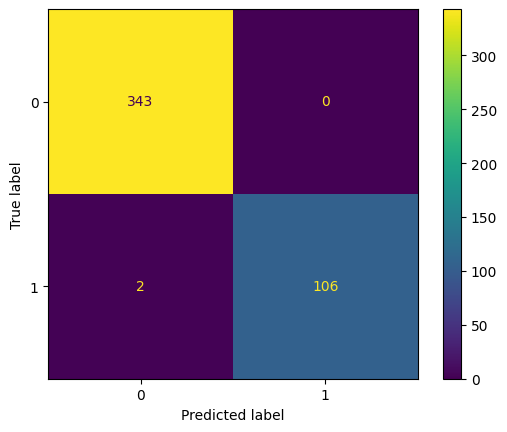

Model Accuracy Score: 0.9955654101995566


Classification report for training data:
               precision    recall  f1-score   support

           0       0.99      1.00      1.00       343
           1       1.00      0.98      0.99       108

    accuracy                           1.00       451
   macro avg       1.00      0.99      0.99       451
weighted avg       1.00      1.00      1.00       451

Precision-Recall and ROC Curves for the Training Set:


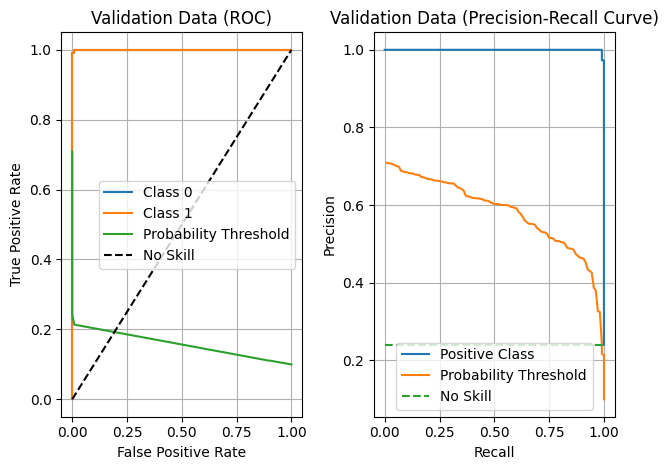

ROC AUC for Class 0 (computed with auc()): 0.9999190152251377
ROC AUC for Class 1 (computed with auc()): 0.9999190152251377
ROC AUC for Class 0 (computed with roc_auc_score()): 0.9999190152251377
ROC AUC for Class 1 (computed with roc_auc_score()): 0.9999190152251377
Precision-Recall AUC for Class 1 (computed with auc()): 0.9997486122486124


Evaluating model performance against the Testing Set:


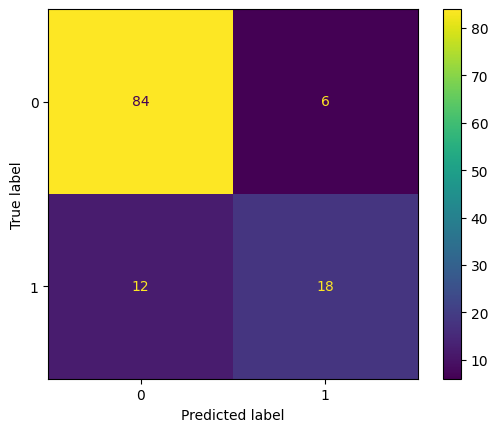

Model Accuracy Score: 0.85


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.88      0.93      0.90        90
           1       0.75      0.60      0.67        30

    accuracy                           0.85       120
   macro avg       0.81      0.77      0.78       120
weighted avg       0.84      0.85      0.84       120

Precision-Recall and ROC Curves for the Testing Set:


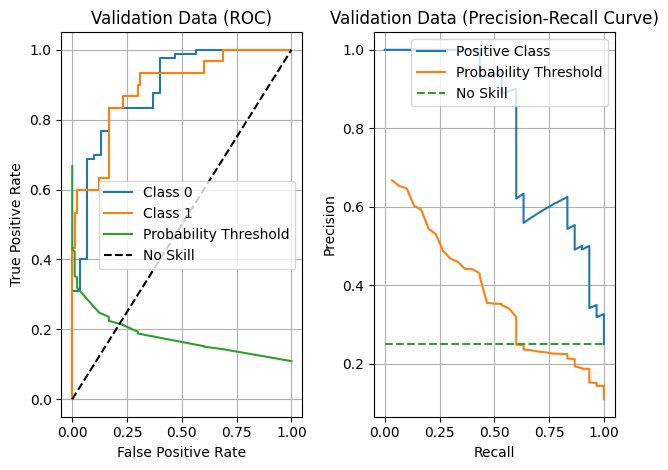

ROC AUC for Class 0 (computed with auc()): 0.8888888888888888
ROC AUC for Class 1 (computed with auc()): 0.888888888888889
ROC AUC for Class 0 (computed with roc_auc_score()): 0.888888888888889
ROC AUC for Class 1 (computed with roc_auc_score()): 0.888888888888889
Precision-Recall AUC for Class 1 (computed with auc()): 0.799681671471922


Evaluating predictor importance for testing and training data...
Top important features from GradientBoostingClassifier Model:
      Feature Labels  Feature Importance  Feature Indices
0     fr_amidine_1.0            0.015691              382
1          MACCS_146            0.012219              627
2          MACCS_143            0.011312              624
3           MACCS_86            0.008929              567
4           MACCS_74            0.008635              555
5          MACCS_148            0.008378              629
6   EState_VSA10_0.0            0.008375               45
7         fr_ArN_0.0            0.007943              312
8         

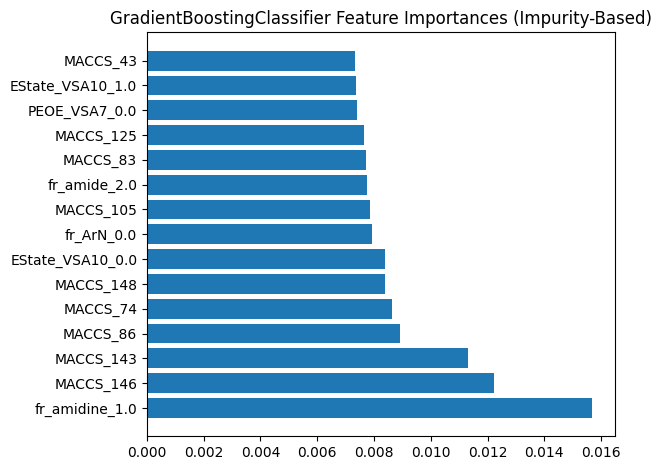



Top important features from GradientBoostingClassifier Model in Training Set (permutation_importance):
      Feature Labels  Feature Importance  Feature Indices
0           MACCS_43            0.014514              525
1          MACCS_146            0.011240              627
2   EState_VSA10_0.0            0.009990               45
3     fr_amidine_1.0            0.009007              382
4          MACCS_143            0.008727              624
5           MACCS_64            0.007882              545
6    EState_VSA4_1.0            0.005927               58
7      PEOE_VSA9_2.0            0.005502              227
8          MACCS_141            0.005367              622
9           MACCS_85            0.005030              566
10  EState_VSA10_1.0            0.004981               46
11          MACCS_86            0.004687              567
12         MACCS_140            0.004655              621
13          MACCS_80            0.004490              561
14         MACCS_126     

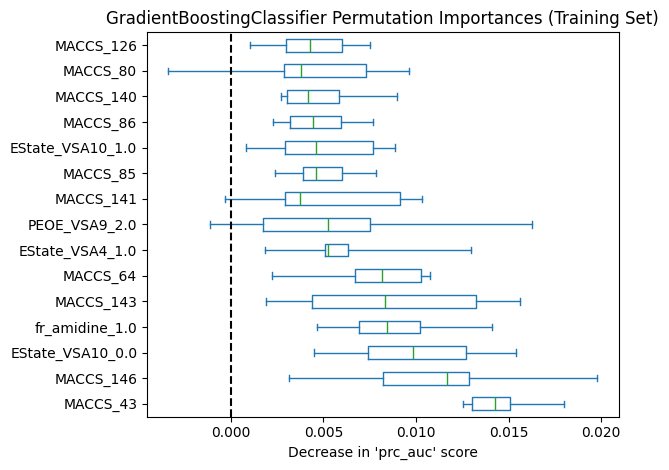



Top important features from GradientBoostingClassifier Model in Test Set (permutation_importance):
                 Feature Labels  Feature Importance  Feature Indices
0              EState_VSA10_0.0            0.019657               45
1                fr_amidine_1.0            0.013548              382
2                     MACCS_121            0.012719              602
3                      MACCS_87            0.012202              568
4                      MACCS_92            0.009695              573
5                      MACCS_76            0.009512              557
6                      MACCS_83            0.008629              564
7                     MACCS_133            0.008139              614
8                 PEOE_VSA9_2.0            0.007502              227
9         MaxAbsEStateIndex_1.0            0.006981              106
10  NumAliphaticCarbocycles_0.0            0.006860              144
11                RingCount_0.0            0.006738              228
12

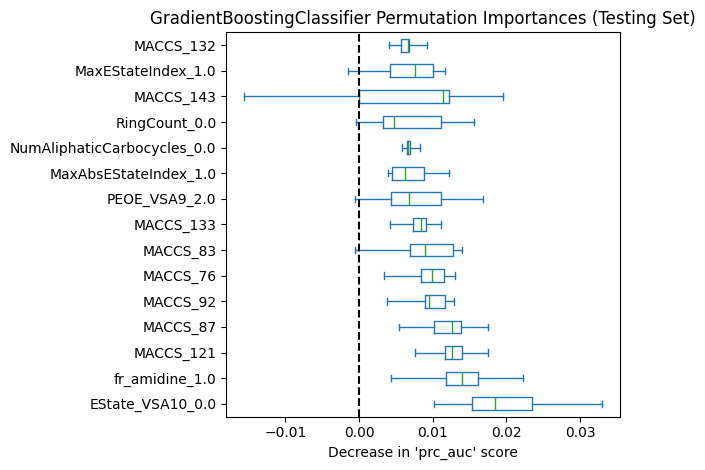

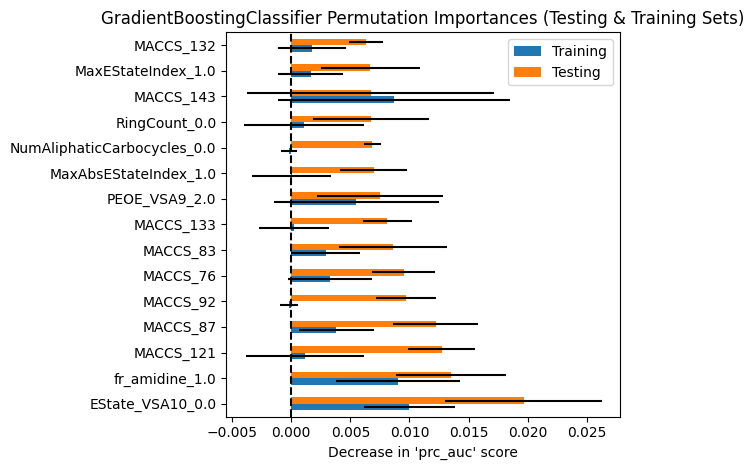

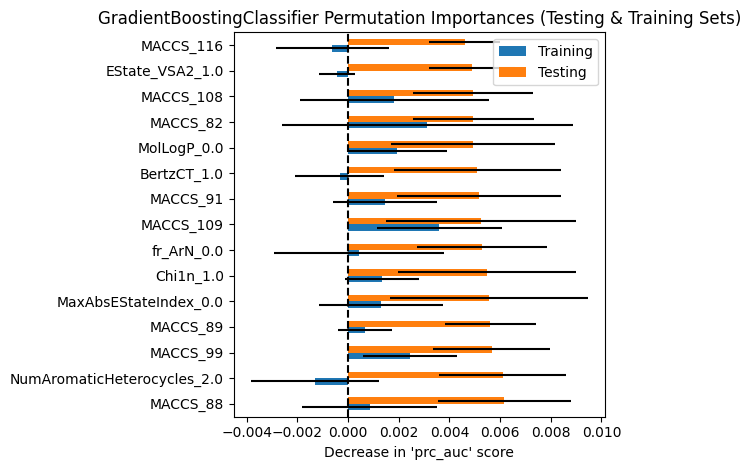

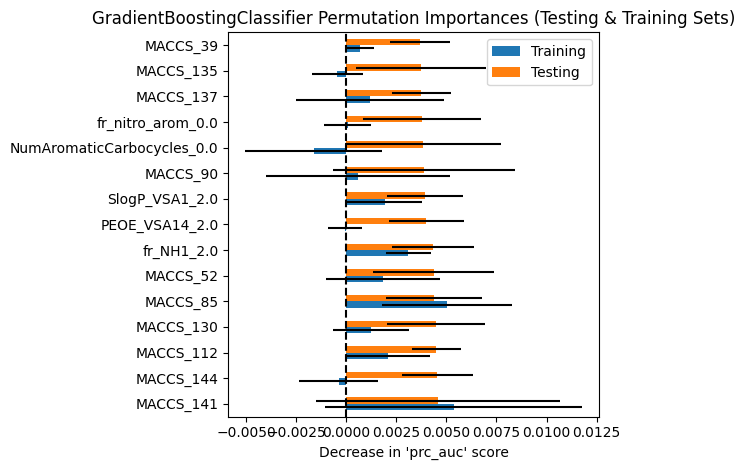

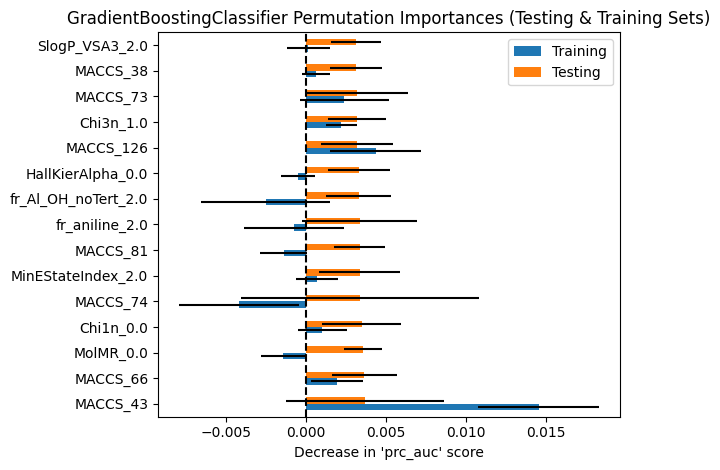

...

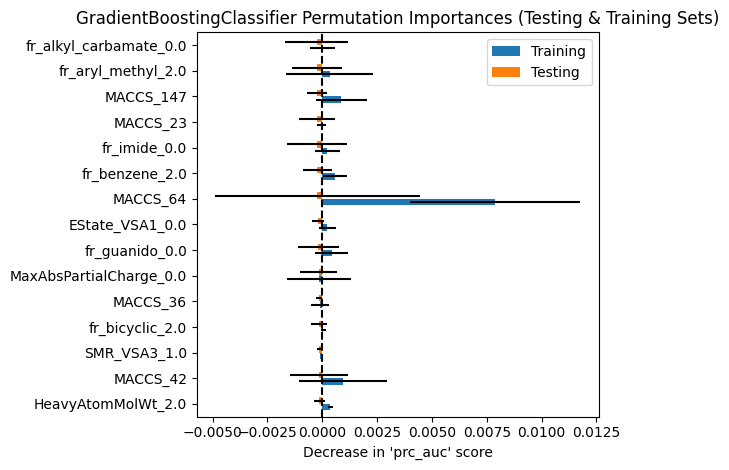

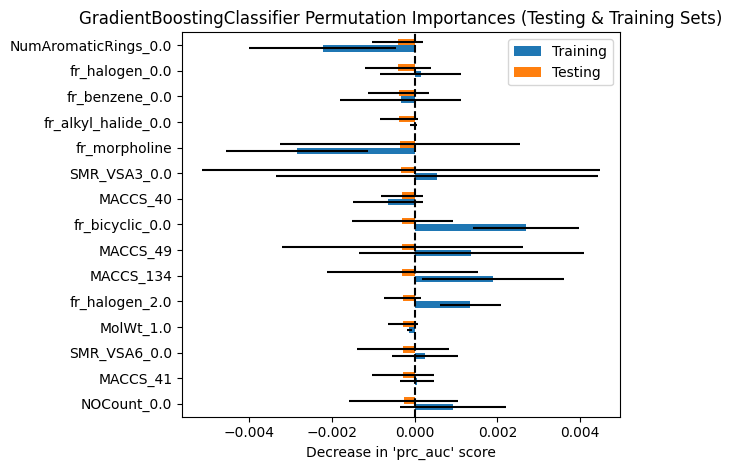

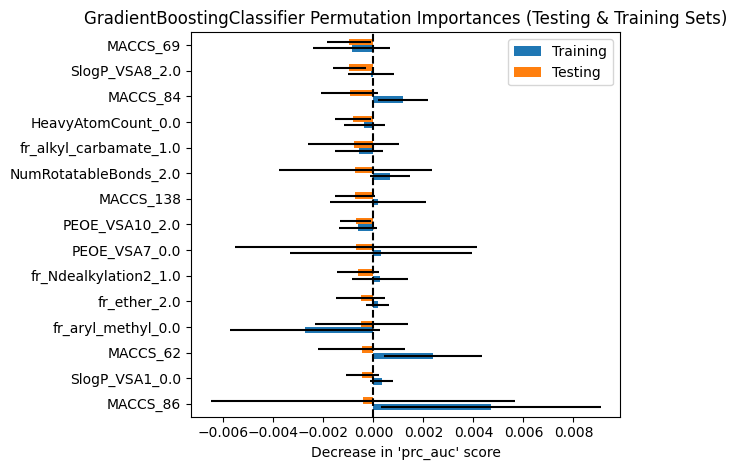

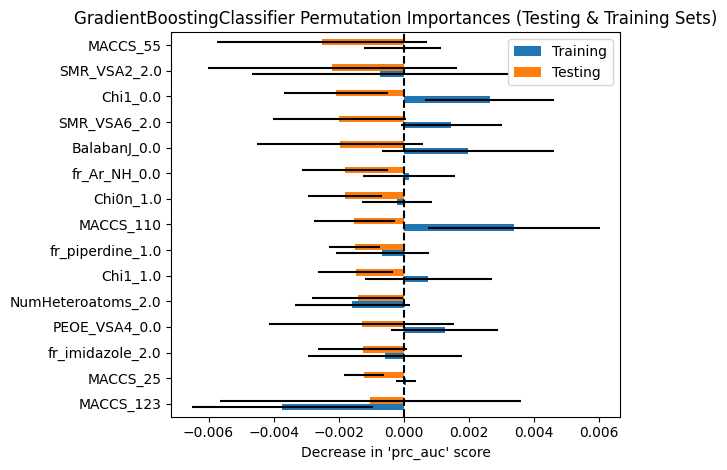

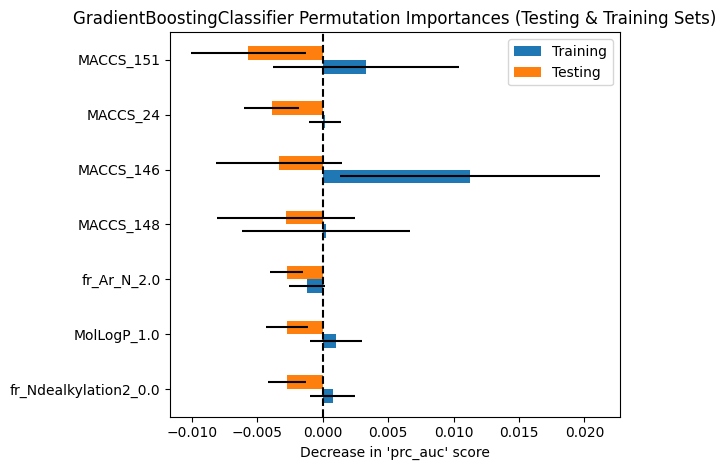



Removing unimportant features from permutation importance analysis and reevaluating model performance...
Number of important features: 507
Executing probability threshold tuning on the important TRAINING predictors:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.95      1.00      0.98       343
           1       1.00      0.84      0.91       108

    accuracy                           0.96       451
   macro avg       0.98      0.92      0.95       451
weighted avg       0.96      0.96      0.96       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.26056740982088555
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.99      1.00      1.00       343
           1       1.00      0.98      0.99       108

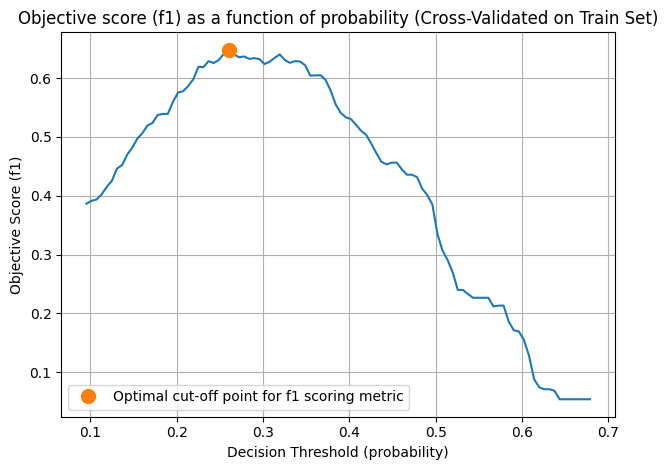



Evaluating model performance against the Testing Set:


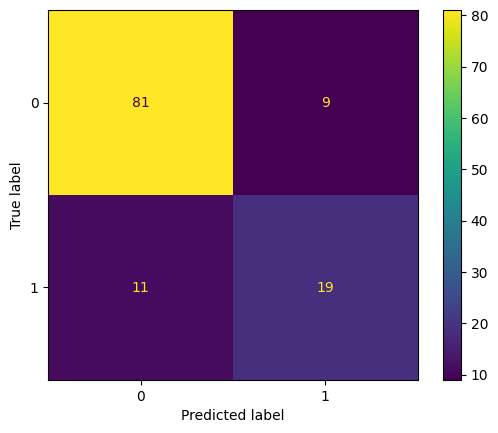

Model Accuracy Score: 0.8333333333333334


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.88      0.90      0.89        90
           1       0.68      0.63      0.66        30

    accuracy                           0.83       120
   macro avg       0.78      0.77      0.77       120
weighted avg       0.83      0.83      0.83       120

Precision-Recall and ROC Curves for the Testing Set:


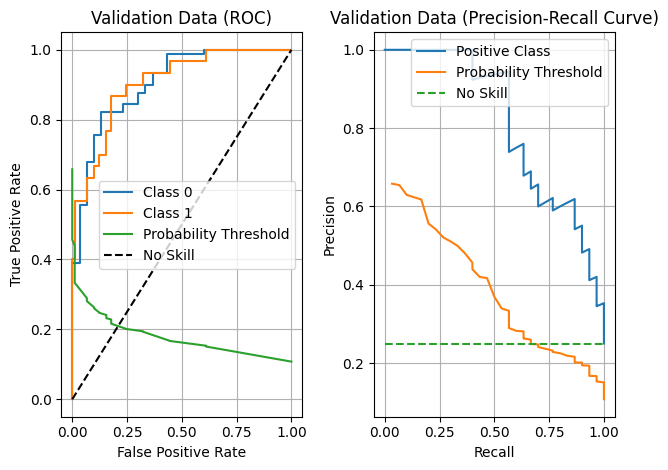

ROC AUC for Class 0 (computed with auc()): 0.904074074074074
ROC AUC for Class 1 (computed with auc()): 0.9040740740740741
ROC AUC for Class 0 (computed with roc_auc_score()): 0.9040740740740741
ROC AUC for Class 1 (computed with roc_auc_score()): 0.9040740740740741
Precision-Recall AUC for Class 1 (computed with auc()): 0.8114215106760984




In [ ]:
# Specify a parameter grid for selecting tuning parameters
param_grid = {
  'learning_rate': [0.01, 0.1, 1],
  'n_estimators': [10, 50, 100],
  'max_depth': [3, 5, 10],
  'min_impurity_decrease': [0.05, 0.1],
  'max_leaf_nodes': [10, 25, 50],
  'max_features': [10, 'sqrt', 'log2'],
  'random_state': [random_state]
   }

# Step 5 - Build the Gradient Boosting Classifier model. Use SciKit
# GradientBoostingClassifier() Object and use the search_best_auc() helper
# method to find a model which will score best for ROC/PR AUC against the TEST
# data and also tune the probability threshold to a score for the minority
# DIA-positive TEST records.
print('Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:')
clf_gbm = search_best_auc(
            clf_type=GradientBoostingClassifier,
            X_train=ZX_train,
            Y_train=Y_train,
            param_grid=param_grid,
            folds=kf,
            auc_scorer='prc_auc',
            scorer='f1'
            )

print('Evaluating model performance after fitting to entire training dataset:')
# Step 6 - Predict training data (using default probability threshold of P>=0.5)
y_pred = clf_gbm.predict(ZX_train)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the training data.
score_logit_model(Y_train, y_pred)
print("Classification report for training data:\n", classification_report(Y_train, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the training data
print('Precision-Recall and ROC Curves for the Training Set:')
plot_roc_pr_binary(model=clf_gbm, X=ZX_train, Y=Y_train)

print('Evaluating model performance against the Testing Set:')
# Step 6 - Predict test data
y_pred = clf_gbm.predict(ZX_test)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the test data.
score_logit_model(Y_test, y_pred)
print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the test data.
print('Precision-Recall and ROC Curves for the Testing Set:')
plot_roc_pr_binary(model=clf_gbm, X=ZX_test, Y=Y_test)

# Analyze which records the model misclassified for each class
misclassified_records.at['GBM', 'Class 0 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 0)
misclassified_records.at['GBM', 'Class 0 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 0))[0])
misclassified_records.at['GBM', 'Class 1 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 1)
misclassified_records.at['GBM', 'Class 1 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 1))[0])

# Evaluate predictor importance with the report_feature_importance() helper
# method
print('Evaluating predictor importance for testing and training data...')
importance_mean, importance_std, _, importance_mean_test, _, _ = report_feature_importance(
                          model=clf_gbm,
                          X_train=ZX_train,
                          Y_train=Y_train,
                          X_test=ZX_test,
                          Y_test=Y_test,
                          labels=labels,
                          scoring='prc_auc',
                          num_features_to_rank=15
                          )

# Extract indices of top 15 importance train features and update the count for
# corresponding entries in our dict to track number of times each features has
# appeared in an estimators top 15 importance predictors
top_pred_train_idx = importance_mean.argsort()[-15:]
for idx in top_pred_train_idx :
  top_predictor_count_train.at[labels[idx], 'Top 15 Count'] += 1
top_pred_test_idx = importance_mean_test.argsort()[-15:]
for idx in top_pred_test_idx :
  top_predictor_count_test.at[labels[idx], 'Top 15 Count'] += 1

# Optionally remove features which are deemed hurtful to the model via
# permutation score analysis (negative scores) and reevaluate model performance
if reeval_imp_features :
  print('Removing unimportant features from permutation importance analysis',
    'and reevaluating model performance...')
  important_idx = np.where((importance_mean > 0) | (importance_std > 0))[0]
  print(f"Number of important features: {len(important_idx)}")

  ZX_train_important = ZX_train[:,important_idx]
  ZX_test_important = ZX_test[:,important_idx]
  clf_gbm_important = copy.deepcopy(clf_gbm.estimator_)
  clf_gbm_important.fit(ZX_train_important, Y_train)
  print('Executing probability threshold tuning on the important TRAINING predictors:')
  clf_gbm_important = tune_proba_thresh(
                        model=clf_gbm_important,
                        X_train=ZX_train_important,
                        Y_train=Y_train,
                        folds=kf,
                        scorer='f1'
                        )

  print('Evaluating model performance against the Testing Set:')
  # Step 6 - Predict test data
  y_pred = clf_gbm_important.predict(ZX_test_important)

  # Step 7 - Evaluate the model performance; report model accuracy score.
  # Visualize the model performance with a confusion matrix. Print the
  # Classification report for the test data.
  score_logit_model(Y_test, y_pred)
  print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

  # Plot the ROC for the model using the helper function plot_roc_pr_binary()
  # This helper function will also compute and print AUC for the test data.
  print('Precision-Recall and ROC Curves for the Testing Set:')
  plot_roc_pr_binary(model=clf_gbm_important, X=ZX_test_important, Y=Y_test)

We additionally evaluate a bagged tree classifier model to predict DIA positive drugs from the testing/training data. The following cell trains and evaluates this model against the training **AND** test datasets. The sklearn TunedClassifierCV() is used to tune the prediction probability threshold to obtain a best given arbitrary (F-score, precision, accuracy, etc.) score for the minority DIA-positive class records in the data.

Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:
Executing search for best prc_auc score for classifier of type:  BaggingClassifier
Parameter Grid: {'estimator': [DecisionTreeClassifier(max_features='log2', max_leaf_nodes=50)], 'bootstrap': [True, False], 'n_estimators': [10, 50, 100], 'max_samples': [0.5, 0.7, 1.0], 'max_features': [0.5, 0.7, 1.0], 'random_state': [0]}
Best prc_auc score: 0.68732586819239
Best parameters: {'bootstrap': True, 'estimator': DecisionTreeClassifier(max_features='log2', max_leaf_nodes=50), 'max_features': 0.7, 'max_samples': 0.5, 'n_estimators': 100, 'random_state': 0}
Performance Metrics Summary for fold 0:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.787671  1.000000  0.881226  0.794702    115.0
Class 1   1.000000  0.138889  0.243902  0.794702     36.0 



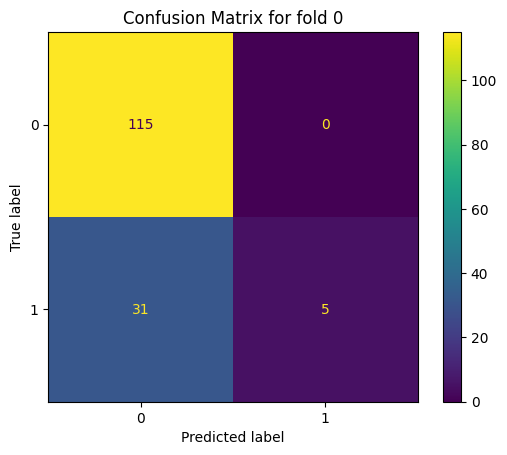

ROC AUC for fold 0: 0.5694444444444444
Precision-Recall AUC for fold 0: 0.6531918205730073


Performance Metrics Summary for fold 1:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.826087  1.000000  0.904762      0.84    114.0
Class 1   1.000000  0.333333  0.500000      0.84     36.0 



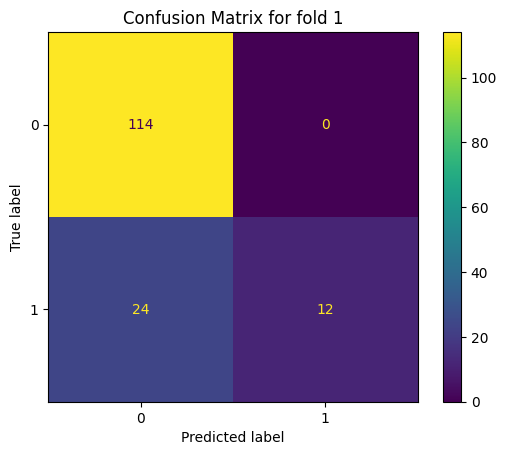

ROC AUC for fold 1: 0.6666666666666666
Precision-Recall AUC for fold 1: 0.7359673212410073


Performance Metrics Summary for fold 2:
Classification Report: 
         Precision    Recall  F1 Score  Accuracy  Support
Class 0   0.790210  0.991228  0.879377  0.793333    114.0
Class 1   0.857143  0.166667  0.279070  0.793333     36.0 



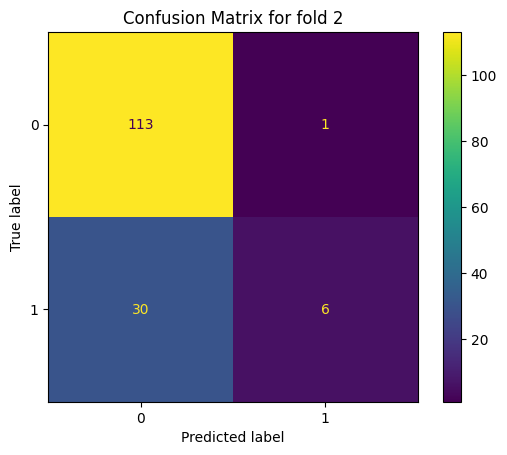

ROC AUC for fold 2: 0.5789473684210527
Precision-Recall AUC for fold 2: 0.6728184627631559


Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.92      1.00      0.96       343
           1       1.00      0.72      0.84       108

    accuracy                           0.93       451
   macro avg       0.96      0.86      0.90       451
weighted avg       0.94      0.93      0.93       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.31346115839159316
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.99      0.99      0.99       343
           1       0.95      0.98      0.97       108

    accuracy                           0.98       451
   macro avg       0.97      0.98      0.98       451
weighted avg   

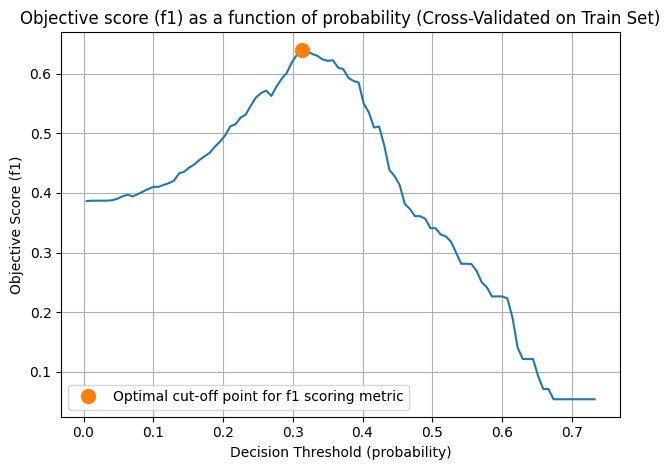



Evaluating model performance after fitting to entire training dataset:


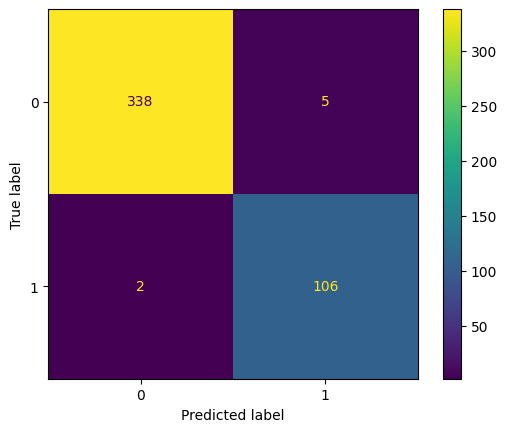

Model Accuracy Score: 0.9844789356984479


Classification report for training data:
               precision    recall  f1-score   support

           0       0.99      0.99      0.99       343
           1       0.95      0.98      0.97       108

    accuracy                           0.98       451
   macro avg       0.97      0.98      0.98       451
weighted avg       0.98      0.98      0.98       451

Precision-Recall and ROC Curves for the Training Set:


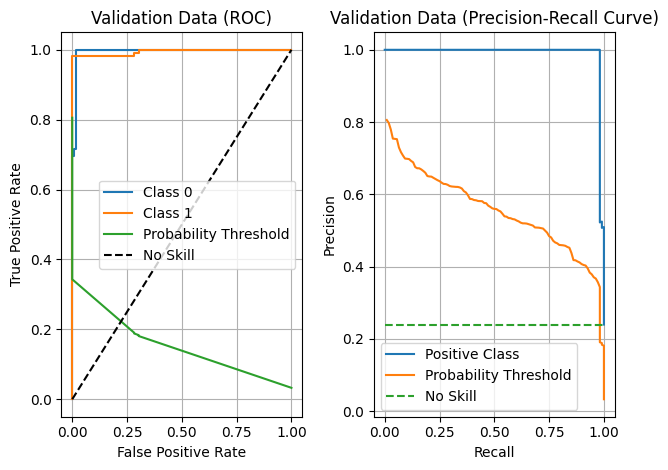

ROC AUC for Class 0 (computed with auc()): 0.9945740200842242
ROC AUC for Class 1 (computed with auc()): 0.9945740200842241
ROC AUC for Class 0 (computed with roc_auc_score()): 0.9945740200842241
ROC AUC for Class 1 (computed with roc_auc_score()): 0.9945740200842241
Precision-Recall AUC for Class 1 (computed with auc()): 0.9910334271231936


Evaluating model performance against the Testing Set:


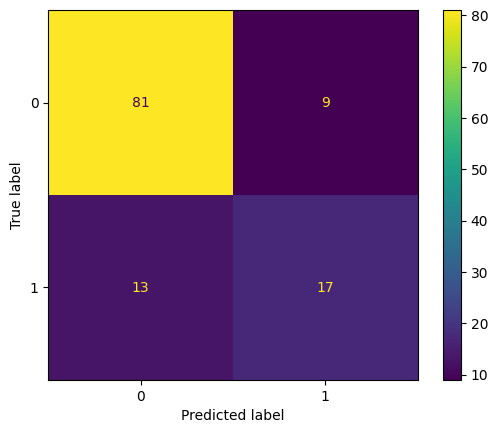

Model Accuracy Score: 0.8166666666666667


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.86      0.90      0.88        90
           1       0.65      0.57      0.61        30

    accuracy                           0.82       120
   macro avg       0.76      0.73      0.74       120
weighted avg       0.81      0.82      0.81       120

Precision-Recall and ROC Curves for the Testing Set:


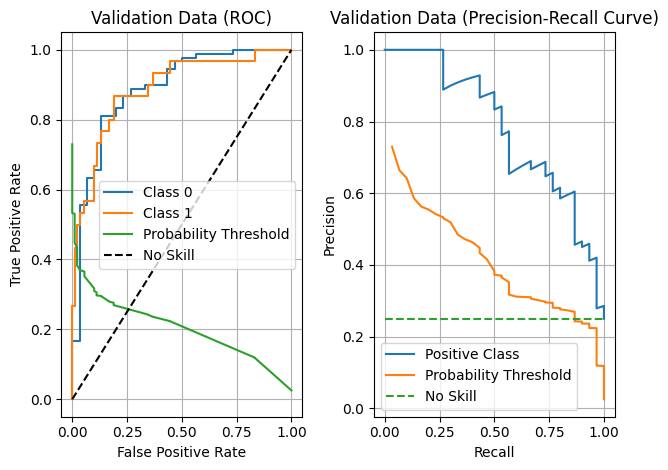

ROC AUC for Class 0 (computed with auc()): 0.8874074074074074
ROC AUC for Class 1 (computed with auc()): 0.8874074074074075
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8874074074074075
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8874074074074075
Precision-Recall AUC for Class 1 (computed with auc()): 0.7783193675209436


Evaluating predictor importance for testing and training data...
Top important features from BaggingClassifier Model in Training Set (permutation_importance):
   Feature Labels  Feature Importance  Feature Indices
0       MACCS_141            0.008642              622
1       MACCS_140            0.008531              621
2       MACCS_122            0.007340              603
3   PEOE_VSA7_0.0            0.007143              219
4    fr_Ar_NH_0.0            0.005781              321
5       MACCS_143            0.005037              624
6       MACCS_111            0.004840              592
7       MACCS_135            0.004693              616
8

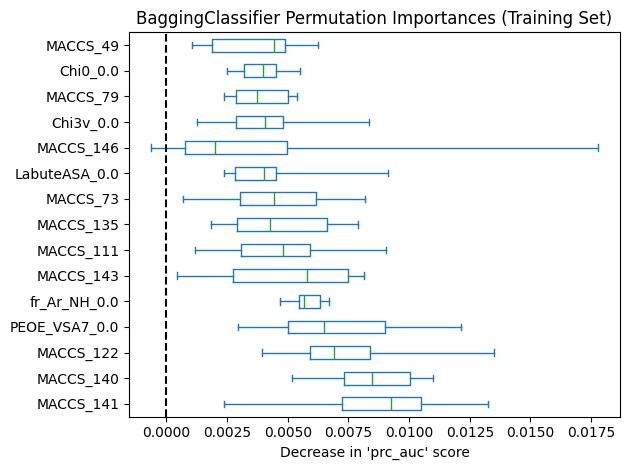



Top important features from BaggingClassifier Model in Test Set (permutation_importance):
        Feature Labels  Feature Importance  Feature Indices
0             MACCS_80            0.022995              561
1             MACCS_43            0.021662              525
2      SlogP_VSA12_2.0            0.014948              269
3            MACCS_108            0.013806              589
4   fr_aryl_methyl_0.0            0.013248              387
5   MinEStateIndex_0.0            0.013014              123
6            Chi2v_0.0            0.012156               27
7            MACCS_128            0.011912              609
8             MACCS_98            0.010581              579
9             MACCS_79            0.010432              560
10            MACCS_91            0.010357              572
11           MACCS_141            0.010247              622
12    EState_VSA10_1.0            0.010235               46
13  MinEStateIndex_1.0            0.009767              124
14      

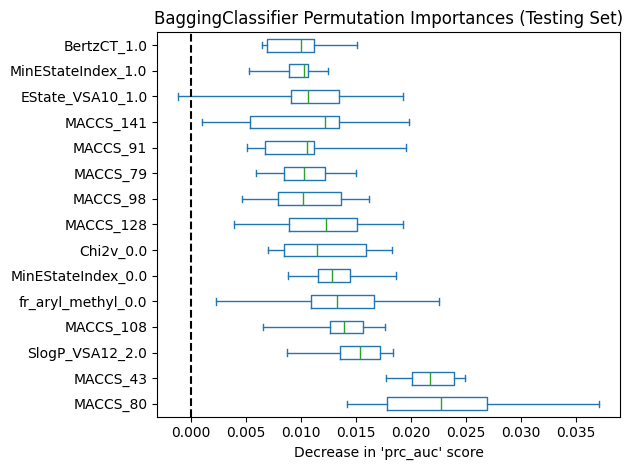

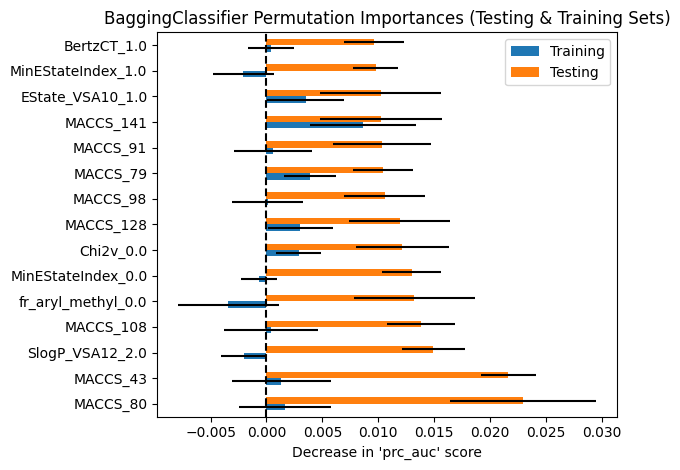

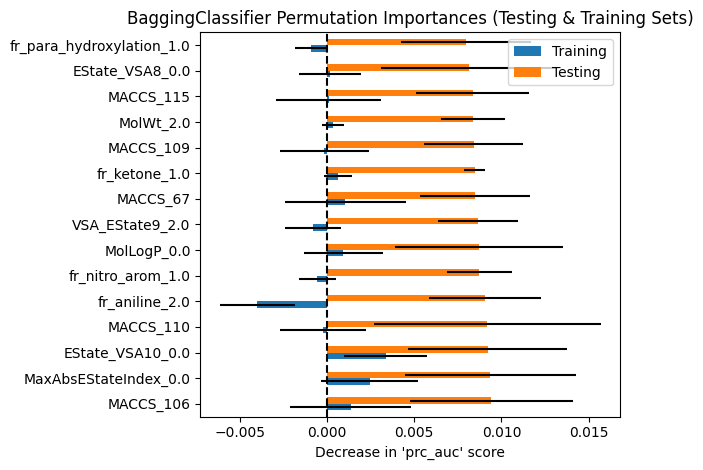

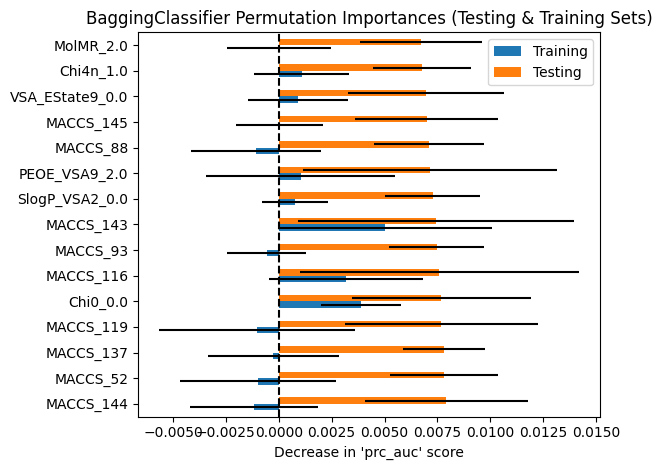

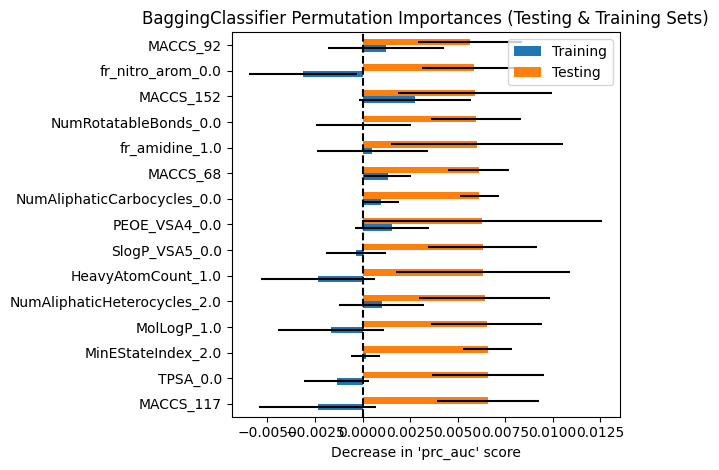

...

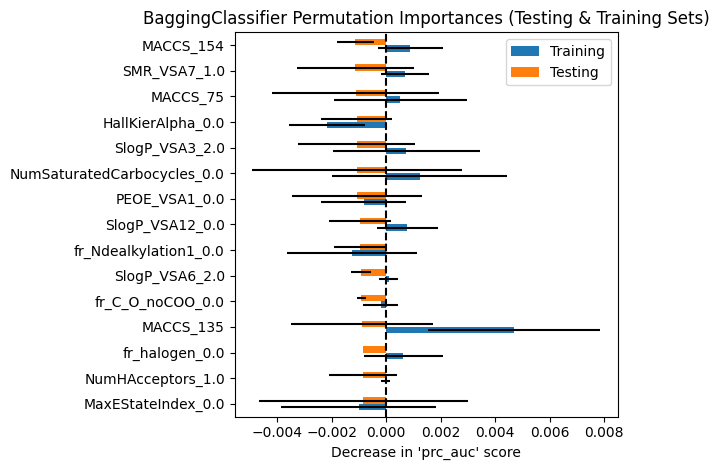

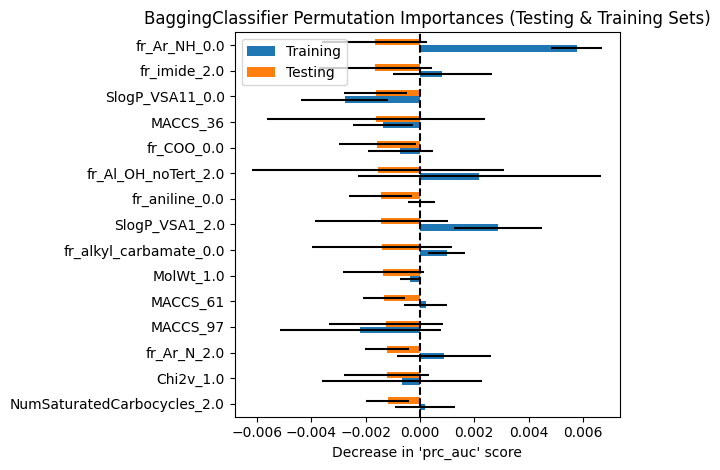

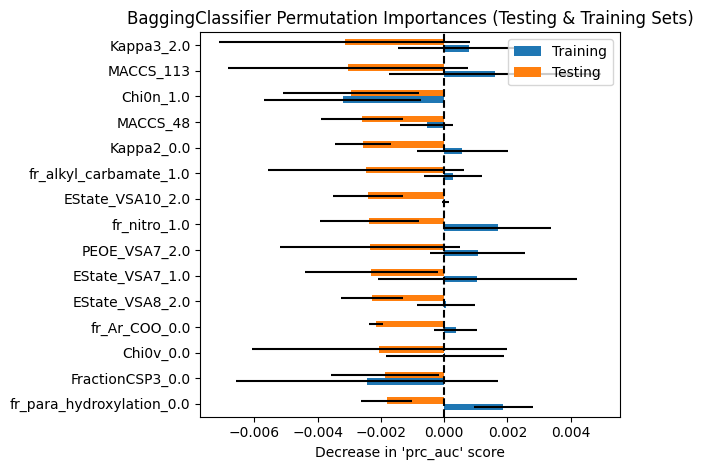

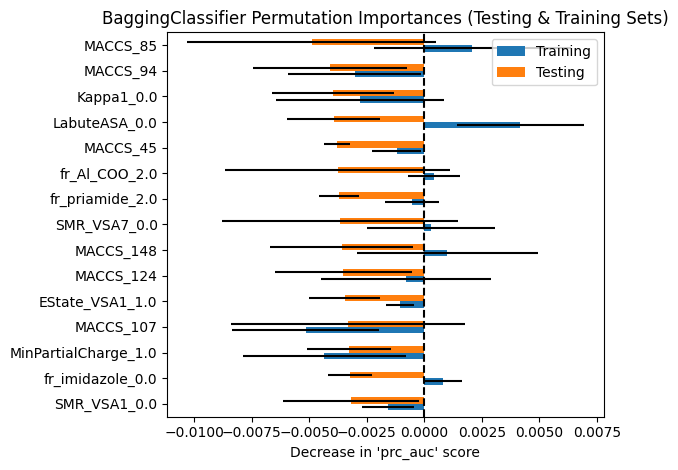

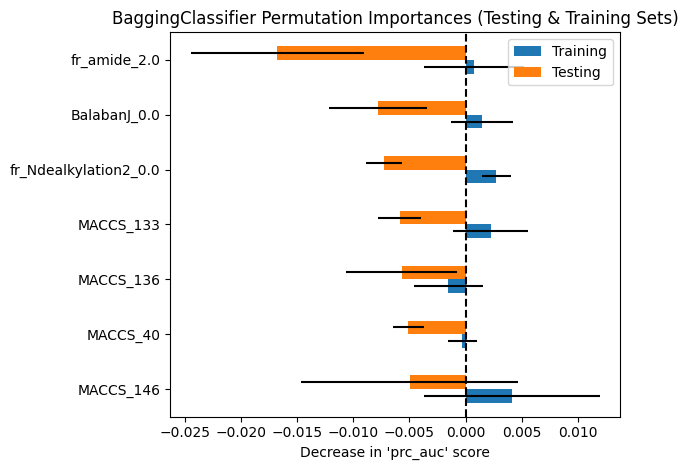



Removing unimportant features from permutation importance analysis and reevaluating model performance...
Number of important features: 525
Executing probability threshold tuning on the important TRAINING predictors:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.92      1.00      0.96       343
           1       1.00      0.72      0.84       108

    accuracy                           0.93       451
   macro avg       0.96      0.86      0.90       451
weighted avg       0.94      0.93      0.93       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.3280444589080952
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.99      0.99      0.99       343
           1       0.98      0.97      0.98       108


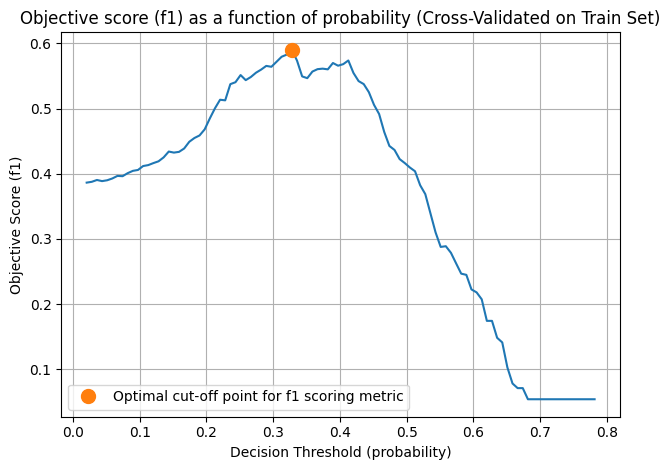



Evaluating model performance against the Testing Set:


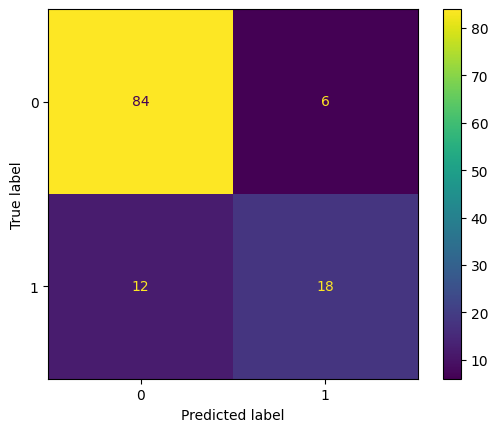

Model Accuracy Score: 0.85


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.88      0.93      0.90        90
           1       0.75      0.60      0.67        30

    accuracy                           0.85       120
   macro avg       0.81      0.77      0.78       120
weighted avg       0.84      0.85      0.84       120

Precision-Recall and ROC Curves for the Testing Set:


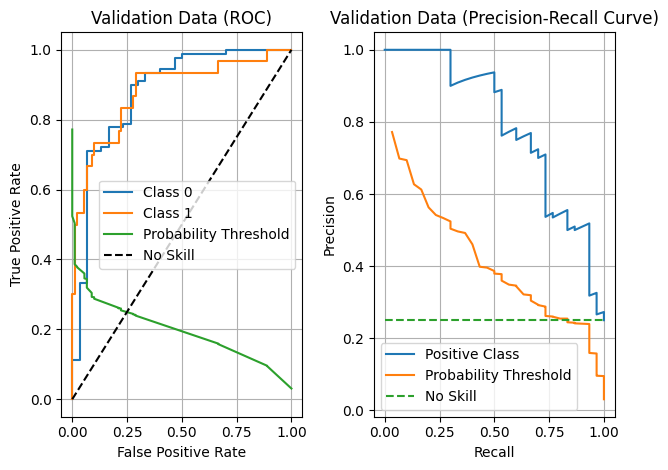

ROC AUC for Class 0 (computed with auc()): 0.8803703703703704
ROC AUC for Class 1 (computed with auc()): 0.8803703703703704
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8803703703703704
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8803703703703704
Precision-Recall AUC for Class 1 (computed with auc()): 0.788378679355738




In [ ]:
# Specify a parameter grid for selecting tuning parameters
param_grid = {
  'estimator' : [DecisionTreeClassifier(max_features='log2', max_leaf_nodes=50)],
  'bootstrap': [True, False],
  'n_estimators': [10, 50, 100],
  'max_samples' : [0.5, 0.7, 1.0],
  'max_features' : [0.5, 0.7, 1.0],
  'random_state': [random_state]
   }

# Step 5 - Build the Bagged Tree Classifier model. Use SciKit
# BaggingClassifier() Object and use the search_best_auc() helper method to find
# a model which will score best for ROC/PR AUC against the TEST data and also
# tune the probability threshold to maximize a score for the minority
# DIA-positive TEST records.
print('Executing probability threshold tuning on the TRAINING dataset and searching for best hyperparameters:')
clf_bagged = search_best_auc(
              clf_type=BaggingClassifier,
              X_train=ZX_train,
              Y_train=Y_train,
              param_grid=param_grid,
              folds=kf,
              auc_scorer='prc_auc',
              scorer='f1'
              )

print('Evaluating model performance after fitting to entire training dataset:')
# Step 6 - Predict training data (using default probability threshold of P>=0.5)
y_pred = clf_bagged.predict(ZX_train)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the training data.
score_logit_model(Y_train, y_pred)
print("Classification report for training data:\n", classification_report(Y_train, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the training data
print('Precision-Recall and ROC Curves for the Training Set:')
plot_roc_pr_binary(model=clf_bagged, X=ZX_train, Y=Y_train)

print('Evaluating model performance against the Testing Set:')
# Step 6 - Predict test data (using default probability threshold of P>=0.5)
y_pred = clf_bagged.predict(ZX_test)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the test data.
score_logit_model(Y_test, y_pred)
print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the test data.
print('Precision-Recall and ROC Curves for the Testing Set:')
plot_roc_pr_binary(model=clf_bagged, X=ZX_test, Y=Y_test)

# Analyze which records the model misclassified for each class
misclassified_records.at['Bagged Tree', 'Class 0 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 0)
misclassified_records.at['Bagged Tree', 'Class 0 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 0))[0])
misclassified_records.at['Bagged Tree', 'Class 1 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 1)
misclassified_records.at['Bagged Tree', 'Class 1 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 1))[0])

# Evaluate predictor importance with the report_feature_importance() helper
# method
print('Evaluating predictor importance for testing and training data...')
importance_mean, importance_std, _, importance_mean_test, _, _ = report_feature_importance(
                          model=clf_bagged,
                          X_train=ZX_train,
                          Y_train=Y_train,
                          X_test=ZX_test,
                          Y_test=Y_test,
                          labels=labels,
                          scoring='prc_auc',
                          num_features_to_rank=15
                          )

# Extract indices of top 15 importance train features and update the count for
# corresponding entries in our dict to track number of times each features has
# appeared in an estimators top 15 importance predictors
top_pred_train_idx = importance_mean.argsort()[-15:]
for idx in top_pred_train_idx :
  top_predictor_count_train.at[labels[idx], 'Top 15 Count'] += 1
top_pred_test_idx = importance_mean_test.argsort()[-15:]
for idx in top_pred_test_idx :
  top_predictor_count_test.at[labels[idx], 'Top 15 Count'] += 1

# Optionally remove features which are deemed hurtful to the model via
# permutation score analysis (negative scores) and reevaluate model performance
if reeval_imp_features :
  print('Removing unimportant features from permutation importance analysis',
    'and reevaluating model performance...')
  important_idx = np.where((importance_mean > 0) | (importance_std > 0))[0]
  print(f"Number of important features: {len(important_idx)}")

  ZX_train_important = ZX_train[:,important_idx]
  ZX_test_important = ZX_test[:,important_idx]
  clf_bagged_important = copy.deepcopy(clf_bagged.estimator_)
  clf_bagged_important.fit(ZX_train_important, Y_train)
  print('Executing probability threshold tuning on the important TRAINING predictors:')
  clf_bagged_important = tune_proba_thresh(
                          model=clf_bagged_important,
                          X_train=ZX_train_important,
                          Y_train=Y_train,
                          folds=kf,
                          scorer='f1'
                          )

  print('Evaluating model performance against the Testing Set:')
  # Step 6 - Predict test data
  y_pred = clf_bagged_important.predict(ZX_test_important)

  # Step 7 - Evaluate the model performance; report model accuracy score.
  # Visualize the model performance with a confusion matrix. Print the
  # Classification report for the test data.
  score_logit_model(Y_test, y_pred)
  print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

  # Plot the ROC for the model using the helper function plot_roc_pr_binary()
  # This helper function will also compute and print AUC for the test data.
  print('Precision-Recall and ROC Curves for the Testing Set:')
  plot_roc_pr_binary(model=clf_bagged_important, X=ZX_test_important, Y=Y_test)

Finally, we evaluate an ensemble voting classifier model consisting of all models trained in this script (excluding the OneClassSVM) to predict DIA positive drugs from the testing/training data. The following cell trains and evaluates this model against the training AND test datasets.

Executing probability threshold tuning on the TRAINING dataset:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.98      1.00      0.99       343
           1       1.00      0.94      0.97       108

    accuracy                           0.98       451
   macro avg       0.99      0.97      0.98       451
weighted avg       0.98      0.98      0.98       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.29810116253061375
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg       1.00      1.00      1.00 

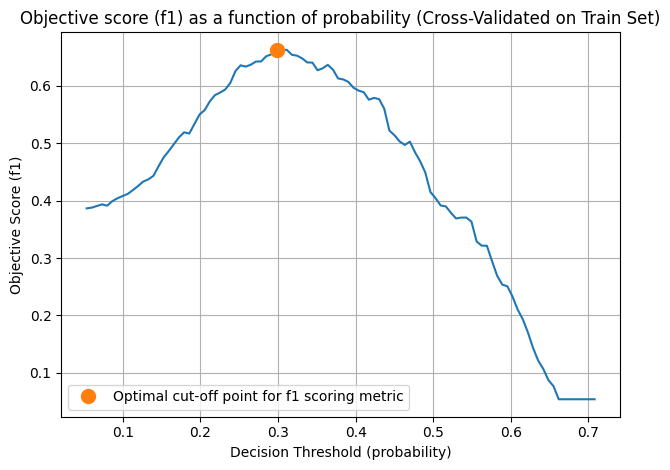



Evaluating model performance after fitting to entire training dataset:


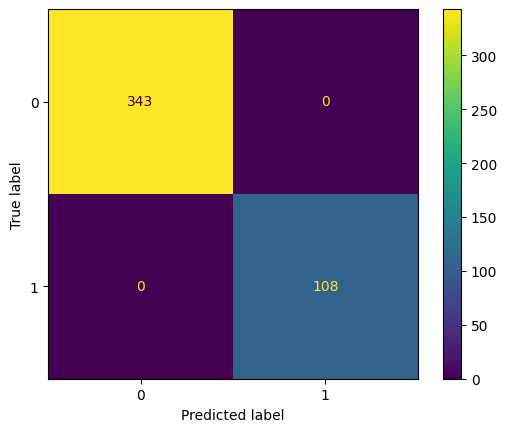

Model Accuracy Score: 1.0


Classification report for training data:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       343
           1       1.00      1.00      1.00       108

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg       1.00      1.00      1.00       451

Precision-Recall and ROC Curves for the Training Set:


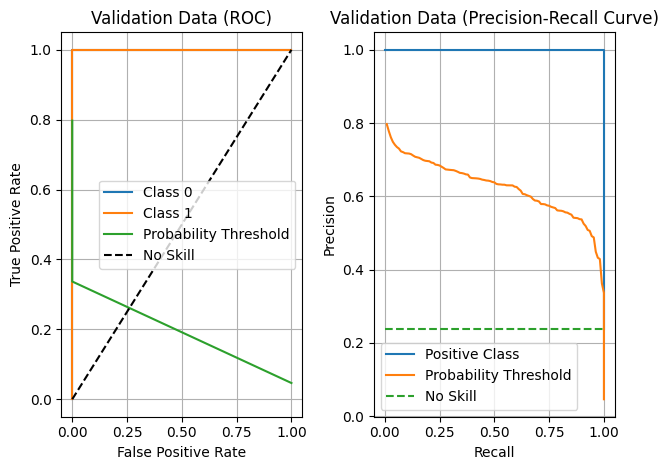

ROC AUC for Class 0 (computed with auc()): 1.0
ROC AUC for Class 1 (computed with auc()): 1.0
ROC AUC for Class 0 (computed with roc_auc_score()): 1.0
ROC AUC for Class 1 (computed with roc_auc_score()): 1.0
Precision-Recall AUC for Class 1 (computed with auc()): 1.0000000000000002


Evaluating model performance against the Testing Set:


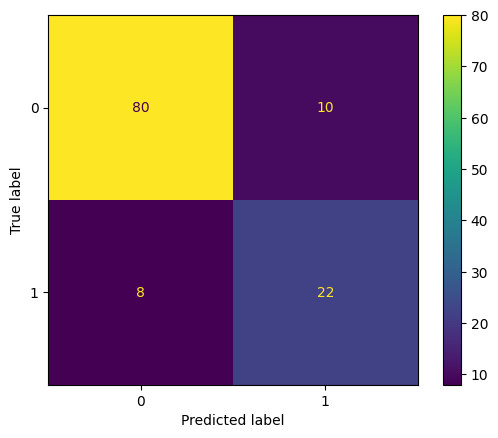

Model Accuracy Score: 0.85


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.91      0.89      0.90        90
           1       0.69      0.73      0.71        30

    accuracy                           0.85       120
   macro avg       0.80      0.81      0.80       120
weighted avg       0.85      0.85      0.85       120

Precision-Recall and ROC Curves for the Testing Set:


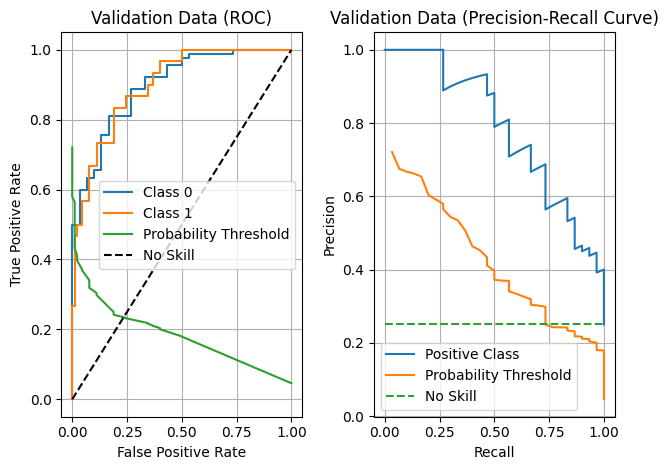

ROC AUC for Class 0 (computed with auc()): 0.8981481481481483
ROC AUC for Class 1 (computed with auc()): 0.8981481481481481
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8981481481481481
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8981481481481481
Precision-Recall AUC for Class 1 (computed with auc()): 0.7842063743751467


Evaluating predictor importance for testing and training data...
Top important features from VotingClassifier Model in Training Set (permutation_importance):
    Feature Labels  Feature Importance  Feature Indices
0        MACCS_146            0.013081              627
1        MACCS_143            0.011777              624
2         MACCS_43            0.006916              525
3         MACCS_64            0.005901              545
4        MACCS_141            0.005708              622
5         MACCS_87            0.005494              568
6         MACCS_85            0.005173              566
7         MACCS_86            0.004961           

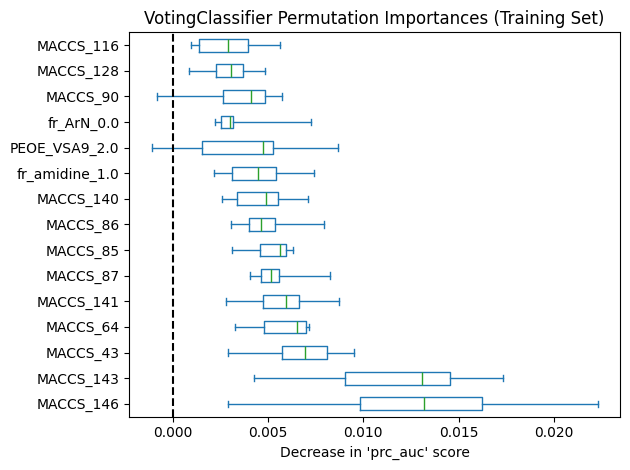



Top important features from VotingClassifier Model in Test Set (permutation_importance):
                 Feature Labels  Feature Importance  Feature Indices
0                     MACCS_143            0.016602              624
1              EState_VSA10_0.0            0.008250               45
2                     MACCS_109            0.008018              590
3                      MACCS_85            0.006907              566
4                      MACCS_80            0.006524              561
5                     MACCS_129            0.006377              610
6                      MACCS_91            0.006153              572
7   NumAliphaticCarbocycles_0.0            0.005959              144
8                     MACCS_121            0.005287              602
9         MaxAbsEStateIndex_0.0            0.005182              105
10               fr_amidine_1.0            0.005171              382
11             EState_VSA10_1.0            0.004677               46
12          

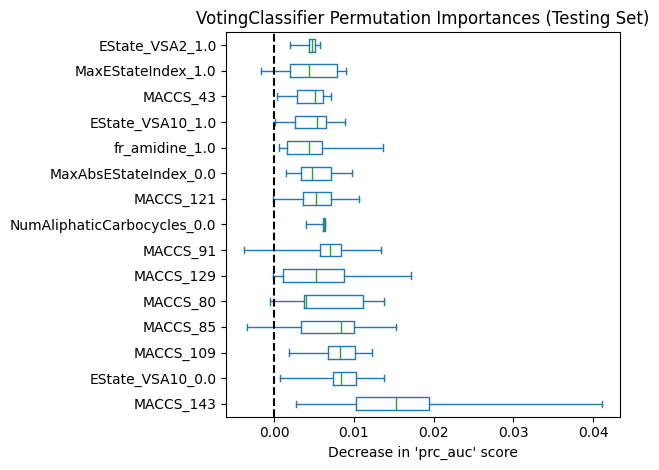

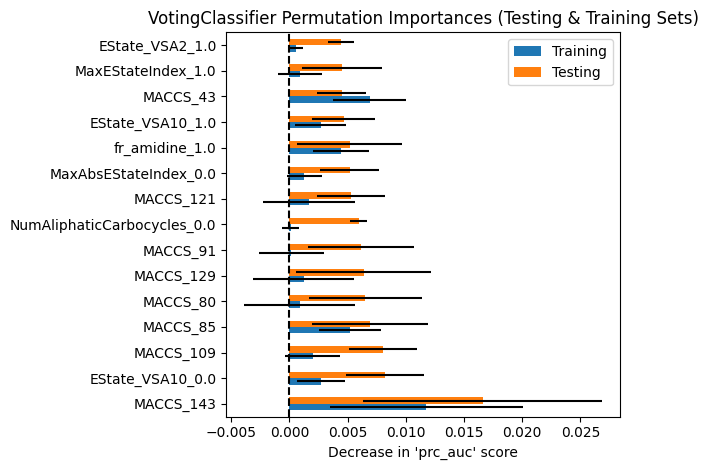

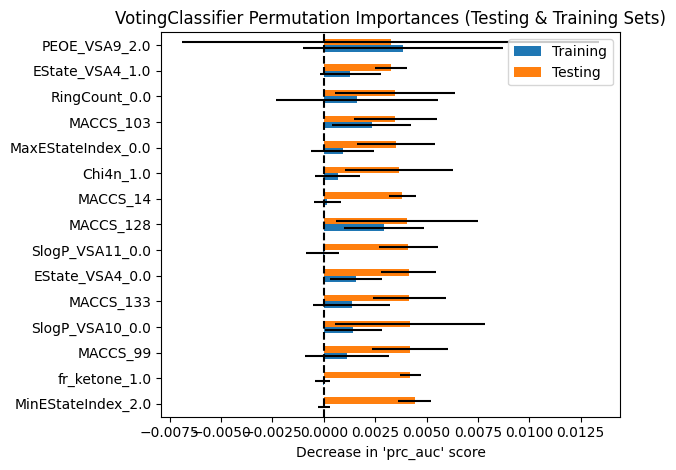

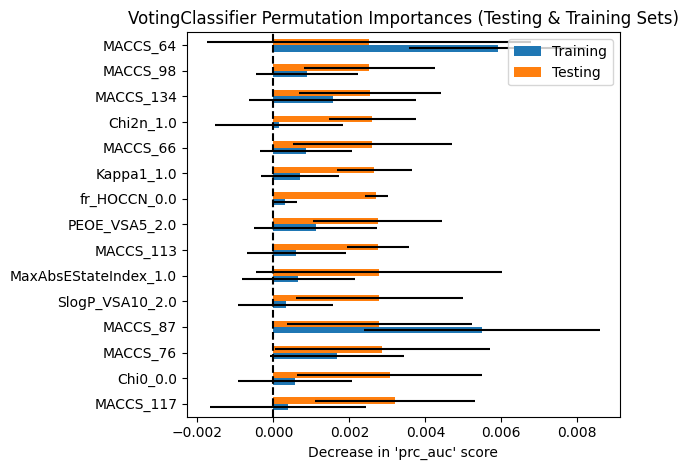

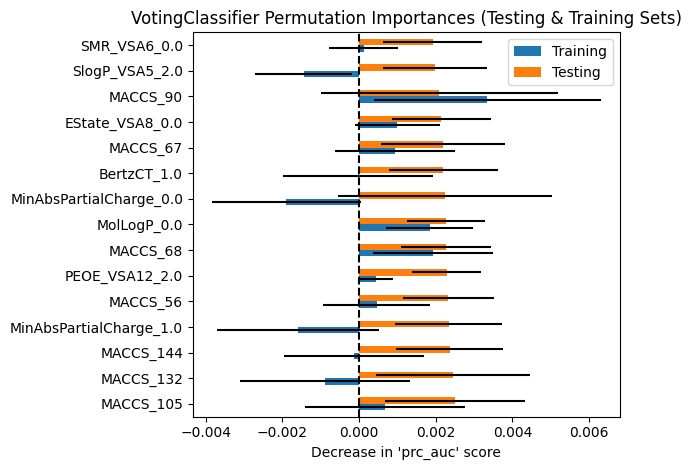

...

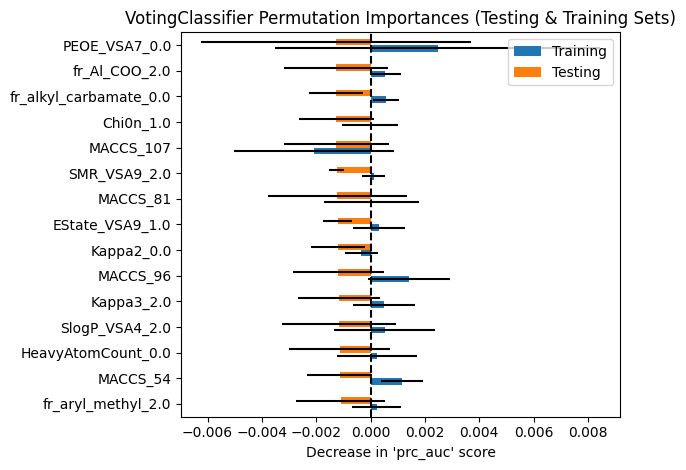

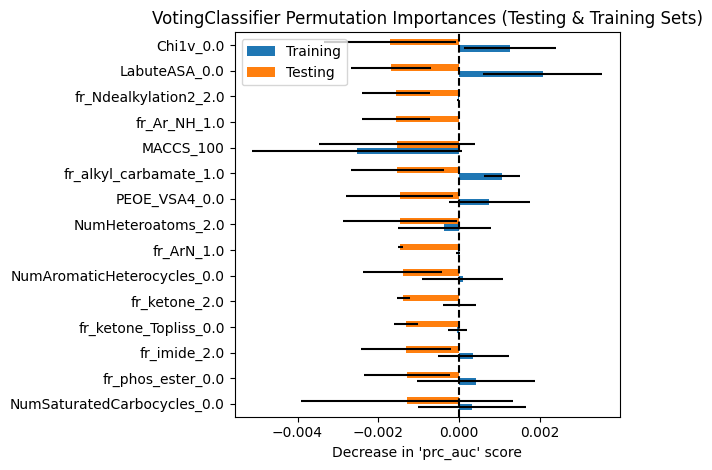

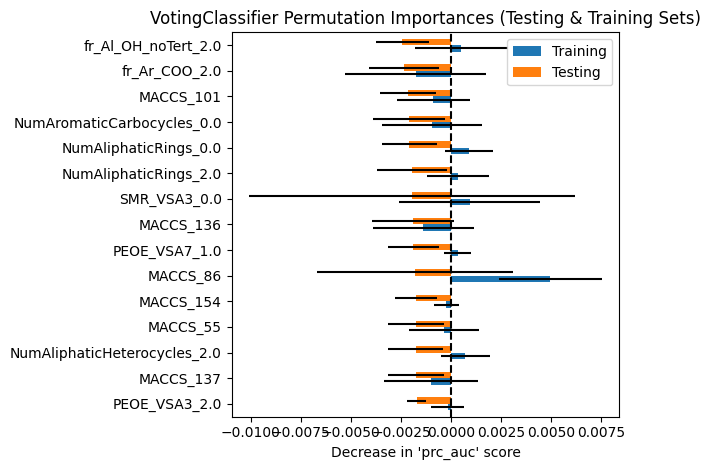

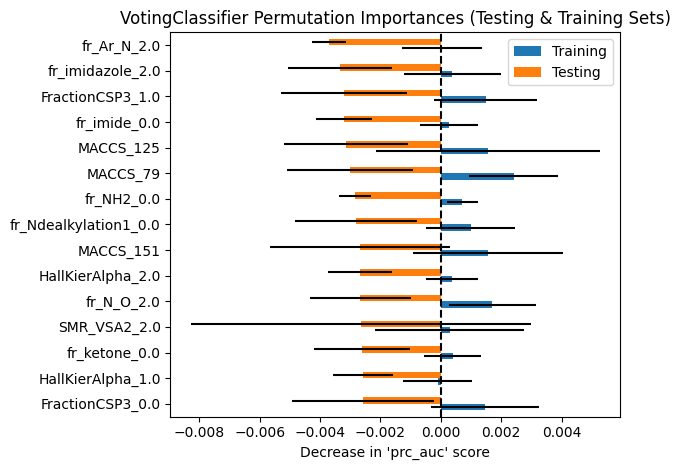

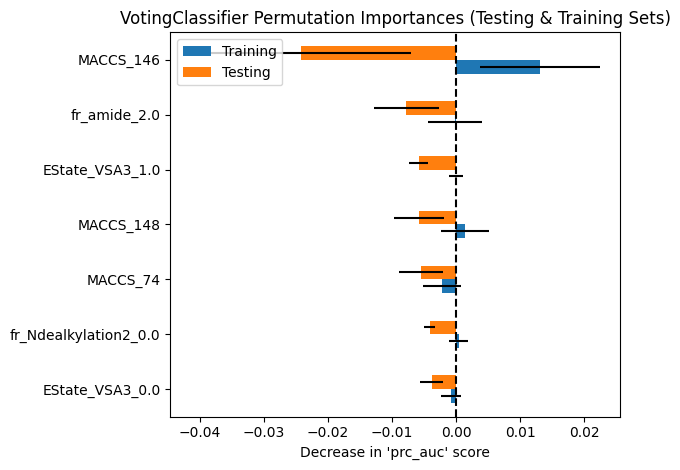



Removing unimportant features from permutation importance analysis and reevaluating model performance...
Number of important features: 601
Executing probability threshold tuning on the important TRAINING predictors:
Classification report for data pre-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       0.98      1.00      0.99       343
           1       1.00      0.94      0.97       108

    accuracy                           0.98       451
   macro avg       0.99      0.97      0.98       451
weighted avg       0.98      0.98      0.98       451

Tuning probability threshold for the model...
Best probability threshold (from cross-validation on training set): 0.30449893317383225
Classification report for data post-tuning (model fit to entire training set):
               precision    recall  f1-score   support

           0       1.00      0.99      1.00       343
           1       0.98      1.00      0.99       108

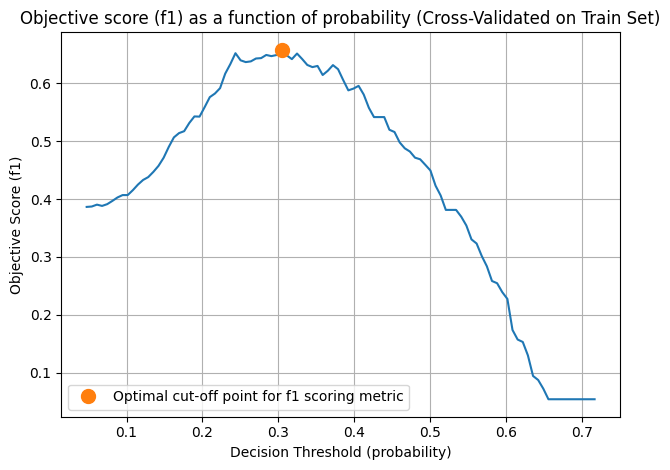



Evaluating model performance against the Testing Set:


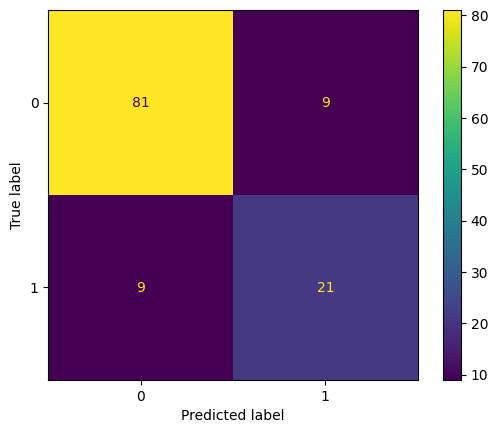

Model Accuracy Score: 0.85


Classification report for testing data:
               precision    recall  f1-score   support

           0       0.90      0.90      0.90        90
           1       0.70      0.70      0.70        30

    accuracy                           0.85       120
   macro avg       0.80      0.80      0.80       120
weighted avg       0.85      0.85      0.85       120

Precision-Recall and ROC Curves for the Testing Set:


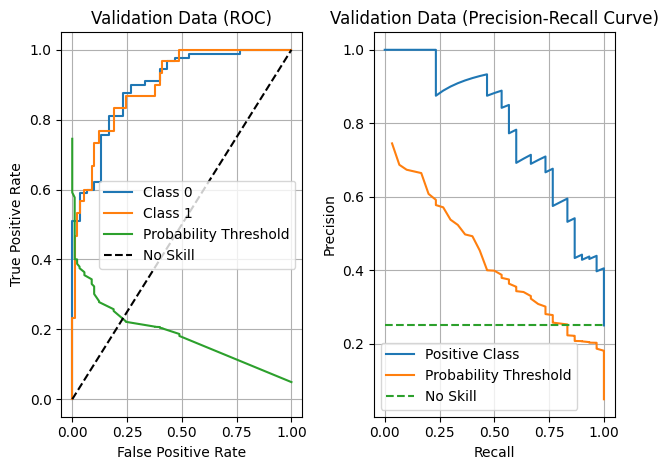

ROC AUC for Class 0 (computed with auc()): 0.8996296296296297
ROC AUC for Class 1 (computed with auc()): 0.8996296296296296
ROC AUC for Class 0 (computed with roc_auc_score()): 0.8996296296296296
ROC AUC for Class 1 (computed with roc_auc_score()): 0.8996296296296296
Precision-Recall AUC for Class 1 (computed with auc()): 0.7883723990399839




In [ ]:
# Gather all models into a list of (str, estimator) tuples
estimators = [
              ('logit', regr.estimator_),
              ('svc', clf_svc.estimator_),
              ('rf', clf_rf.estimator_),
              ('gbm', clf_gbm.estimator_),
              ('bagged', clf_bagged.estimator_)
              ]

# Create the ensemble voting classifier and fit to the training data; tune the
# probability threshold
clf_voting = VotingClassifier(
              estimators=estimators,
              voting='soft'
              )
clf_voting.fit(ZX_train, Y_train)
print('Executing probability threshold tuning on the TRAINING dataset:')
clf_voting = tune_proba_thresh(
              model=clf_voting,
              X_train=ZX_train,
              Y_train=Y_train,
              folds=kf,
              scorer='f1'
              )

print('Evaluating model performance after fitting to entire training dataset:')
# Step 6 - Predict training data (using default probability threshold of P>=0.5)
y_pred = clf_voting.predict(ZX_train)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the training data.
score_logit_model(Y_train, y_pred)
print("Classification report for training data:\n", classification_report(Y_train, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the training data
print('Precision-Recall and ROC Curves for the Training Set:')
plot_roc_pr_binary(model=clf_voting, X=ZX_train, Y=Y_train)

print('Evaluating model performance against the Testing Set:')
# Step 6 - Predict test data (using default probability threshold of P>=0.5)
y_pred = clf_voting.predict(ZX_test)

# Step 7 - Evaluate the model performance; report model accuracy score.
# Visualize the model performance with a confusion matrix. Print the
# Classification report for the test data.
score_logit_model(Y_test, y_pred)
print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

# Plot the ROC for the model using the helper function plot_roc_pr_binary()
# This helper function will also compute and print AUC for the test data.
print('Precision-Recall and ROC Curves for the Testing Set:')
plot_roc_pr_binary(model=clf_voting, X=ZX_test, Y=Y_test)

# Analyze which records the model misclassified for each class
misclassified_records.at['Ensemble', 'Class 0 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 0)
misclassified_records.at['Ensemble', 'Class 0 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 0))[0])
misclassified_records.at['Ensemble', 'Class 1 Misclassification Count'] = np.count_nonzero(Y_test[y_pred != Y_test] == 1)
misclassified_records.at['Ensemble', 'Class 1 Misclassification Indices'] = list(np.where((Y_test != y_pred) & (Y_test == 1))[0])

# Evaluate predictor importance with the report_feature_importance() helper
# method
print('Evaluating predictor importance for testing and training data...')
importance_mean, importance_std, _, importance_mean_test, _, _ = report_feature_importance(
                          model=clf_voting,
                          X_train=ZX_train,
                          Y_train=Y_train,
                          X_test=ZX_test,
                          Y_test=Y_test,
                          labels=labels,
                          scoring='prc_auc',
                          num_features_to_rank=15
                          )

# Extract indices of top 15 importance train features and update the count for
# corresponding entries in our dict to track number of times each features has
# appeared in an estimators top 15 importance predictors
top_pred_train_idx = importance_mean.argsort()[-15:]
for idx in top_pred_train_idx :
  top_predictor_count_train.at[labels[idx], 'Top 15 Count'] += 1
top_pred_test_idx = importance_mean_test.argsort()[-15:]
for idx in top_pred_test_idx :
  top_predictor_count_test.at[labels[idx], 'Top 15 Count'] += 1

# Optionally remove features which are deemed hurtful to the model via
# permutation score analysis (negative scores) and reevaluate model performance
if reeval_imp_features :
  print('Removing unimportant features from permutation importance analysis',
    'and reevaluating model performance...')
  important_idx = np.where((importance_mean > 0) | (importance_std > 0))[0]
  print(f"Number of important features: {len(important_idx)}")

  ZX_train_important = ZX_train[:,important_idx]
  ZX_test_important = ZX_test[:,important_idx]
  clf_voting_important = copy.deepcopy(clf_voting.estimator_)
  clf_voting_important.fit(ZX_train_important, Y_train)
  print('Executing probability threshold tuning on the important TRAINING predictors:')
  clf_voting_important = tune_proba_thresh(
                          model=clf_voting_important,
                          X_train=ZX_train_important,
                          Y_train=Y_train,
                          folds=kf,
                          scorer='f1'
                          )

  print('Evaluating model performance against the Testing Set:')
  # Step 6 - Predict test data
  y_pred = clf_voting_important.predict(ZX_test_important)

  # Step 7 - Evaluate the model performance; report model accuracy score.
  # Visualize the model performance with a confusion matrix. Print the
  # Classification report for the test data.
  score_logit_model(Y_test, y_pred)
  print("Classification report for testing data:\n", classification_report(Y_test, y_pred))

  # Plot the ROC for the model using the helper function plot_roc_pr_binary()
  # This helper function will also compute and print AUC for the test data.
  print('Precision-Recall and ROC Curves for the Testing Set:')
  plot_roc_pr_binary(model=clf_voting_important, X=ZX_test_important, Y=Y_test)

Now we perform some post-model training and testing analysis; perform clustering analysis wth HDBSCAN on all misclassified datapoints across all models to search for commonalities/features in misclassified records.

In [ ]:
# Print report of the top 15 features which were in the top 15 permutation
# importance scoring features across all models most frequently for both TRAIN
# and TEST data.
top_predictor_count_train_sorted = top_predictor_count_train.sort_values(by=['Top 15 Count'], ascending=False)
top_predictor_count_test_sorted = top_predictor_count_test.sort_values(by=['Top 15 Count'], ascending=False)
print('15 Predictors which were in the top 15 training permutation importance',
  'scores across all models most often:\n', top_predictor_count_train_sorted.head(15))
print('15 Predictors which were in the top 15 testing permutation importance',
  'scores across all models most often:\n',top_predictor_count_test_sorted.head(15))

# Print the misclassification report summary for all models
print('Misclassification reprt for all models:')
print(misclassified_records, '\n')

# Gather all misclassified records from all estimators into an array
# for cluster analysis to search for any commonalities or patterns
# within the records
c1_err_idx, c1_err_cnts = np.unique(np.concatenate((
                            misclassified_records.at['Logistic Regression', 'Class 1 Misclassification Indices'],
                            misclassified_records.at['SVC (RBF)', 'Class 1 Misclassification Indices'],
                            misclassified_records.at['RandomForest', 'Class 1 Misclassification Indices'],
                            misclassified_records.at['GBM', 'Class 1 Misclassification Indices'],
                            misclassified_records.at['Bagged Tree', 'Class 1 Misclassification Indices'],
                            misclassified_records.at['Ensemble', 'Class 1 Misclassification Indices'])),
                            return_counts=True
                            )
c0_err_idx, c0_err_cnts = np.unique(np.concatenate((
                            misclassified_records.at['Logistic Regression', 'Class 0 Misclassification Indices'],
                            misclassified_records.at['SVC (RBF)', 'Class 0 Misclassification Indices'],
                            misclassified_records.at['RandomForest', 'Class 0 Misclassification Indices'],
                            misclassified_records.at['GBM', 'Class 0 Misclassification Indices'],
                            misclassified_records.at['Bagged Tree', 'Class 0 Misclassification Indices'],
                            misclassified_records.at['Ensemble', 'Class 0 Misclassification Indices'])),
                            return_counts=True
                            )

# Now we can perform an HDBSCAN clustering analysis to search for commonalities
# or trends in the misclassified records; first, we perfrom HDBSCAN  on the
# test recoreds which were misclassified and whose true label was DIA-positive
hdb = HDBSCAN(min_cluster_size=3, metric='cosine')
hdb.fit(ZX_test[c1_err_idx])
c1_hdb_lbls = hdb.labels_
c1_hdb_proba = hdb.probabilities_
print('Misclassification Cluster Analysis for Class 1 Records:')
c1_cluster_summary = pd.DataFrame({
  'Record #' : c1_err_idx,
  'Error Count' : c1_err_cnts,
  'HDB Labels' : c1_hdb_lbls,
  'HDB Proba' : c1_hdb_proba
})
print(c1_cluster_summary, '\n')

# Next, we perfrom HDBSCAN  on the test records which were misclassified and
# whose true label was DIA-negative
hdb = HDBSCAN(min_cluster_size=3, metric='cosine')
hdb.fit(ZX_test[c0_err_idx])
c0_hdb_lbls = hdb.labels_
c0_hdb_proba = hdb.probabilities_
print('Misclassification Cluster Analysis for Class 0 Records:')
c0_cluster_summary = pd.DataFrame({
  'Record #' : c0_err_idx,
  'Error Count' : c0_err_cnts,
  'HDB Labels' : c0_hdb_lbls,
  'HDB Proba' : c0_hdb_proba
})
print(c0_cluster_summary, '\n')

# Finally, we perform HDBSCAN on all combined misclassified records and print
# the results
err_idx_all = np.concatenate((c0_err_idx, c1_err_idx))
err_cnts_all = np.concatenate((c0_err_cnts, c1_err_cnts))
hdb = HDBSCAN(min_cluster_size=3, metric='cosine')
hdb.fit(ZX_test[err_idx_all])
hdb_lbls_all = hdb.labels_
hdb_proba_all = hdb.probabilities_
print('Misclassification Cluster Analysis for ALL Records:')
cluster_summary_all = pd.DataFrame({
  'Record #' : err_idx_all,
  'Error Count' : err_cnts_all,
  'HDB Labels' : hdb_lbls_all,
  'HDB Proba' : hdb_proba_all,
  'Class Label' : Y_test[err_idx_all]
})
print(cluster_summary_all)

15 Predictors which were in the top 15 training permutation importance scores across all models most often:
                   Top 15 Count
MACCS_143                  6.0
MACCS_146                  6.0
MACCS_85                   5.0
MACCS_43                   4.0
MACCS_64                   4.0
MACCS_140                  4.0
MACCS_141                  4.0
MACCS_86                   4.0
fr_amidine_1.0             4.0
PEOE_VSA9_2.0              3.0
MACCS_83                   2.0
PEOE_VSA7_0.0              2.0
MACCS_116                  2.0
EState_VSA10_0.0           2.0
EState_VSA10_1.0           2.0
15 Predictors which were in the top 15 testing permutation importance scores across all models most often:
                   Top 15 Count
MACCS_143                  5.0
MACCS_43                   4.0
MACCS_80                   4.0
MACCS_109                  4.0
MACCS_85                   3.0
MACCS_121                  3.0
MACCS_91                   3.0
fr_amidine_1.0             3.0
MACCS_12